# Imports

In [2]:
# Set jemalloc config early
import os
import psutil

# os.environ["POLARS_VERBOSE"]=str(1)

os.environ["POLARS_MAX_THREADS"] = str(max(1, int(psutil.cpu_count(logical=False) / 1)))
print(f"Using {os.environ['POLARS_MAX_THREADS']} polars threads")
os.environ["_RJEM_MALLOC_CONF"] = "muzzy_decay_ms:500"  # prevents memory leak in polars

Using 16 polars threads


In [3]:
import logging
from pyutilz.logginglib import init_logging

logger = init_logging(
    default_caller_name="astronomy.py",
    level=logging.INFO,
    format="%(asctime)s - %(levelname)s - %(funcName)s-line:%(lineno)d - %(message)s",
)

logger.info(f"test")

2025-12-23 10:47:35,658 - INFO - <module>-line:10 - test


In [4]:
try:
    from IPython.core.display import display, HTML

    display(HTML("<style>.container { width:100% !important; }</style>"))
except Exception as e:
    pass

%load_ext memory_profiler
%load_ext jupyter_black
%load_ext line_profiler
%load_ext autoreload
%load_ext autotime
%autosave 300
%autoreload 2

C:\Users\Administrator\AppData\Local\Temp\ipykernel_21352\3193644951.py:2: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display
  from IPython.core.display import display, HTML


Autosaving every 300 seconds
time: 16 ms (started: 2025-12-23 10:47:36 +03:00)


In [5]:
from astro_flares import *

import plotly.io as pio

pio.renderers.default = "notebook"  # или "jupyterlab" если JupyterLab

2025-12-23 10:47:38,645 - INFO - <module>-line:112 - TensorFlow version 2.15.0 available.
2025-12-23 10:47:38,659 - INFO - <module>-line:125 - JAX version 0.5.0 available.


time: 23.2 s (started: 2025-12-23 10:47:36 +03:00)


In [6]:
dataset = load_dataset(
    "snad-space/ztf-m-dwarf-flares-2025", cache_dir="R:\Caches\huggingface"
)
dataset

Resolving data files:   0%|          | 0/314 [00:00<?, ?it/s]

Resolving data files:   0%|          | 0/314 [00:00<?, ?it/s]

Loading dataset shards:   0%|          | 0/124 [00:00<?, ?it/s]

DatasetDict({
    train: Dataset({
        features: ['id', 'class', 'mjd', 'mag', 'magerr'],
        num_rows: 1620543
    })
    test: Dataset({
        features: ['id', 'class', 'mjd', 'mag', 'magerr'],
        num_rows: 99
    })
    target: Dataset({
        features: ['id', 'class', 'mjd', 'mag', 'magerr'],
        num_rows: 94028217
    })
})

time: 45.8 s (started: 2025-12-23 10:48:00 +03:00)


# Data

In [4]:
df = dataset["train"].to_polars()
df

id,class,mjd,mag,magerr
str,i32,list[f64],list[f32],list[f32]
"""ZTFDR730205300044373_MJD58455.…",0,"[58455.18165, 58455.18259, … 58455.23377]","[17.883169, 18.151482, … 18.038214]","[0.02488, 0.028296, … 0.026756]"
"""ZTFDR655205200002175_MJD58786.…",0,"[58786.38102, 58786.38948, … 58786.41958]","[19.494904, 19.380848, … 19.204346]","[0.083979, 0.077006, … 0.067312]"
"""ZTFDR436202200055092_MJD59015.…",0,"[59015.41453, 59015.41499, … 59015.4623]","[18.406841, 18.636959, … 18.548981]","[0.045835, 0.052003, … 0.049504]"
"""ZTFDR487207100046084_MJD58697.…",0,"[58697.22421, 58697.22466, … 58697.29089]","[15.969276, 16.003746, … 16.094067]","[0.018816, 0.018905, … 0.019154]"
"""ZTFDR800204400016836_MJD58441.…",0,"[58441.07085, 58441.07277, … 58441.20638]","[20.313932, 20.34502, … 19.63982]","[0.130327, 0.133302, … 0.079213]"
…,…,…,…,…
"""TIC260972843_CADENCE38934_ZTFD…",1,"[58669.2212, 58669.22165, … 58669.28239]","[17.328041, 17.316807, … 17.04026]","[0.022367, 0.020331, … 0.019497]"
"""TIC326393023_CADENCE143305_ZTF…",1,"[58330.23088, 58330.23226, … 58330.27609]","[17.836258, 17.817795, … 17.804485]","[0.029949, 0.027659, … 0.024496]"
"""TIC302296434_CADENCE284896_ZTF…",1,"[58662.26429, 58662.26474, … 58662.31481]","[18.745579, 18.823509, … 18.283525]","[0.097997, 0.062665, … 0.045213]"


time: 1.56 s (started: 2025-12-17 04:54:01 +03:00)


In [5]:
df.columns, df.dtypes

(['id', 'class', 'mjd', 'mag', 'magerr'],
 [String, Int32, List(Float64), List(Float32), List(Float32)])

time: 15 ms (started: 2025-12-17 04:54:03 +03:00)


# EDA

In [7]:
df["class"].mean()

0.3829228844899518

time: 0 ns (started: 2025-12-17 04:38:41 +03:00)


In [8]:
norm_series(df, 13)

time: 812 ms (started: 2025-12-17 04:38:44 +03:00)


In [9]:
compare_classes(df)

time: 203 ms (started: 2025-12-17 04:38:47 +03:00)


# ML

In [45]:
features = extract_features_polars(df)
features

id,class,npoints,mag_std,mag_skewness,mag_kurtosis,mag_amplitude_sigma,mag_mean,mag_median,magerr_std,magerr_skewness,magerr_kurtosis,magerr_amplitude_sigma,magerr_mean,magerr_median,norm_std,norm_skewness,norm_kurtosis,norm_amplitude_sigma,norm_mean,norm_median
str,i32,u32,f32,f64,f64,f32,f32,f32,f32,f64,f64,f32,f32,f32,f32,f64,f64,f32,f32,f32
"""ZTFDR730205300044373_MJD58455.…",0,39,0.05864,-0.487522,0.17598,0.268312,18.040049,18.04834,0.000752,-0.342352,0.008401,0.003416,0.026799,0.026888,2.180901,-0.487522,0.17598,9.978983,-0.308391,0.0
"""ZTFDR655205200002175_MJD58786.…",0,12,0.1553,-0.205899,-0.930407,0.513088,19.417023,19.437876,0.009281,-0.038016,-0.943449,0.030774,0.079637,0.080492,1.929374,-0.205899,-0.930407,6.374374,-0.25908,0.0
"""ZTFDR436202200055092_MJD59015.…",0,44,0.477234,0.479898,-0.409008,1.930096,19.138649,19.093185,0.02294,1.050148,0.284357,0.087416,0.0735,0.06818,6.999612,0.479898,-0.409008,28.308773,0.666802,0.0
"""ZTFDR487207100046084_MJD58697.…",0,16,0.036377,-0.392952,-0.363239,0.135784,16.048895,16.048555,0.0001,-0.323464,-0.451851,0.00037,0.019029,0.019026,1.911953,-0.392952,-0.363239,7.13667,0.017782,0.0
"""ZTFDR800204400016836_MJD58441.…",0,82,0.214686,-1.089743,1.883778,1.103382,20.357958,20.385025,0.018553,-0.817091,0.778695,0.088591,0.135131,0.137215,1.564592,-1.089743,1.883778,8.041247,-0.197261,-0.000007
…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…
"""TIC260972843_CADENCE38934_ZTFD…",1,11,0.120239,-1.63149,0.726838,0.325521,17.268621,17.316807,0.001126,0.108974,-1.436223,0.003179,0.02074,0.020352,5.907923,-1.63149,0.726838,15.994493,-2.367646,0.0
"""TIC326393023_CADENCE143305_ZTF…",1,73,0.098379,-2.001384,3.898588,0.505289,17.766716,17.795734,0.002396,0.083707,0.55543,0.013954,0.026194,0.02603,3.779484,-2.001384,3.898588,19.412037,-1.114872,0.0
"""TIC302296434_CADENCE284896_ZTF…",1,12,0.327059,-0.526396,0.778102,1.273535,18.298306,18.287445,0.018411,1.486849,1.830714,0.068085,0.050098,0.044546,7.342123,-0.526397,0.778103,28.589464,0.243812,0.0


time: 12.5 s (started: 2025-12-17 09:15:10 +03:00)


In [7]:
from mlframe.training.core import train_mlframe_models_suite
from mlframe.profiling.profile_training import create_synthetic_data
from mlframe.training.extractors import SimpleFeaturesAndTargetsExtractor
from mlframe.training.configs import PolarsPipelineConfig, TrainingSplitConfig

R:\ProgramData\anaconda3\Lib\site-packages\mlflow\protos\service_pb2.py:11: UserWarning:

google.protobuf.service module is deprecated. RPC implementations should provide code generator plugins which generate code specific to the RPC implementation. service.py will be removed in Jan 2025



time: 1min 38s (started: 2025-12-17 04:54:10 +03:00)


In [46]:
ft_extractor = SimpleFeaturesAndTargetsExtractor(
    classification_targets=["class"], columns_to_drop=set(["id"]), verbose=1
)

time: 15 ms (started: 2025-12-17 09:15:51 +03:00)


Raw data:
<class 'polars.dataframe.frame.DataFrame'>
RangeIndex: 1620543 entries, 0 to 1620542
Columns: 21 entries, id to norm_median
dtypes: Float32(12), Float64(6), Int32(1), String(1), UInt32(1)
memory usage: 0.2+ GB
Processed data:
<class 'polars.dataframe.frame.DataFrame'>
RangeIndex: 1620543 entries, 0 to 1620542
Columns: 21 entries, id to norm_median
dtypes: Float32(12), Float64(6), Int32(1), String(1), UInt32(1)
memory usage: 0.2+ GB


,id,class,npoints,mag_skewness,mag_kurtosis,magerr_skewness,magerr_kurtosis,norm_skewness,norm_kurtosis
0,ZTFDR730205300044373_MJD58455.18165,0,39,-0.487522,0.175980,-0.342352,0.008401,-0.487522,0.175980
1,ZTFDR655205200002175_MJD58786.38102,0,12,-0.205899,-0.930407,-0.038016,-0.943449,-0.205899,-0.930407
2,ZTFDR436202200055092_MJD59015.41453,0,44,0.479898,-0.409008,1.050148,0.284357,0.479898,-0.409008
3,ZTFDR487207100046084_MJD58697.22421,0,16,-0.392952,-0.363239,-0.323464,-0.451851,-0.392952,-0.363239
4,ZTFDR800204400016836_MJD58441.07085,0,82,-1.089743,1.883778,-0.817091,0.778695,-1.089743,1.883778


'binary_classification class'

,proportion
i8,f64
0,0.617077
1,0.382923


,id,class,npoints,mag_std,mag_skewness,mag_kurtosis,mag_amplitude_sigma,mag_mean,mag_median,magerr_std,...,magerr_kurtosis,magerr_amplitude_sigma,magerr_mean,magerr_median,norm_std,norm_skewness,norm_kurtosis,norm_amplitude_sigma,norm_mean,norm_median
0,ZTFDR730205300044373_MJD58455.18165,0,39,0.058640,-0.487522,0.175980,0.268312,18.040049,18.048340,0.000752,...,0.008401,0.003416,0.026799,0.026888,2.180901,-0.487522,0.175980,9.978983,-0.308391,0.000000
1,ZTFDR655205200002175_MJD58786.38102,0,12,0.155300,-0.205899,-0.930407,0.513088,19.417023,19.437876,0.009281,...,-0.943449,0.030774,0.079637,0.080492,1.929374,-0.205899,-0.930407,6.374374,-0.259080,0.000000
2,ZTFDR436202200055092_MJD59015.41453,0,44,0.477234,0.479898,-0.409008,1.930096,19.138649,19.093185,0.022940,...,0.284357,0.087416,0.073500,0.068180,6.999612,0.479898,-0.409008,28.308773,0.666802,0.000000
3,ZTFDR487207100046084_MJD58697.22421,0,16,0.036377,-0.392952,-0.363239,0.135784,16.048895,16.048555,0.000100,...,-0.451851,0.000370,0.019029,0.019026,1.911953,-0.392952,-0.363239,7.136670,0.017782,0.000000
4,ZTFDR800204400016836_MJD58441.07085,0,82,0.214686,-1.089743,1.883778,1.103382,20.357958,20.385025,0.018553,...,0.778695,0.088591,0.135131,0.137215,1.564592,-1.089743,1.883778,8.041247,-0.197261,-0.000007


,id,class,npoints,mag_std,mag_skewness,mag_kurtosis,mag_amplitude_sigma,mag_mean,mag_median,magerr_std,...,magerr_kurtosis,magerr_amplitude_sigma,magerr_mean,magerr_median,norm_std,norm_skewness,norm_kurtosis,norm_amplitude_sigma,norm_mean,norm_median
0,TIC260972843_CADENCE38934_ZTFDR485211400020097...,1,11,0.120239,-1.631490,0.726838,0.325521,17.268621,17.316807,0.001126,...,-1.436223,0.003179,0.020740,0.020352,5.907923,-1.631490,0.726838,15.994493,-2.367646,0.0
1,TIC326393023_CADENCE143305_ZTFDR28221020001426...,1,73,0.098379,-2.001384,3.898588,0.505289,17.766716,17.795734,0.002396,...,0.555430,0.013954,0.026194,0.026030,3.779484,-2.001384,3.898588,19.412037,-1.114872,0.0
2,TIC302296434_CADENCE284896_ZTFDR53821410003625...,1,12,0.327059,-0.526396,0.778102,1.273535,18.298306,18.287445,0.018411,...,1.830714,0.068085,0.050098,0.044546,7.342123,-0.526397,0.778103,28.589464,0.243812,0.0
3,TIC80055369_CADENCE205813_ZTFDR284204300028952...,1,14,0.113808,-1.418632,1.034221,0.399027,18.082355,18.100996,0.002437,...,-1.156376,0.007776,0.027818,0.027553,4.130527,-1.418632,1.034221,14.482251,-0.676513,0.0
4,TIC279742103_CADENCE258833_ZTFDR83021140005986...,1,91,0.050343,-1.324724,2.594328,0.290445,17.620676,17.631287,0.001727,...,-0.120219,0.008359,0.023920,0.024007,2.097031,-1.324724,2.594328,12.098385,-0.441985,0.0


target type:   0%|          | 0/1 [00:00<?, ?it/s]

target:   0%|          | 0/1 [00:00<?, ?it/s]

pre_pipeline:   0%|          | 0/1 [00:00<?, ?it/s]

mlframe model:   0%|          | 0/1 [00:00<?, ?it/s]

weighting schema:   0%|          | 0/1 [00:00<?, ?it/s]

es_best_iter: 697


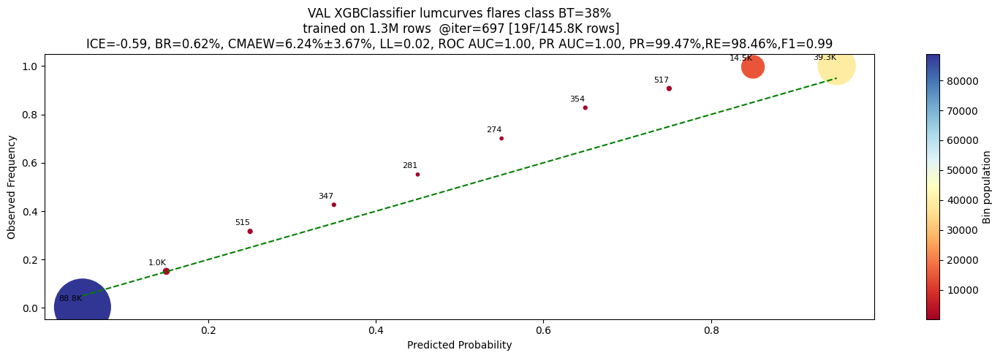

VAL XGBClassifier lumcurves flares class BT=38%
 trained on 1.3M rows  @iter=697
              precision    recall  f1-score   support

           0     0.9906    0.9968    0.9937     90271
           1     0.9947    0.9846    0.9896     55578

    accuracy                         0.9921    145849
   macro avg     0.9926    0.9907    0.9916    145849
weighted avg     0.9921    0.9921    0.9921    145849

ROC AUCs: 1=0.9994
PR AUCs: 1=0.9992
CALIBRATIONs: 
	1: MAEW=6.24%, STD=3.67%, COV=100%
BRIER LOSSes: 
	1=0.6232%
LOG_LOSSes: 
	1=0.0239
ICEs: 
	1=-0.5859
TOTAL INTEGRAL ERROR: -0.5859


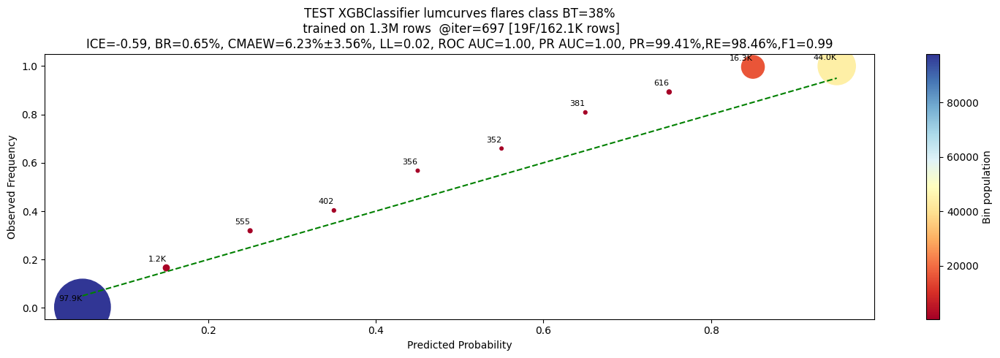

TEST XGBClassifier lumcurves flares class BT=38%
 trained on 1.3M rows  @iter=697
              precision    recall  f1-score   support

           0     0.9904    0.9963    0.9933     99599
           1     0.9941    0.9846    0.9893     62456

    accuracy                         0.9918    162055
   macro avg     0.9922    0.9905    0.9913    162055
weighted avg     0.9918    0.9918    0.9918    162055

ROC AUCs: 1=0.9994
PR AUCs: 1=0.9992
CALIBRATIONs: 
	1: MAEW=6.23%, STD=3.56%, COV=100%
BRIER LOSSes: 
	1=0.6491%
LOG_LOSSes: 
	1=0.0244
ICEs: 
	1=-0.5884
TOTAL INTEGRAL ERROR: -0.5884


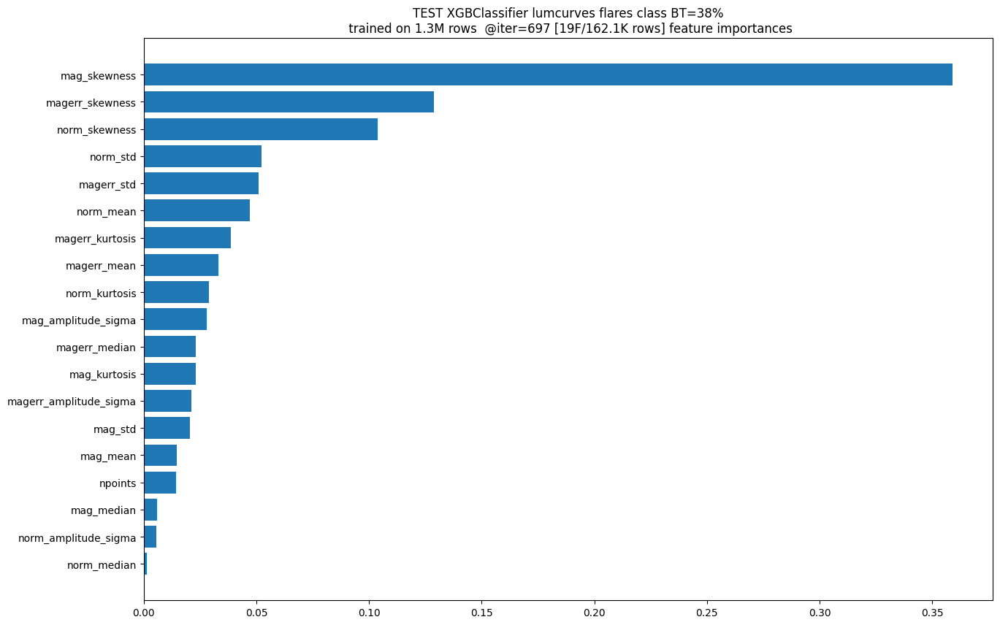

time: 1min 25s (started: 2025-12-17 09:17:58 +03:00)


In [48]:
target_name = "lumcurves"

models, metadata = train_mlframe_models_suite(
    df=features,
    target_name=target_name,
    model_name=f"flares",
    features_and_targets_extractor=ft_extractor,
    mlframe_models="xgb".split(),
    init_common_params={"show_perf_chart": True, "show_fi": True},
    use_ordinary_models=True,
    split_config=TrainingSplitConfig(shuffle_val=True, shuffle_test=True),
    use_mlframe_ensembles=True,
    data_dir="data",
    # models_dir=None,
    verbose=True,
)

# OOS features

In [7]:
def enrich_features(main_features, additional_features):
    combined = pl.concat([main_features, additional_features], how="horizontal")
    fractions = compute_fraction_features(combined)
    main_features = pl.concat(
        [combined, fractions],
        how="horizontal",
    )

    return main_features


freaky_held_out_indices = [
    0,
    3,
    5,
    9,
    12,
    13,
    23,
    36,
    41,
    43,
    47,
    50,
    63,
    75,
    76,
    78,
    87,
] + [64, 66, 95]

time: 15 ms (started: 2025-12-23 10:48:46 +03:00)


In [8]:
oos_df = dataset["test"].to_polars()
oos_features = extract_features_sparingly(dataset["test"])

oos_features

main features: 100%|██████████████████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.76s/batch]


id,class,npoints,mag_mean,mag_std,mag_min,mag_max,mag_median,mag_q25,mag_q75,mag_skewness,mag_kurtosis,mag_entropy,mag_first,mag_last,mag_arg_min,mag_arg_max,mag_n_unique,mag_trend_changes,magerr_mean,magerr_std,magerr_min,magerr_max,magerr_median,magerr_q25,magerr_q75,magerr_skewness,magerr_kurtosis,magerr_entropy,magerr_first,magerr_last,magerr_arg_min,magerr_arg_max,magerr_n_unique,magerr_trend_changes,norm_mean,norm_std,norm_min,norm_max,norm_median,norm_q25,norm_q75,norm_skewness,norm_kurtosis,norm_first,norm_last,norm_arg_min,norm_arg_max,norm_n_unique,norm_trend_changes,mjd_diff_mean,mjd_diff_std,mjd_diff_min,mjd_diff_max,mjd_diff_median,mjd_diff_q25,mjd_diff_q75,mjd_diff_skewness,mjd_diff_kurtosis,mjd_diff_entropy,mjd_diff_first,mjd_diff_last,mjd_diff_arg_min,mjd_diff_arg_max,mjd_diff_n_unique,mjd_diff_trend_changes,ts
str,i32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,"datetime[μs, UTC]"
"""ZTFDR257209100009778""",1,81,18.277956,0.750536,17.015057,20.387354,18.423584,17.687233,18.766064,0.2315,0.250924,4.393619,20.387354,18.864996,21,0,81,26,0.048074,0.031054,0.017062,0.183053,0.045382,0.026185,0.059344,2.5264,8.290339,4.231629,0.183053,0.064138,21,0,81,26,-3.208962,16.538218,-31.037199,43.272083,0.0,-16.225651,7.546613,0.2315,0.250923,43.272083,9.726606,21,0,81,26,0.000879,0.003676,0.0,0.03125,0.0,0.0,0.0,7.244775,56.80888,NaN,0.03125,0.0,2,0,3,28,2018-12-19 00:00:00 UTC
"""ZTFDR260208100017563""",1,80,19.993542,0.696953,17.942547,20.743458,20.307732,19.590908,20.544415,-1.082484,0.312565,4.381419,20.544455,19.909906,49,38,80,47,0.167013,0.05541,0.03964,0.230914,0.19325,0.125968,0.212915,-0.744423,-0.753964,4.319683,0.212918,0.155199,49,38,80,47,-1.625814,3.606474,-12.238963,2.254723,-0.000005,-3.709299,1.224747,-1.082484,0.312565,1.224954,-2.0586,49,38,80,47,0.00089,0.001764,0.0,0.0078125,0.0,0.0,0.0,1.710251,1.912339,NaN,0.0,0.0,0,1,3,41,2019-01-10 00:00:00 UTC
"""ZTFDR280214400089687""",1,96,20.389763,0.501157,18.74905,21.139164,20.576591,20.130533,20.747143,-1.102585,0.645175,4.564046,20.861336,20.375034,58,5,96,65,0.155814,0.036119,0.05539,0.211005,0.16967,0.13486,0.182202,-0.915431,-0.110681,4.534921,0.190592,0.154399,58,5,96,65,-1.101141,2.953708,-10.771131,3.31568,-0.000006,-2.62897,1.005192,-1.102585,0.645175,1.678221,-1.187934,58,5,96,65,0.000658,0.00147,0.0,0.003906,0.0,0.0,0.0,1.772013,1.140032,NaN,0.0,0.003906,0,1,2,45,2018-07-04 00:00:00 UTC
"""ZTFDR281201100016537""",1,83,19.894436,0.774005,18.632027,21.014927,19.637901,19.265348,20.693279,-0.011298,-1.517447,4.418092,20.624474,19.675564,47,24,83,48,0.120904,0.050061,0.050351,0.195758,0.099438,0.077366,0.173587,0.122181,-1.639616,4.332079,0.168845,0.101924,47,24,83,48,2.579839,7.783825,-10.115633,13.848132,0.0,-3.746598,10.613465,-0.011298,-1.517447,9.921517,0.378755,47,24,83,48,0.00081,0.001593,0.0,0.003906,0.0,0.0,0.0,1.443976,0.085068,NaN,0.003906,0.003906,2,0,2,42,2019-06-02 00:00:00 UTC
"""ZTFDR283211100006940""",1,23,19.219332,0.60785,17.624674,19.872463,19.485464,19.005825,19.649889,-1.313293,0.810117,3.135009,19.649891,19.872463,2,22,23,8,0.091238,0.024443,0.037896,0.121601,0.101429,0.077644,0.110213,-0.863388,-0.494011,3.097166,0.110213,0.121601,2,22,23,8,-2.623856,5.992871,-18.345774,3.815475,0.0,-4.728824,1.621086,-1.313293,0.810117,1.621105,3.815475,2,22,23,8,0.002486,0.004437,0.0,0.019531,0.0,0.0,0.003906,2.748001,8.039728,NaN,0.0,0.019531,0,21,4,13,2018-07-13 00:00:00 UTC
…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…
"""ZTFDR807203100058808""",1,45,20.001852,0.514472,18.542976,20.838446,20.126158,19.84725,20.312292,-1.032321,0.737009,3.806336,20.838446,20.312292,2,0,45,24,0.132575,0.040472,0.042632,0.209304,0.138694,0.113256,0.157811,-0.427003

time: 2.23 s (started: 2025-12-23 10:48:47 +03:00)


In [9]:
additional_oos_features = extract_additional_features_sparingly(dataset["test"])
oos_features = enrich_features(oos_features, additional_oos_features)
oos_features

additional features: 100%|████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.23batch/s]


id,class,npoints,mag_mean,mag_std,mag_min,mag_max,mag_median,mag_q25,mag_q75,mag_skewness,mag_kurtosis,mag_entropy,mag_first,mag_last,mag_arg_min,mag_arg_max,mag_n_unique,mag_trend_changes,magerr_mean,magerr_std,magerr_min,magerr_max,magerr_median,magerr_q25,magerr_q75,magerr_skewness,magerr_kurtosis,magerr_entropy,magerr_first,magerr_last,magerr_arg_min,magerr_arg_max,magerr_n_unique,magerr_trend_changes,norm_mean,norm_std,…,norm_q75,norm_skewness,norm_kurtosis,norm_first,norm_last,norm_arg_min,norm_arg_max,norm_n_unique,norm_trend_changes,mjd_diff_mean,mjd_diff_std,mjd_diff_min,mjd_diff_max,mjd_diff_median,mjd_diff_q25,mjd_diff_q75,mjd_diff_skewness,mjd_diff_kurtosis,mjd_diff_entropy,mjd_diff_first,mjd_diff_last,mjd_diff_arg_min,mjd_diff_arg_max,mjd_diff_n_unique,mjd_diff_trend_changes,ts,norm_n_below_3sigma,norm_max_consecutive_below_2sigma,norm_rise_decay_idx_ratio,norm_n_local_minima,norm_n_zero_crossings,norm_rise_decay_time_ratio,mjd_span,norm_frac_below_3sigma,norm_max_consecutive_frac_below_2sigma,norm_frac_local_minima,norm_frac_zero_crossings
str,i32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,…,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,"datetime[μs, UTC]",i32,i32,f32,i32,i32,f32,f32,f64,f64,f64,f64
"""ZTFDR257209100009778""",1,81,18.277956,0.750536,17.015057,20.387354,18.423584,17.687233,18.766064,0.2315,0.250924,4.393619,20.387354,18.864996,21,0,81,26,0.048074,0.031054,0.017062,0.183053,0.045382,0.026185,0.059344,2.5264,8.290339,4.231629,0.183053,0.064138,21,0,81,26,-3.208962,16.538218,…,7.546613,0.2315,0.250923,43.272083,9.726606,21,0,81,26,0.000879,0.003676,0.0,0.03125,0.0,0.0,0.0,7.244775,56.80888,NaN,0.03125,0.0,2,0,3,28,2018-12-19 00:00:00 UTC,36,37,0.366667,13,2,1.660651,0.07169,0.444444,0.45679,0.160494,0.024691
"""ZTFDR260208100017563""",1,80,19.993542,0.696953,17.942547,20.743458,20.307732,19.590908,20.544415,-1.082484,0.312565,4.381419,20.544455,19.909906,49,38,80,47,0.167013,0.05541,0.03964,0.230914,0.19325,0.125968,0.212915,-0.744423,-0.753964,4.319683,0.212918,0.155199,49,38,80,47,-1.625814,3.606474,…,1.224747,-1.082484,0.312565,1.224954,-2.0586,49,38,80,47,0.00089,0.001764,0.0,0.0078125,0.0,0.0,0.0,1.710251,1.912339,NaN,0.0,0.0,0,1,3,41,2019-01-10 00:00:00 UTC,24,30,1.612903,24,11,3.998388,0.070811,0.3,0.375,0.3,0.1375
"""ZTFDR280214400089687""",1,96,20.389763,0.501157,18.74905,21.139164,20.576591,20.130533,20.747143,-1.102585,0.645175,4.564046,20.861336,20.375034,58,5,96,65,0.155814,0.036119,0.05539,0.211005,0.16967,0.13486,0.182202,-0.915431,-0.110681,4.534921,0.190592,0.154399,58,5,96,65,-1.101141,2.953708,…,1.005192,-1.102585,0.645175,1.678221,-1.187934,58,5,96,65,0.000658,0.00147,0.0,0.003906,0.0,0.0,0.0,1.772013,1.140032,NaN,0.0,0.003906,0,1,2,45,2018-07-04 00:00:00 UTC,21,25,1.552632,33,17,2.35714,0.059836,0.21875,0.260417,0.34375,0.177083
"""ZTFDR281201100016537""",1,83,19.894436,0.774005,18.632027,21.014927,19.637901,19.265348,20.693279,-0.011298,-1.517447,4.418092,20.624474,19.675564,47,24,83,48,0.120904,0.050061,0.050351,0.195758,0.099438,0.077366,0.173587,0.122181,-1.639616,4.332079,0.168845,0.101924,47,24,83,48,2.579839,7.783825,…,10.613465,-0.011298,-1.517447,9.921517,0.378755,47,24,83,48,0.00081,0.001593,0.0,0.003906,0.0,0.0,0.0,1.443976,0.085068,NaN,0.003906,0.003906,2,0,2,42,2019-06-02 00:00:00 UTC,24,25,1.333333,24,6,2.811501,0.063659,0.289157,0.301205,0.289157,0.072289
"""ZTFDR283211100006940""",1,23,19.219332,0.60785,17.624674,19.872463,19.485464,19.005825,19.649889,-1.313293,0.810117,3.135009,19.649891,19.872463,2,22,23,8,0.091238,0.024443,0.037896,0.121601,0.101429,0.077644,0.110213,-0.863388,-0.494011,3.097166,0.110213,0.121601,2,22,23,8,-2.623856,5.992871,…,1.621086,-1.313293,0.810117,1.621105,3.815475,2,22,23,8,0.002486,0.004437,0.0,0.019531,0.0,0.0,0.003906,2.748001,8.039728,NaN,0.0,0.019531,0,21,4,13,2018-07-13 00:00:00 UT

time: 1.53 s (started: 2025-12-23 10:48:50 +03:00)


# OOS predictions

In [17]:
xgb_model = models["class"]["binary_classification"][0]

NameError: name 'models' is not defined

time: 110 ms (started: 2025-12-18 04:47:26 +03:00)


In [50]:
probs = xgb_model.model.predict_proba(oos_features.select(xgb_model.columns))
targets = oos_features["class"].to_numpy().astype(np.int8)

time: 31 ms (started: 2025-12-17 09:19:27 +03:00)


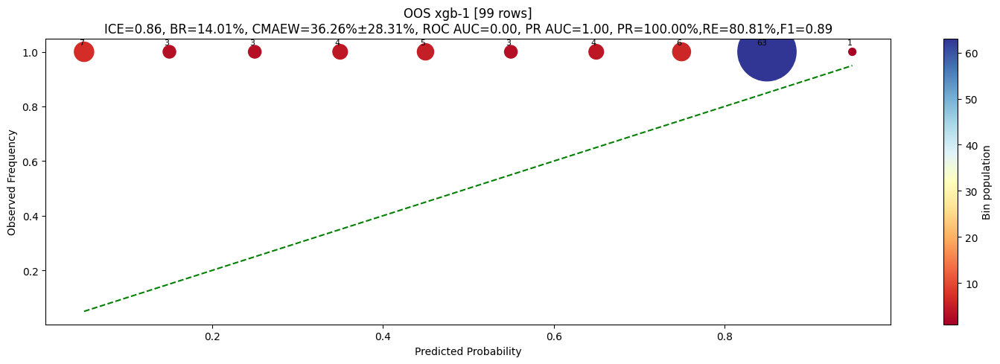

OOS xgb
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       1.00      0.19      0.32        99

    accuracy                           0.19        99
   macro avg       0.50      0.10      0.16        99
weighted avg       1.00      0.19      0.32        99

ROC AUCs: 1=0.00
PR AUCs: 1=1.00
CALIBRATIONs: 
	1: MAEW=36.26%, STD=28.31%, COV=100%
BRIER LOSSes: 
	1=14.01%
LOG_LOSSes: 
	1=None
ICEs: 
	1=0.86
TOTAL INTEGRAL ERROR: 0.0000
time: 1.34 s (started: 2025-12-17 09:19:29 +03:00)


In [51]:
from mlframe.training_old import report_model_perf

show_perf_chart = True
report_title = "OOS"
charts_dir = None

report_params = {
    "report_ndigits": 2,
    "calib_report_ndigits": 2,
    "print_report": True,
    "report_title": report_title,
    "use_weights": True,
    "show_perf_chart": show_perf_chart,
}
model_name = "xgb"
metrics={}

_, _ = report_model_perf(
    targets=targets,
    columns=None,
    df=None,
    model_name=f"{model_name}",
    model=None,
    target_label_encoder=None,
    preds=None,
    probs=probs,
    plot_file=join(charts_dir, model_name) if charts_dir else None,
    metrics=metrics,
    group_ids=None,
    **report_params,
)

In [39]:
features.describe()

statistic,id,class,npoints,mag_std,mag_skewness,mag_kurtosis,mag_amplitude_sigma,mag_mean,mag_median,magerr_std,magerr_skewness,magerr_kurtosis,magerr_amplitude_sigma,magerr_mean,magerr_median,norm_std,norm_skewness,norm_kurtosis,norm_amplitude_sigma,norm_mean,norm_median
str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""count""","""1620543""",1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6
"""null_count""","""0""",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
"""mean""",null,0.382923,44.758756,0.142262,-0.564773,1.206014,0.558589,18.078171,18.093191,0.005657,0.119139,0.406184,0.022365,0.047981,0.047923,3.663053,-0.564773,1.206014,14.113132,-0.563894,5.3462e-9
"""std""",null,0.4861,47.487184,0.109889,1.132896,4.350833,0.420632,1.406553,1.404521,0.006455,0.885913,3.427667,0.02536,0.033665,0.033934,3.957867,1.132896,4.350833,13.177006,1.915574,0.000016
"""min""","""TIC100100909_CADENCE100163_ZTF…",0.0,10.0,0.008981,-18.206665,-1.977966,0.036306,10.68872,10.767665,2.4475e-8,-15.846914,-1.994666,9.4064e-8,0.000447,0.000391,0.817573,-18.206665,-1.977966,2.985329,-97.735992,-0.000096
"""25%""",null,0.0,11.0,0.067806,-1.318035,-0.579074,0.264031,17.288145,17.307205,0.001202,-0.342534,-0.763243,0.004533,0.022346,0.022328,1.964054,-1.318035,-0.579074,7.734026,-0.748645,0.0
"""50%""",null,0.0,16.0,0.112444,-0.434528,0.162725,0.440212,18.27652,18.29213,0.003205,0.11891,-0.206217,0.012547,0.037746,0.037624,2.441091,-0.434528,0.162725,10.288111,-0.237969,0.0
"""75%""",null,1.0,67.0,0.182657,0.202861,1.59486,0.725086,19.084057,19.09478,0.007892,0.571395,0.620411,0.031597,0.064734,0.064321,3.704263,0.202861,1.594859,15.112236,0.142319,0.0
"""max""","""ZTFDR853216400051515_MJD59034.…",1.0,345.0,3.738108,16.393195,331.324619,8.856035,21.913754,22.039047,0.099668,17.944469,326.290299,0.294939,0.287876,0.30216,258.765747,16.393195,331.324619,652.485596,189.502213,0.000098


time: 469 ms (started: 2025-12-17 07:56:24 +03:00)


In [40]:
oos_features.describe()

statistic,id,class,npoints,mag_std,mag_skewness,mag_kurtosis,mag_amplitude_sigma,mag_mean,mag_median,magerr_std,magerr_skewness,magerr_kurtosis,magerr_amplitude_sigma,magerr_mean,magerr_median,norm_std,norm_skewness,norm_kurtosis,norm_amplitude_sigma,norm_mean,norm_median
str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""count""","""99""",99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0
"""null_count""","""0""",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
"""mean""",null,1.0,63.59596,0.681275,-0.923981,0.379142,2.598441,19.914509,20.11677,0.041455,-0.481421,-0.4765,0.145456,0.120306,0.129919,6.260826,-0.923981,0.379142,23.369263,-1.876297,-7.5546e-7
"""std""",null,0.0,34.779457,0.196518,0.641567,2.560359,0.675683,1.006125,1.0197,0.014459,0.654709,1.741596,0.045848,0.037024,0.042043,4.213955,0.641567,2.560359,13.879195,2.153723,0.000006
"""min""","""ZTFDR257209100009778""",1.0,8.0,0.091329,-4.247967,-1.563847,0.232619,14.222792,14.316984,0.000194,-3.423531,-1.904199,0.000494,0.011943,0.011861,2.463627,-4.247967,-1.563847,10.046504,-17.288227,-0.000044
"""25%""",null,1.0,37.0,0.566101,-1.150626,-0.767639,2.222757,19.755405,19.990475,0.03478,-0.796393,-1.104195,0.135038,0.10416,0.110769,4.082587,-1.150626,-0.767639,16.002178,-2.144174,0.0
"""50%""",null,1.0,58.0,0.671219,-0.850493,-0.166944,2.496281,20.106346,20.307732,0.042568,-0.500746,-0.860727,0.153965,0.127027,0.134869,5.085104,-0.850493,-0.166944,19.330418,-1.571215,0.0
"""75%""",null,1.0,83.0,0.800418,-0.557255,0.502038,3.063389,20.466888,20.662922,0.05123,-0.143485,-0.484352,0.173193,0.145089,0.162092,6.908485,-0.557255,0.502038,23.966467,-0.896264,0.0
"""max""","""ZTFDR832210400037888""",1.0,172.0,1.347738,0.2315,16.815604,4.810865,21.168158,21.312328,0.074826,2.5264,11.669255,0.225938,0.195894,0.21678,27.881622,0.2315,16.815604,99.525803,2.579839,0.000019


time: 94 ms (started: 2025-12-17 07:56:49 +03:00)


# Big active ML

In [ ]:
df_target = dataset["target"].select_columns(["id"]).to_polars()
df_target

In [6]:
df_target["id"].n_unique()

94028217

time: 27.3 s (started: 2025-12-18 05:29:21 +03:00)


In [5]:
df_target

id,class,mjd,mag,magerr
str,i32,list[f64],list[f32],list[f32]
"""ZTFDR258214100040640_MJD58487.…",null,"[58487.27209, 58487.28625, … 58487.3306]","[19.939198, 20.136208, … 20.067881]","[19.939198, 20.136208, … 20.067881]"
"""ZTFDR258214100038912_MJD58487.…",null,"[58487.2689, 58487.26935, … 58487.34294]","[17.520168, 17.528702, … 17.47588]","[17.520168, 17.528702, … 17.47588]"
"""ZTFDR258214100040641_MJD58487.…",null,"[58487.26889, 58487.27072, … 58487.33974]","[18.818167, 19.06382, … 18.804058]","[18.818167, 19.06382, … 18.804058]"
"""ZTFDR258214100037040_MJD58487.…",null,"[58487.26887, 58487.26932, … 58487.34199]","[17.047787, 16.582361, … 17.054947]","[17.047787, 16.582361, … 17.054947]"
"""ZTFDR258214100025746_MJD58487.…",null,"[58487.26935, 58487.27301, … 58487.3379]","[19.442375, 20.403635, … 19.316433]","[19.442375, 20.403635, … 19.316433]"
…,…,…,…,…
"""ZTFDR1824206300019435_MJD58226…",null,"[58226.20003, 58226.20093, … 58226.23149]","[17.890526, 17.921936, … 17.938599]","[17.890526, 17.921936, … 17.938599]"
"""ZTFDR1824206300051972_MJD58229…",null,"[58229.19993, 58229.2004, … 58229.25589]","[19.924105, 20.19936, … 20.452414]","[19.924105, 20.19936, … 20.452414]"
"""ZTFDR1824206300032063_MJD58226…",null,"[58226.20044, 58226.2009, … 58226.23145]","[18.181707, 18.381504, … 18.359154]","[18.181707, 18.381504, … 18.359154]"


time: 62 ms (started: 2025-12-17 20:54:03 +03:00)


In [6]:
df_target.shape

(93960271, 5)

time: 62 ms (started: 2025-12-17 20:54:04 +03:00)


# Known flares

In [15]:
for index in freaky_held_out_indices:
    view_series(oos_df, index=index)
# npoints<25

time: 437 ms (started: 2025-12-23 05:44:47 +03:00)


In [10]:
for index in range(100):
    view_series(oos_df, index=index)

OutOfBoundsError: index 99 is out of bounds for sequence of length 99

time: 5.81 s (started: 2025-12-23 04:14:55 +03:00)


In [20]:
view_series(oos_df, index=43)

time: 46 ms (started: 2025-12-19 12:25:09 +03:00)


# Special events

In [ ]:
big_features 283206300181298

In [23]:
dataset["target"][index]

{'id': 'ZTFDR485206400064968_MJD58642.31972',
 'class': None,
 'mjd': [58642.31972,
  58642.32018,
  58642.32108,
  58642.32199,
  58642.32244,
  58642.3229,
  58642.32335,
  58642.32425,
  58642.32516,
  58642.32562,
  58642.32607,
  58642.32652,
  58642.32697,
  58642.32742,
  58642.32832,
  58642.32877,
  58642.32923,
  58642.32968,
  58642.33013,
  58642.33058,
  58642.33103,
  58642.33148,
  58642.33193,
  58642.33239,
  58642.33284,
  58642.33329,
  58642.33374,
  58642.33419,
  58642.33464,
  58642.33509,
  58642.33555,
  58642.336,
  58642.33645,
  58642.3369,
  58642.33735,
  58642.3378,
  58642.33825,
  58642.33871,
  58642.33961,
  58642.34006,
  58642.34051,
  58642.34141,
  58642.34187,
  58642.34232,
  58642.34277,
  58642.34368,
  58642.34413,
  58642.34459,
  58642.34594,
  58642.34639,
  58642.34684,
  58642.34728,
  58642.34775,
  58642.3482,
  58642.34865,
  58642.3491,
  58642.34955,
  58642.35,
  58642.35044,
  58642.35089,
  58642.35134,
  58642.3518,
  58642.3522

time: 15 ms (started: 2025-12-22 12:42:39 +03:00)


In [22]:
mjd = dataset["target"][index]["mjd"]
(mjd == sorted(mjd))

True

time: 16 ms (started: 2025-12-22 12:41:22 +03:00)


In [17]:
index = 40122309
view_series(dataset["target"][index], index=index, advanced=True)

time: 63 ms (started: 2025-12-22 12:39:00 +03:00)


In [8]:
index = 5555427
view_series(dataset["target"][index], index=index, advanced=True)

time: 704 ms (started: 2025-12-22 07:35:47 +03:00)


In [75]:
index = 55554273
view_series(dataset["target"][index], index=index, advanced=True)

time: 78 ms (started: 2025-12-20 05:30:25 +03:00)


In [78]:
view_series(oos_df, index=1, advanced=True)

time: 78 ms (started: 2025-12-20 05:32:41 +03:00)


In [38]:
index = 89001830
view_series(dataset["target"][index], index=index, singlepoint_min_outlying_factor=10)

time: 78 ms (started: 2025-12-21 17:44:49 +03:00)


In [36]:
for index in (
    big_features.lazy()
    .with_row_index()
    .filter(pl.col("norm_skewness") > -18)
    .sort("norm_skewness")
    .head(5)
    .select("index")
    .collect()["index"]
):
    view_series(
        dataset["target"][index], index=index, singlepoint_min_outlying_factor=10
    )

time: 4.22 s (started: 2025-12-21 17:39:06 +03:00)


In [19]:
clean_ram()

time: 22.9 s (started: 2025-12-21 12:07:16 +03:00)


In [86]:
with pl.Config(tbl_rows=30):
    display(ranked_features.sort("median_log_ratio").head(20))

feature,mean_pop,mean_rare,mean_ratio,mean_log_ratio,median_pop,median_rare,median_ratio,median_log_ratio,std_pop,std_rare,std_ratio,std_log_ratio,cohens_d_mean,cohens_d_median,max_abs_log_ratio
str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""mjd_diff_kurtosis""",NaN,18.558035,NaN,NaN,-0.0303,11.72448,-386.946514,-8.59599,NaN,21.757736,NaN,NaN,NaN,NaN,NaN
"""norm_mean""",0.04773,-1.876297,-39.310323,-5.296836,0.024088,-1.571215,-65.227167,-6.027401,0.887163,2.153723,2.427654,1.279563,-2.168738,-1.798204,6.027401
"""norm_first""",-0.100936,2.363058,-23.411399,-4.549139,-0.051602,1.807318,-35.024231,-5.130281,3.990919,7.588773,1.90151,0.927146,0.617399,0.465787,5.130281
"""mag_skewness""",-0.008388,-0.923981,110.160379,6.783462,0.043938,-0.850493,-19.356703,-4.274761,0.938634,0.641567,0.683511,-0.548963,-0.975453,-0.952907,6.783462
"""norm_skewness""",-0.008388,-0.923981,110.160379,6.783462,0.043938,-0.850493,-19.356696,-4.274761,0.938634,0.641567,0.683511,-0.548963,-0.975453,-0.952907,6.783462
"""norm_last""",-0.139838,1.060816,-7.58604,-2.923347,-0.079021,1.031867,-13.058116,-3.706875,3.940786,4.144145,1.051604,0.072591,0.304674,0.281895,3.706875
"""mjd_diff_median""",0.00253,0.002392,0.945292,-0.081169,0.003906,0.000463,0.118531,-3.076669,0.002954,0.007067,2.392675,1.258625,-0.046864,-1.165763,3.076669
"""mjd_diff_q75""",0.004979,0.031516,6.330305,2.662275,0.003906,0.000937,0.239997,-2.058909,0.004191,0.165195,39.416425,5.300725,6.326891,-0.707789,5.300725
"""magerr_skewness""",0.207738,-0.481421,-2.317443,-1.212534,0.21778,-0.500746,-2.299321,-1.201208,0.944219,0.654709,0.693387,-0.528268,-0.729872,-0.760974,1.212534


time: 63 ms (started: 2025-12-20 06:06:56 +03:00)


# Random events

In [37]:
for i in range(10):
    index = np.random.randint(len(big_features))
    view_series(dataset["target"][index], index=index)

time: 391 ms (started: 2025-12-19 13:34:13 +03:00)


# Big features

In [10]:
big_features = pl.read_parquet(
    r"R:\Data\Astronomy\big_features.parquet", parallel="columns"
)

_init_credential_provider_builder(): credential_provider_init = None


time: 26.8 s (started: 2025-12-23 10:49:21 +03:00)


In [11]:
additional_features = pl.read_parquet(
    r"R:\Data\Astronomy\features_additional.parquet", parallel="columns"
)

_init_credential_provider_builder(): credential_provider_init = None


time: 2.3 s (started: 2025-12-23 10:49:49 +03:00)


In [12]:
big_features = enrich_features(big_features, additional_features)
clean_ram()

time: 29.1 s (started: 2025-12-23 10:49:52 +03:00)


In [13]:
big_features

id,class,npoints,mag_mean,mag_std,mag_min,mag_max,mag_median,mag_q25,mag_q75,mag_skewness,mag_kurtosis,mag_entropy,mag_first,mag_last,mag_arg_min,mag_arg_max,mag_n_unique,mag_trend_changes,magerr_mean,magerr_std,magerr_min,magerr_max,magerr_median,magerr_q25,magerr_q75,magerr_skewness,magerr_kurtosis,magerr_entropy,magerr_first,magerr_last,magerr_arg_min,magerr_arg_max,magerr_n_unique,magerr_trend_changes,norm_mean,norm_std,…,norm_q75,norm_skewness,norm_kurtosis,norm_first,norm_last,norm_arg_min,norm_arg_max,norm_n_unique,norm_trend_changes,mjd_diff_mean,mjd_diff_std,mjd_diff_min,mjd_diff_max,mjd_diff_median,mjd_diff_q25,mjd_diff_q75,mjd_diff_skewness,mjd_diff_kurtosis,mjd_diff_entropy,mjd_diff_first,mjd_diff_last,mjd_diff_arg_min,mjd_diff_arg_max,mjd_diff_n_unique,mjd_diff_trend_changes,ts,norm_n_below_3sigma,norm_max_consecutive_below_2sigma,norm_rise_decay_idx_ratio,norm_n_local_minima,norm_n_zero_crossings,norm_rise_decay_time_ratio,mjd_span,norm_frac_below_3sigma,norm_max_consecutive_frac_below_2sigma,norm_frac_local_minima,norm_frac_zero_crossings
str,i32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,…,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,"datetime[μs, UTC]",i32,i32,f32,i32,i32,f32,f32,f64,f64,f64,f64
"""ZTFDR257201100001119_MJD58471.…",null,174,18.913832,0.135884,18.501698,19.387657,18.921986,18.840481,18.985106,-0.112987,1.3233,5.15903,18.605858,19.062325,76,31,174,116,0.075098,0.007802,0.054352,0.106575,0.075198,0.07063,0.07892,0.364245,1.68334,5.153715,0.058914,0.083698,76,31,174,116,-0.1084,1.807023,…,0.839384,-0.112987,1.3233,-4.203945,1.866261,76,31,174,116,0.000497,0.001305,0.0,0.003906,0.0,0.0,0.0,2.238154,3.009332,NaN,0.0,0.0,0,4,2,66,2018-12-19 00:00:00 UTC,9,3,0.785714,58,75,0.825431,0.08585,0.051724,0.017241,0.333333,0.431034
"""ZTFDR257201100031205_MJD58471.…",null,188,18.212538,0.109453,17.842152,18.584852,18.216366,18.15344,18.284317,-0.24003,0.994606,5.236424,18.096306,18.348726,77,138,188,114,0.043691,0.003615,0.033012,0.057963,0.043653,0.041616,0.045977,0.176193,1.273714,5.233038,0.039858,0.048305,77,138,188,114,-0.08771,2.507348,…,1.556625,-0.24003,0.994606,-2.750331,3.03211,77,138,188,114,0.00046,0.001262,0.0,0.003906,0.0,0.0,0.0,2.373464,3.633333,NaN,0.0,0.0,0,5,2,66,2018-12-19 00:00:00 UTC,25,8,0.702703,57,51,0.693628,0.08585,0.132979,0.042553,0.303191,0.271277
"""ZTFDR257201100048647_MJD58472.…",null,129,19.074141,0.154115,18.715588,19.509781,19.063267,18.969311,19.167679,0.39769,0.219762,4.85978,19.011953,19.295404,26,6,129,86,0.084942,0.010087,0.064136,0.116274,0.083758,0.077974,0.09062,0.702977,0.6787,4.852957,0.080553,0.099639,26,6,129,86,0.129762,1.840007,…,1.246591,0.39769,0.219762,-0.612638,2.771526,26,6,129,86,0.000671,0.00148,0.0,0.003906,0.0,0.0,0.0,1.739462,1.025729,NaN,0.0,0.0,0,1,2,65,2018-12-20 00:00:00 UTC,3,4,0.262136,43,53,0.293119,0.08457,0.023256,0.031008,0.333333,0.410853
"""ZTFDR257201100051826_MJD58472.…",null,19,19.37347,0.272342,18.896191,19.884975,19.37619,19.112148,19.570467,0.124072,-0.824714,2.944345,19.077137,19.579378,6,13,19,10,0.106831,0.020874,0.073723,0.148942,0.105694,0.086914,0.121298,0.346468,-0.714802,2.926517,0.084643,0.122046,6,13,19,10,-0.025736,2.5767,…,1.838107,0.124072,-0.824714,-2.829426,1.922418,6,13,19,10,0.00434,0.004993,0.0,0.015625,0.003906,0.0,0.003906,1.353805,0.759936,NaN,0.003906,0.0,1,2,4,16,2018-12-20 00:00:00 UTC,1,3,0.538462,5,7,0.94341,0.07727,0.052632,0.157895,0.263158,0.368421
"""ZTFDR257201100011565_MJD58471.…",null,48,19.7246,0.22452,19.075207,20.159521,19.771763,19.631021,19.851671,-0.834665,0.633071,3.871137,19.602474,19.935028,16,24,48,32,0.135178,0.018889,0.08452,0.173324,0.138759,0.126432,0.145932,-0.649473,0.241762,3.861241,0.123997,0.153471,16,24,48,32,-0.339897,1.618055,…,0.575877,-0.834665,0.633071,-1.220015,1.176606,16,24,48,32,0.001745,0.002276,0.0,0.0078125,0.0,0.0,0.00

time: 78 ms (started: 2025-12-23 10:50:22 +03:00)


## Computing additional features

In [7]:
additional_features = extract_additional_features_sparingly(
    dataset["target"].select(range(5000000))
)
additional_features

_init_credential_provider_builder(): credential_provider_init = None
2025-12-20 10:04:59,760 - INFO - extract_additional_features_sparingly-line:910 - [additional] Cache invalid (500000 vs 5000000), recomputing...
2025-12-20 10:04:59,766 - INFO - extract_additional_features_sparingly-line:912 - [additional] Computing flare-specific features...
_init_credential_provider_builder(): credential_provider_init = None
2025-12-20 10:06:54,696 - INFO - extract_additional_features_sparingly-line:1047 -     Saved to data\features_additional.parquet


norm_n_below_3sigma,norm_max_consecutive_below_2sigma,norm_rise_decay_idx_ratio,norm_rise_decay_time_ratio,mjd_span,norm_n_local_minima,norm_n_zero_crossings
i32,i32,f32,f32,f32,i32,i32
9,3,0.785714,0.825431,0.08585,58,75
25,8,0.702703,0.693628,0.08585,57,51
3,4,0.262136,0.293119,0.08457,43,53
1,3,0.538462,0.94341,0.07727,5,7
3,5,0.53125,0.74533,0.08128,16,21
…,…,…,…,…,…,…
3,1,6.0,4.996633,0.03562,12,20
5,2,5.666667,12.53398,0.05576,5,9
9,3,1.875,1.953378,0.03104,6,9


time: 2min 2s (started: 2025-12-20 10:04:59 +03:00)


In [ ]:
additional_features = extract_additional_features_sparingly(dataset["target"])
additional_features

## Computing big features

In [8]:
test_features = extract_features_sparingly(
    dataset["target"].select(range(5000)), engine="streaming"
)
test_features

2025-12-18 13:38:00,368 - INFO - load_or_compute-line:441 - [1/6] Computing mag features...
_init_credential_provider_builder(): credential_provider_init = None
2025-12-18 13:38:01,260 - INFO - load_or_compute-line:446 -     Saved to data\features_mag.parquet
2025-12-18 13:38:01,931 - INFO - load_or_compute-line:441 - [2/6] Computing magerr features...
_init_credential_provider_builder(): credential_provider_init = None
2025-12-18 13:38:02,815 - INFO - load_or_compute-line:446 -     Saved to data\features_magerr.parquet
2025-12-18 13:38:03,467 - INFO - load_or_compute-line:441 - [3/6] Computing norm features...
_init_credential_provider_builder(): credential_provider_init = None
2025-12-18 13:38:04,328 - INFO - load_or_compute-line:446 -     Saved to data\features_norm.parquet
2025-12-18 13:38:05,034 - INFO - load_or_compute-line:441 - [4/6] Computing mjd_diff features...
_init_credential_provider_builder(): credential_provider_init = None
2025-12-18 13:38:06,018 - INFO - load_or_compu

id,class,npoints,mag_mean,mag_std,mag_min,mag_max,mag_median,mag_q25,mag_q75,mag_skewness,mag_kurtosis,mag_entropy,mag_first,mag_last,mag_arg_min,mag_arg_max,mag_n_unique,mag_trend_changes,magerr_mean,magerr_std,magerr_min,magerr_max,magerr_median,magerr_q25,magerr_q75,magerr_skewness,magerr_kurtosis,magerr_entropy,magerr_first,magerr_last,magerr_arg_min,magerr_arg_max,magerr_n_unique,magerr_trend_changes,norm_mean,norm_std,norm_min,norm_max,norm_median,norm_q25,norm_q75,norm_skewness,norm_kurtosis,norm_first,norm_last,norm_arg_min,norm_arg_max,norm_n_unique,norm_trend_changes,mjd_diff_mean,mjd_diff_std,mjd_diff_min,mjd_diff_max,mjd_diff_median,mjd_diff_q25,mjd_diff_q75,mjd_diff_skewness,mjd_diff_kurtosis,mjd_diff_entropy,mjd_diff_first,mjd_diff_last,mjd_diff_arg_min,mjd_diff_arg_max,mjd_diff_n_unique,mjd_diff_trend_changes,ts
str,i32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,"datetime[μs, UTC]"
"""ZTFDR257201100001119_MJD58471.…",null,174,18.913832,0.135884,18.501698,19.387657,18.921986,18.840481,18.985106,-0.112987,1.3233,5.15903,18.605858,19.062325,76,31,174,116,0.075098,0.007802,0.054352,0.106575,0.075198,0.07063,0.07892,0.364245,1.68334,5.153715,0.058914,0.083698,76,31,174,116,-0.1084,1.807023,-5.589094,6.192615,0.0,-1.083871,0.839384,-0.112987,1.3233,-4.203945,1.866261,76,31,174,116,0.000496,0.000139,0.00045,0.00138,0.00046,0.00045,0.00046,3.5539,12.874785,5.122674,0.00045,0.00045,0,70,13,152,2018-12-19 00:00:00 UTC
"""ZTFDR257201100031205_MJD58471.…",null,188,18.212538,0.109453,17.842152,18.584852,18.216366,18.15344,18.284317,-0.24003,0.994606,5.236424,18.096306,18.348726,77,138,188,114,0.043691,0.003615,0.033012,0.057963,0.043653,0.041616,0.045977,0.176193,1.273714,5.233038,0.039858,0.048305,77,138,188,114,-0.08771,2.507348,-8.572489,8.441278,0.0,-1.441492,1.556625,-0.24003,0.994606,-2.750331,3.03211,77,138,188,114,0.000459,0.000033,0.00045,0.0009,0.00046,0.00045,0.00046,12.628547,165.25676,5.229053,0.00045,0.00046,0,176,7,166,2018-12-19 00:00:00 UTC
"""ZTFDR257201100048647_MJD58472.…",null,129,19.074141,0.154115,18.715588,19.509781,19.063267,18.969311,19.167679,0.39769,0.219762,4.85978,19.011953,19.295404,26,6,129,86,0.084942,0.010087,0.064136,0.116274,0.083758,0.077974,0.09062,0.702977,0.6787,4.852957,0.080553,0.099639,26,6,129,86,0.129762,1.840007,-4.150992,5.330997,0.0,-1.121754,1.246591,0.39769,0.219762,-0.612638,2.771526,26,6,129,86,0.000661,0.000383,0.00045,0.00228,0.00046,0.00045,0.00091,2.125184,4.139797,4.720881,0.00091,0.00045,5,52,19,95,2018-12-20 00:00:00 UTC
"""ZTFDR257201100051826_MJD58472.…",null,19,19.37347,0.272342,18.896191,19.884975,19.37619,19.112148,19.570467,0.124072,-0.824714,2.944345,19.077137,19.579378,6,13,19,10,0.106831,0.020874,0.073723,0.148942,0.105694,0.086914,0.121298,0.346468,-0.714802,2.926517,0.084643,0.122046,6,13,19,10,-0.025736,2.5767,-4.541409,4.813759,0.0,-2.498174,1.838107,0.124072,-0.824714,-2.829426,1.922418,6,13,19,10,0.004293,0.004313,0.00046,0.01508,0.002745,0.00137,0.00502,1.540015,1.349784,2.488526,0.00274,0.00046,17,8,18,10,2018-12-20 00:00:00 UTC
"""ZTFDR257201100011565_MJD58471.…",null,48,19.7246,0.22452,19.075207,20.159521,19.771763,19.631021,19.851671,-0.834665,0.633071,3.871137,19.602474,19.935028,16,24,48,32,0.135178,0.018889,0.08452,0.173324,0.138759,0.126432,0.145932,-0.649473,0.241762,3.861241,0.123997,0.153471,16,24,48,32,-0.339897,1.618055,-5.019882,2.794463,0.000007,-1.014283,0.575877,-0.834665,0.633071,-1.220015,1.176606,16,24,48,32,0.001729,0.001576,0.00045,0.00731,0.00136,0.00046,0.00229,1.621449,2.446616,3.508264,0.00548,0.00046,5,13,23,28,2018-12-19 00:00:00 UTC
…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…
"""ZTFDR257201400028131_MJD58472.…",null,115,17.72

time: 7.94 s (started: 2025-12-18 13:38:00 +03:00)


In [7]:
clean_ram()

time: 1.03 s (started: 2025-12-18 22:16:11 +03:00)


In [ ]:
big_features = extract_features_sparingly(dataset["target"], engine="cpu")
big_features

2025-12-18 13:43:48,284 - INFO - load_or_compute-line:441 - [1/6] Computing mag features...
_init_credential_provider_builder(): credential_provider_init = None
2025-12-18 14:57:29,283 - INFO - load_or_compute-line:446 -     Saved to data\features_mag.parquet
2025-12-18 14:57:50,734 - INFO - load_or_compute-line:441 - [2/6] Computing magerr features...


In [6]:
big_features = extract_features_sparingly(dataset["target"], engine="cpu")
big_features

2025-12-18 23:11:45,377 - INFO - extract_features_sparingly-line:584 - Low RAM mode: 127.9GB < 512GB threshold
2025-12-18 23:11:45,381 - INFO - extract_features_sparingly-line:723 - Pass 1: Computing and caching all features...
_init_credential_provider_builder(): credential_provider_init = None
2025-12-18 23:11:45,778 - INFO - compute_and_save-line:604 - [mag] mag features already cached, skipping...
_init_credential_provider_builder(): credential_provider_init = None
2025-12-18 23:11:46,103 - INFO - compute_and_save-line:604 - [magerr] magerr features already cached, skipping...
2025-12-18 23:11:46,111 - INFO - compute_and_save-line:607 - [norm] Computing norm features...
_init_credential_provider_builder(): credential_provider_init = None
2025-12-19 00:00:04,627 - INFO - compute_and_save-line:610 -     Saved to data\features_norm.parquet
2025-12-19 00:00:06,888 - INFO - compute_and_save-line:607 - [mjd_diff] Computing mjd_diff features...
_init_credential_provider_builder(): credent

id,class,npoints,mag_mean,mag_std,mag_min,mag_max,mag_median,mag_q25,mag_q75,mag_skewness,mag_kurtosis,mag_entropy,mag_first,mag_last,mag_arg_min,mag_arg_max,mag_n_unique,mag_trend_changes,magerr_mean,magerr_std,magerr_min,magerr_max,magerr_median,magerr_q25,magerr_q75,magerr_skewness,magerr_kurtosis,magerr_entropy,magerr_first,magerr_last,magerr_arg_min,magerr_arg_max,magerr_n_unique,magerr_trend_changes,norm_mean,norm_std,norm_min,norm_max,norm_median,norm_q25,norm_q75,norm_skewness,norm_kurtosis,norm_first,norm_last,norm_arg_min,norm_arg_max,norm_n_unique,norm_trend_changes,mjd_diff_mean,mjd_diff_std,mjd_diff_min,mjd_diff_max,mjd_diff_median,mjd_diff_q25,mjd_diff_q75,mjd_diff_skewness,mjd_diff_kurtosis,mjd_diff_entropy,mjd_diff_first,mjd_diff_last,mjd_diff_arg_min,mjd_diff_arg_max,mjd_diff_n_unique,mjd_diff_trend_changes,ts
str,i32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,"datetime[μs, UTC]"
"""ZTFDR257201100001119_MJD58471.…",null,174,18.913832,0.135884,18.501698,19.387657,18.921986,18.840481,18.985106,-0.112987,1.3233,5.15903,18.605858,19.062325,76,31,174,116,0.075098,0.007802,0.054352,0.106575,0.075198,0.07063,0.07892,0.364245,1.68334,5.153715,0.058914,0.083698,76,31,174,116,-0.1084,1.807023,-5.589094,6.192615,0.0,-1.083871,0.839384,-0.112987,1.3233,-4.203945,1.866261,76,31,174,116,0.000497,0.001305,0.0,0.003906,0.0,0.0,0.0,2.238154,3.009332,NaN,0.0,0.0,0,4,2,66,2018-12-19 00:00:00 UTC
"""ZTFDR257201100031205_MJD58471.…",null,188,18.212538,0.109453,17.842152,18.584852,18.216366,18.15344,18.284317,-0.24003,0.994606,5.236424,18.096306,18.348726,77,138,188,114,0.043691,0.003615,0.033012,0.057963,0.043653,0.041616,0.045977,0.176193,1.273714,5.233038,0.039858,0.048305,77,138,188,114,-0.08771,2.507348,-8.572489,8.441278,0.0,-1.441492,1.556625,-0.24003,0.994606,-2.750331,3.03211,77,138,188,114,0.00046,0.001262,0.0,0.003906,0.0,0.0,0.0,2.373464,3.633333,NaN,0.0,0.0,0,5,2,66,2018-12-19 00:00:00 UTC
"""ZTFDR257201100048647_MJD58472.…",null,129,19.074141,0.154115,18.715588,19.509781,19.063267,18.969311,19.167679,0.39769,0.219762,4.85978,19.011953,19.295404,26,6,129,86,0.084942,0.010087,0.064136,0.116274,0.083758,0.077974,0.09062,0.702977,0.6787,4.852957,0.080553,0.099639,26,6,129,86,0.129762,1.840007,-4.150992,5.330997,0.0,-1.121754,1.246591,0.39769,0.219762,-0.612638,2.771526,26,6,129,86,0.000671,0.00148,0.0,0.003906,0.0,0.0,0.0,1.739462,1.025729,NaN,0.0,0.0,0,1,2,65,2018-12-20 00:00:00 UTC
"""ZTFDR257201100051826_MJD58472.…",null,19,19.37347,0.272342,18.896191,19.884975,19.37619,19.112148,19.570467,0.124072,-0.824714,2.944345,19.077137,19.579378,6,13,19,10,0.106831,0.020874,0.073723,0.148942,0.105694,0.086914,0.121298,0.346468,-0.714802,2.926517,0.084643,0.122046,6,13,19,10,-0.025736,2.5767,-4.541409,4.813759,0.0,-2.498174,1.838107,0.124072,-0.824714,-2.829426,1.922418,6,13,19,10,0.00434,0.004993,0.0,0.015625,0.003906,0.0,0.003906,1.353805,0.759936,NaN,0.003906,0.0,1,2,4,16,2018-12-20 00:00:00 UTC
"""ZTFDR257201100011565_MJD58471.…",null,48,19.7246,0.22452,19.075207,20.159521,19.771763,19.631021,19.851671,-0.834665,0.633071,3.871137,19.602474,19.935028,16,24,48,32,0.135178,0.018889,0.08452,0.173324,0.138759,0.126432,0.145932,-0.649473,0.241762,3.861241,0.123997,0.153471,16,24,48,32,-0.339897,1.618055,-5.019882,2.794463,0.000007,-1.014283,0.575877,-0.834665,0.633071,-1.220015,1.176606,16,24,48,32,0.001745,0.002276,0.0,0.0078125,0.0,0.0,0.003906,0.874692,-0.235138,NaN,0.003906,0.0,3,13,3,38,2018-12-19 00:00:00 UTC
…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…
"""ZTFDR1824216400046147_MJD58229…",null,26,19.558136,0.315779,18.933319,20.113304,19.600155,19.377138,19.767147,-0.305537,-0.725756,3.257971,19.4076,19.159927,5,22,26,16,0.10060

time: 2h 44min 56s (started: 2025-12-18 23:11:45 +03:00)


In [ ]:
big_features.write_parquet("big_features.parquet", compression="zstd")

# Ranking individual features

In [20]:
ranked_features = rank_discriminative_features(big_features, oos_features)
ranked_features

feature,mean_pop,mean_rare,mean_ratio,mean_log_ratio,median_pop,median_rare,median_ratio,median_log_ratio,std_pop,std_rare,std_ratio,std_log_ratio,cohens_d_mean,cohens_d_median,max_abs_log_ratio
str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""mjd_diff_skewness""",NaN,2.234664,NaN,NaN,1.106932,1.98089,1.789532,0.839582,NaN,1.377353,NaN,NaN,NaN,NaN,NaN
"""mjd_diff_kurtosis""",NaN,6.737611,NaN,NaN,-0.0303,2.653846,-87.585683,-6.452623,NaN,11.620858,NaN,NaN,NaN,NaN,NaN
"""mjd_diff_entropy""",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
"""mjd_diff_q25""",0.000991,0.000868,0.875503,-0.191816,0.0,0.0,0.0,33.219281,0.002458,0.003766,1.532141,0.615549,-0.050213,0.0,33.219281
"""mjd_diff_median""",0.00253,0.001993,0.787545,-0.344565,0.003906,0.0,0.0,33.219281,0.002954,0.007329,2.481386,1.311146,-0.181991,-1.322522,33.219281
…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…
"""mag_min""",18.071562,18.217197,1.008059,0.01158,18.315479,18.424438,1.005949,0.008557,1.245731,1.024751,0.82261,-0.28172,0.116908,0.087466,0.28172
"""mag_last""",18.350201,20.246765,1.103354,0.141896,18.57716,20.375034,1.096779,0.133273,1.363788,1.135964,0.832947,-0.263703,1.390659,1.318295,0.263703
"""norm_frac_local_minima""",0.293533,0.259264,0.883254,-0.179099,0.300885,0.268293,0.891679,-0.165404,0.057314,0.050514,0.881348,-0.182217,-0.597908,-0.568658,0.182217


time: 30.8 s (started: 2025-12-23 05:57:38 +03:00)


In [21]:
ranked_features.sort("median_log_ratio").head(10)

feature,mean_pop,mean_rare,mean_ratio,mean_log_ratio,median_pop,median_rare,median_ratio,median_log_ratio,std_pop,std_rare,std_ratio,std_log_ratio,cohens_d_mean,cohens_d_median,max_abs_log_ratio
str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""mjd_diff_kurtosis""",NaN,6.737611,NaN,NaN,-0.0303,2.653846,-87.585683,-6.452623,NaN,11.620858,NaN,NaN,NaN,NaN,NaN
"""norm_mean""",0.04773,-1.876297,-39.310323,-5.296836,0.024088,-1.571215,-65.227167,-6.027401,0.887163,2.153723,2.427654,1.279563,-2.168738,-1.798204,6.027401
"""norm_first""",-0.100936,2.363058,-23.411399,-4.549139,-0.051602,1.807318,-35.024231,-5.130281,3.990919,7.588773,1.90151,0.927146,0.617399,0.465787,5.130281
"""mag_skewness""",-0.008388,-0.923981,110.160379,6.783462,0.043938,-0.850493,-19.356703,-4.274761,0.938634,0.641567,0.683511,-0.548963,-0.975453,-0.952907,6.783462
"""norm_skewness""",-0.008388,-0.923981,110.160379,6.783462,0.043938,-0.850493,-19.356696,-4.274761,0.938634,0.641567,0.683511,-0.548963,-0.975453,-0.952907,6.783462
"""norm_last""",-0.139838,1.060816,-7.58604,-2.923347,-0.079021,1.031867,-13.058116,-3.706875,3.940786,4.144145,1.051604,0.072591,0.304674,0.281895,3.706875
"""norm_frac_zero_crossings""",0.438184,0.139878,0.319222,-1.647368,0.45,0.121951,0.271003,-1.883621,0.125959,0.094094,0.747021,-0.420779,-2.368285,-2.604417,1.883621
"""norm_rise_decay_idx_ratio""",4.269934,0.755413,0.176914,-2.498877,1.045455,0.409091,0.391304,-1.353637,10.799565,0.766283,0.070955,-3.816952,-0.325432,-0.058925,3.816952
"""magerr_skewness""",0.207738,-0.481421,-2.317443,-1.212534,0.21778,-0.500746,-2.299321,-1.201208,0.944219,0.654709,0.693387,-0.528268,-0.729872,-0.760974,1.212534


time: 47 ms (started: 2025-12-23 05:58:29 +03:00)


In [68]:
ranked_features.sort("median_log_ratio").head(10)

feature,mean_pop,mean_rare,mean_ratio,mean_log_ratio,median_pop,median_rare,median_ratio,median_log_ratio,std_pop,std_rare,std_ratio,std_log_ratio,cohens_d_mean,cohens_d_median,max_abs_log_ratio
str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""mjd_diff_kurtosis""",NaN,18.558035,NaN,NaN,-0.0303,11.72448,-386.946514,-8.59599,NaN,21.757736,NaN,NaN,NaN,NaN,NaN
"""norm_mean""",0.04773,-1.876297,-39.310323,-5.296836,0.024088,-1.571215,-65.227167,-6.027401,0.887163,2.153723,2.427654,1.279563,-2.168738,-1.798204,6.027401
"""norm_first""",-0.100936,2.363058,-23.411399,-4.549139,-0.051602,1.807318,-35.024231,-5.130281,3.990919,7.588773,1.90151,0.927146,0.617399,0.465787,5.130281
"""mag_skewness""",-0.008388,-0.923981,110.160379,6.783462,0.043938,-0.850493,-19.356703,-4.274761,0.938634,0.641567,0.683511,-0.548963,-0.975453,-0.952907,6.783462
"""norm_skewness""",-0.008388,-0.923981,110.160379,6.783462,0.043938,-0.850493,-19.356696,-4.274761,0.938634,0.641567,0.683511,-0.548963,-0.975453,-0.952907,6.783462
"""norm_last""",-0.139838,1.060816,-7.58604,-2.923347,-0.079021,1.031867,-13.058116,-3.706875,3.940786,4.144145,1.051604,0.072591,0.304674,0.281895,3.706875
"""mjd_diff_median""",0.00253,0.002392,0.945292,-0.081169,0.003906,0.000463,0.118531,-3.076669,0.002954,0.007067,2.392675,1.258625,-0.046864,-1.165763,3.076669
"""mjd_diff_q75""",0.004979,0.031516,6.330305,2.662275,0.003906,0.000937,0.239997,-2.058909,0.004191,0.165195,39.416425,5.300725,6.326891,-0.707789,5.300725
"""magerr_skewness""",0.207738,-0.481421,-2.317443,-1.212534,0.21778,-0.500746,-2.299321,-1.201208,0.944219,0.654709,0.693387,-0.528268,-0.729872,-0.760974,1.212534


time: 47 ms (started: 2025-12-20 03:50:11 +03:00)


In [69]:
ranked_features.sort("cohens_d_mean").head(10)

feature,mean_pop,mean_rare,mean_ratio,mean_log_ratio,median_pop,median_rare,median_ratio,median_log_ratio,std_pop,std_rare,std_ratio,std_log_ratio,cohens_d_mean,cohens_d_median,max_abs_log_ratio
str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""norm_min""",-5.5652,-17.275366,3.104177,1.634211,-4.512806,-13.972876,3.096272,1.630532,4.305041,11.15953,2.592201,1.374177,-2.720098,-2.197434,1.634211
"""norm_q25""",-1.634339,-5.187131,3.173841,1.66623,-1.301363,-4.253629,3.268595,1.708671,1.473621,4.29655,2.915641,1.543813,-2.410917,-2.003401,1.708671
"""norm_mean""",0.04773,-1.876297,-39.310323,-5.296836,0.024088,-1.571215,-65.227167,-6.027401,0.887163,2.153723,2.427654,1.279563,-2.168738,-1.798204,6.027401
"""mag_skewness""",-0.008388,-0.923981,110.160379,6.783462,0.043938,-0.850493,-19.356703,-4.274761,0.938634,0.641567,0.683511,-0.548963,-0.975453,-0.952907,6.783462
"""norm_skewness""",-0.008388,-0.923981,110.160379,6.783462,0.043938,-0.850493,-19.356696,-4.274761,0.938634,0.641567,0.683511,-0.548963,-0.975453,-0.952907,6.783462
"""magerr_skewness""",0.207738,-0.481421,-2.317443,-1.212534,0.21778,-0.500746,-2.299321,-1.201208,0.944219,0.654709,0.693387,-0.528268,-0.729872,-0.760974,1.212534
"""magerr_kurtosis""",0.637519,-0.4765,-0.747428,0.419993,-0.143939,-0.860727,5.979808,2.580099,4.084369,1.741596,0.426405,-1.229703,-0.272752,-0.175496,2.580099
"""magerr_min""",0.043906,0.038332,0.873048,-0.195868,0.038756,0.038297,0.988134,-0.017222,0.024256,0.017059,0.703269,-0.507851,-0.229793,-0.01896,0.507851
"""norm_median""",2.3211e-10,-7.5546e-7,-2274.726158,-11.151477,0.0,0.0,0.0,33.219281,0.000014,0.000006,0.421738,-1.24558,-0.05505,0.0,33.219281


time: 31 ms (started: 2025-12-20 03:50:12 +03:00)


In [70]:
ranked_features.sort("cohens_d_median").head(10)

feature,mean_pop,mean_rare,mean_ratio,mean_log_ratio,median_pop,median_rare,median_ratio,median_log_ratio,std_pop,std_rare,std_ratio,std_log_ratio,cohens_d_mean,cohens_d_median,max_abs_log_ratio
str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""norm_min""",-5.5652,-17.275366,3.104177,1.634211,-4.512806,-13.972876,3.096272,1.630532,4.305041,11.15953,2.592201,1.374177,-2.720098,-2.197434,1.634211
"""norm_q25""",-1.634339,-5.187131,3.173841,1.66623,-1.301363,-4.253629,3.268595,1.708671,1.473621,4.29655,2.915641,1.543813,-2.410917,-2.003401,1.708671
"""norm_mean""",0.04773,-1.876297,-39.310323,-5.296836,0.024088,-1.571215,-65.227167,-6.027401,0.887163,2.153723,2.427654,1.279563,-2.168738,-1.798204,6.027401
"""mjd_diff_median""",0.00253,0.002392,0.945292,-0.081169,0.003906,0.000463,0.118531,-3.076669,0.002954,0.007067,2.392675,1.258625,-0.046864,-1.165763,3.076669
"""norm_skewness""",-0.008388,-0.923981,110.160379,6.783462,0.043938,-0.850493,-19.356696,-4.274761,0.938634,0.641567,0.683511,-0.548963,-0.975453,-0.952907,6.783462
"""mag_skewness""",-0.008388,-0.923981,110.160379,6.783462,0.043938,-0.850493,-19.356703,-4.274761,0.938634,0.641567,0.683511,-0.548963,-0.975453,-0.952907,6.783462
"""magerr_skewness""",0.207738,-0.481421,-2.317443,-1.212534,0.21778,-0.500746,-2.299321,-1.201208,0.944219,0.654709,0.693387,-0.528268,-0.729872,-0.760974,1.212534
"""mjd_diff_q75""",0.004979,0.031516,6.330305,2.662275,0.003906,0.000937,0.239997,-2.058909,0.004191,0.165195,39.416425,5.300725,6.326891,-0.707789,5.300725
"""mjd_diff_std""",0.003421,0.032765,9.57615,3.259446,0.003015,0.001937,0.642249,-0.638796,0.001817,0.158596,87.292633,6.447788,16.086978,-0.591386,6.447788


time: 47 ms (started: 2025-12-20 03:50:14 +03:00)


In [71]:
ranked_features.sort("max_abs_log_ratio", descending=True).filter(
    ~pl.col("max_abs_log_ratio").is_nan()
).head(10)

feature,mean_pop,mean_rare,mean_ratio,mean_log_ratio,median_pop,median_rare,median_ratio,median_log_ratio,std_pop,std_rare,std_ratio,std_log_ratio,cohens_d_mean,cohens_d_median,max_abs_log_ratio
str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""norm_median""",2.3211e-10,-7.5546e-7,-2274.726158,-11.151477,0.0,0.0,0.0,33.219281,0.000014,0.000006,0.421738,-1.24558,-0.05505,0.0,33.219281
"""mjd_diff_first""",0.002472,0.014983,6.060691,2.599482,0.0,0.001354,1.3542e7,23.690906,0.004199,0.087285,20.784685,4.377449,2.978515,0.32239,23.690906
"""mjd_diff_last""",0.002833,0.033592,11.857632,3.567744,0.0,0.001354,1.3542e7,23.690895,0.004634,0.218363,47.11761,5.558194,6.629451,0.291859,23.690895
"""mjd_diff_q25""",0.000991,0.001413,1.425335,0.511301,0.0,0.000451,4.5143e6,22.106071,0.002458,0.003486,1.418031,0.50389,0.171549,0.183635,22.106071
"""mjd_diff_min""",0.000301,0.00063,2.093243,1.06574,0.0,0.000451,4.5131e6,22.105687,0.001954,0.000245,0.125607,-2.993013,0.168283,0.230913,22.105687
"""mjd_diff_max""",0.01106,0.131592,11.8975,3.572586,0.011719,0.009444,0.805897,-0.311332,0.005689,0.629264,110.613785,6.789387,21.053553,-0.397317,6.789387
"""mag_skewness""",-0.008388,-0.923981,110.160379,6.783462,0.043938,-0.850493,-19.356703,-4.274761,0.938634,0.641567,0.683511,-0.548963,-0.975453,-0.952907,6.783462
"""norm_skewness""",-0.008388,-0.923981,110.160379,6.783462,0.043938,-0.850493,-19.356696,-4.274761,0.938634,0.641567,0.683511,-0.548963,-0.975453,-0.952907,6.783462
"""mjd_diff_std""",0.003421,0.032765,9.57615,3.259446,0.003015,0.001937,0.642249,-0.638796,0.001817,0.158596,87.292633,6.447788,16.086978,-0.591386,6.447788


time: 47 ms (started: 2025-12-20 03:50:17 +03:00)


In [72]:
ranked_features.sort("std_log_ratio", descending=True).filter(
    ~pl.col("std_log_ratio").is_nan()
).head(10)

feature,mean_pop,mean_rare,mean_ratio,mean_log_ratio,median_pop,median_rare,median_ratio,median_log_ratio,std_pop,std_rare,std_ratio,std_log_ratio,cohens_d_mean,cohens_d_median,max_abs_log_ratio
str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""mjd_diff_max""",0.01106,0.131592,11.8975,3.572586,0.011719,0.009444,0.805897,-0.311332,0.005689,0.629264,110.613785,6.789387,21.053553,-0.397317,6.789387
"""mjd_diff_std""",0.003421,0.032765,9.57615,3.259446,0.003015,0.001937,0.642249,-0.638796,0.001817,0.158596,87.292633,6.447788,16.086978,-0.591386,6.447788
"""mjd_diff_last""",0.002833,0.033592,11.857632,3.567744,0.0,0.001354,1.3542e7,23.690895,0.004634,0.218363,47.11761,5.558194,6.629451,0.291859,23.690895
"""mjd_diff_q75""",0.004979,0.031516,6.330305,2.662275,0.003906,0.000937,0.239997,-2.058909,0.004191,0.165195,39.416425,5.300725,6.326891,-0.707789,5.300725
"""mjd_diff_mean""",0.00336,0.020396,6.070775,2.601881,0.00293,0.001355,0.462423,-1.112716,0.002808,0.094335,33.590243,5.06997,6.062671,-0.560461,5.06997
"""mjd_diff_first""",0.002472,0.014983,6.060691,2.599482,0.0,0.001354,1.3542e7,23.690906,0.004199,0.087285,20.784685,4.377449,2.978515,0.32239,23.690906
"""norm_q25""",-1.634339,-5.187131,3.173841,1.66623,-1.301363,-4.253629,3.268595,1.708671,1.473621,4.29655,2.915641,1.543813,-2.410917,-2.003401,1.708671
"""norm_min""",-5.5652,-17.275366,3.104177,1.634211,-4.512806,-13.972876,3.096272,1.630532,4.305041,11.15953,2.592201,1.374177,-2.720098,-2.197434,1.634211
"""norm_mean""",0.04773,-1.876297,-39.310323,-5.296836,0.024088,-1.571215,-65.227167,-6.027401,0.887163,2.153723,2.427654,1.279563,-2.168738,-1.798204,6.027401


time: 62 ms (started: 2025-12-20 03:50:19 +03:00)


# Active learning

In [26]:
clean_ram()

time: 13.9 s (started: 2025-12-22 11:15:20 +03:00)


2025-12-22 11:34:34,114 - INFO - __init__-line:1679 - Output directory: R:\Data\Astronomy\active_learning_output_20251222_113434
2025-12-22 11:34:34,118 - INFO - _validate_inputs-line:1754 - unlabeled_samples: 94,028,217 samples
2025-12-22 11:34:34,121 - INFO - _validate_inputs-line:1755 - known_flares: 99 known flares
2025-12-22 11:34:34,123 - INFO - __init__-line:1689 - Using 75 feature columns
2025-12-22 11:34:34,901 - INFO - initialize-line:2183 - ============================================================
2025-12-22 11:34:34,905 - INFO - initialize-line:2184 - PHASE 0: INITIALIZATION
2025-12-22 11:34:34,907 - INFO - initialize-line:2185 - ============================================================
2025-12-22 11:34:34,918 - INFO - stratified_flare_split-line:446 - Stratified split: train=50, val=25, held_out=24
2025-12-22 11:34:34,921 - INFO - initialize-line:2205 - Flares split (stratified): train=50, validation=25, held_out=24
2025-12-22 11:34:43,496 - INFO - initialize-line:22

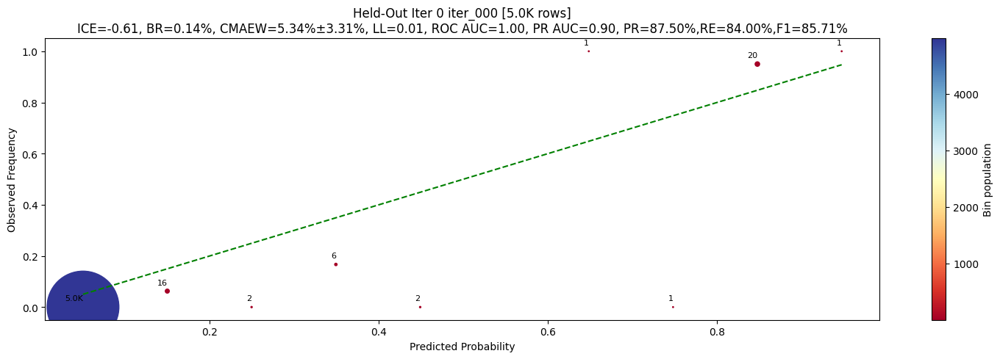

2025-12-22 11:34:56,988 - INFO - initialize-line:2326 - ============================================================
2025-12-22 11:34:56,992 - INFO - initialize-line:2327 - ITERATION 0 COMPLETE
2025-12-22 11:34:56,995 - INFO - initialize-line:2328 -   Train: 1050 samples
2025-12-22 11:34:57,000 - INFO - initialize-line:2329 -   Validation: R=0.840, P=0.875, AUC=0.998, PR-AUC=0.903, ICE=0.0000, LL=0.0067, Brier=0.0014
2025-12-22 11:34:57,004 - INFO - initialize-line:2335 - ============================================================
2025-12-22 11:34:57,009 - INFO - run-line:3152 - ============================================================
2025-12-22 11:34:57,013 - INFO - run-line:3153 - ITERATION 1 (elapsed: 0.01 hours)
2025-12-22 11:34:57,017 - INFO - run-line:3154 - ============================================================


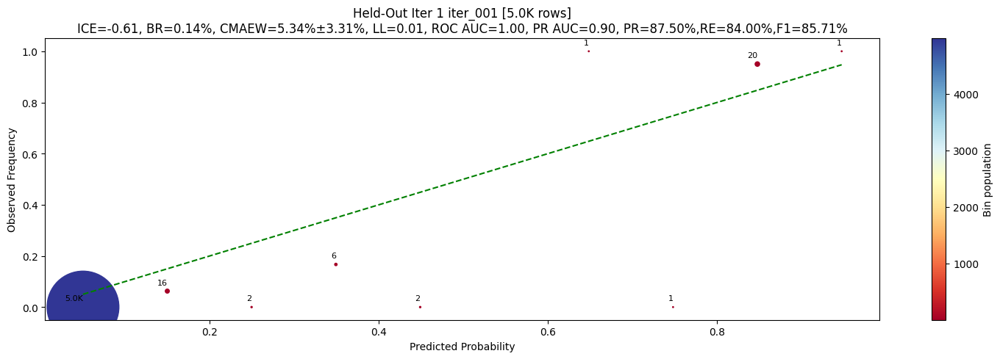

2025-12-22 11:34:58,271 - INFO - _compute_enrichment_factor-line:3046 - Computing enrichment (batched prediction)...
2025-12-22 11:34:58,274 - INFO - _get_unlabeled_features_for_prediction-line:2063 - Creating zero-copy view of unlabeled_samples for prediction... (RAM: 60.14 GB)
2025-12-22 11:35:10,756 - INFO - _get_unlabeled_features_for_prediction-line:2070 - Zero-copy view created: shape=(94028217, 75), RAM: 60.14 -> 87.03 GB (delta: +26.89 GB)
2025-12-22 11:35:10,760 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 11:35:25,883 - INFO - run-line:3165 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 11:44:04,669 - INFO - _predict_unlabeled_pool-line:2461 - Predicting on 94,028,217 samples (batched to avoid OOM)...
2025-12-22 11:44:04,673 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...


Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 11:44:18,433 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 11:44:42,294 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 11:44:56,342 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 11:45:20,015 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 11:45:43,262 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 11:48:17,074 - INFO - _pseudo_label_negatives-line:2602 - Pseudo-negatives added: 100, weight=0.90
2025-12-22 11:48:18,560 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR686208200055661_MJD58345.20677, row=74736114, conf=0.9989


2025-12-22 11:48:19,485 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR686208200055661_MJD58345.20677 (row 74736114) - added
2025-12-22 11:48:19,489 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR803206400078410_MJD58468.09312, row=88981355, conf=0.9989


2025-12-22 11:48:19,577 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR803206400078410_MJD58468.09312 (row 88981355) - added
2025-12-22 11:48:19,582 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR686206100128225_MJD58345.19581, row=74436070, conf=0.9987


2025-12-22 11:48:19,672 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR686206100128225_MJD58345.19581 (row 74436070) - added
2025-12-22 11:48:19,676 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR729205400022878_MJD58437.07226, row=78884387, conf=0.9987


2025-12-22 11:48:19,760 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR729205400022878_MJD58437.07226 (row 78884387) - added
2025-12-22 11:48:19,764 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR541206400003924_MJD58342.20912, row=53540896, conf=0.9985


2025-12-22 11:48:19,849 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR541206400003924_MJD58342.20912 (row 53540896) - added
2025-12-22 11:48:19,854 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR541210400098879_MJD58342.20907, row=53819910, conf=0.9986


2025-12-22 11:48:19,940 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR541210400098879_MJD58342.20907 (row 53819910) - added
2025-12-22 11:48:19,944 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR685205100007414_MJD58345.19415, row=72707496, conf=0.9990


2025-12-22 11:48:20,029 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR685205100007414_MJD58345.19415 (row 72707496) - added
2025-12-22 11:48:20,035 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR411207400047364_MJD58456.30351, row=31710590, conf=0.9987


2025-12-22 11:48:20,122 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR411207400047364_MJD58456.30351 (row 31710590) - added
2025-12-22 11:48:20,126 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR485206400064968_MJD58642.31972, row=40122309, conf=0.9985


2025-12-22 11:48:20,219 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR485206400064968_MJD58642.31972 (row 40122309) - added
2025-12-22 11:48:20,223 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR768205200062188_MJD58448.0962, row=83735577, conf=0.9987


2025-12-22 11:48:20,323 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR768205200062188_MJD58448.0962 (row 83735577) - added
2025-12-22 11:48:20,327 - INFO - _pseudo_label_positives-line:2757 - Pseudo-positives added: 10, weight=0.25
2025-12-22 11:48:25,652 - INFO - _review_pseudo_labels-line:2903 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 1110 reviewed)
2025-12-22 11:48:25,657 - INFO - _balance_class_weights-line:2991 - Effective train size: pos=52.5, neg=1090.0
2025-12-22 11:48:25,660 - INFO - _balance_class_weights-line:2998 - Class weight adjusted: {0: 1.0, 1: 2.076190476190488}
2025-12-22 11:48:25,662 - INFO - run-line:3188 - Building training data...
2025-12-22 11:48:25,678 - INFO - run-line:3192 - Retraining main model...
2025-12-22 11:48:34,692 - INFO - run-line:3216 - OOB metrics: recall=0.962, precision=0.962, coverage=91.64%
2025-12-22 11:48:36,680 - INFO - run-line:3273 - ============================================================
2025-12-22 11:48:

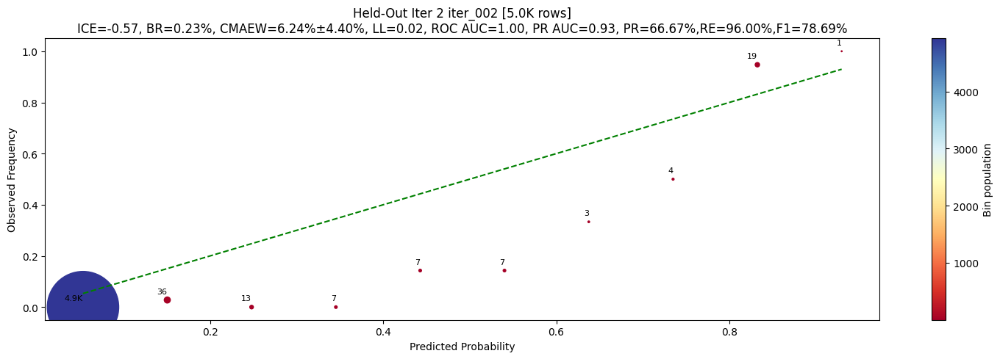

2025-12-22 11:48:38,921 - INFO - _compute_enrichment_factor-line:3046 - Computing enrichment (batched prediction)...
2025-12-22 11:48:38,926 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 11:48:56,032 - INFO - run-line:3165 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 11:57:12,575 - INFO - _predict_unlabeled_pool-line:2461 - Predicting on 94,028,217 samples (batched to avoid OOM)...
2025-12-22 11:57:12,581 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...


Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 11:57:23,608 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 11:57:48,221 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 11:58:11,600 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 11:58:24,174 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 11:58:47,831 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 12:01:02,349 - INFO - _pseudo_label_negatives-line:2602 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 12:01:04,795 - INFO - _review_pseudo_labels-line:2903 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 1210 reviewed)
2025-12-22 12:01:04,805 - INFO - _balance_class_weights-line:2991 - Effective train size: po

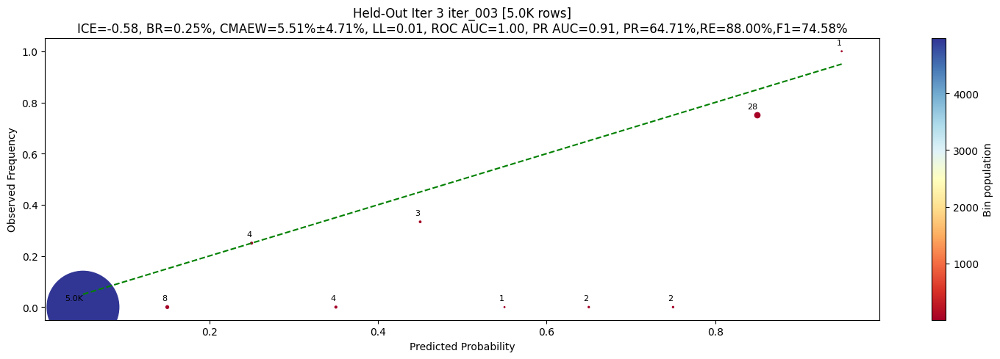

2025-12-22 12:03:09,762 - INFO - _compute_enrichment_factor-line:3046 - Computing enrichment (batched prediction)...
2025-12-22 12:03:09,766 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 12:03:35,555 - INFO - run-line:3165 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 12:13:46,259 - INFO - _predict_unlabeled_pool-line:2461 - Predicting on 94,028,217 samples (batched to avoid OOM)...
2025-12-22 12:13:46,263 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...


Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 12:14:09,035 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 12:14:32,668 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 12:14:55,639 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 12:15:19,328 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 12:15:43,918 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 12:18:02,920 - INFO - _pseudo_label_negatives-line:2602 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 12:18:03,250 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR690210100033851_MJD58660.3602, row=76542690, conf=1.0000


2025-12-22 12:18:03,314 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR690210100033851_MJD58660.3602 (row 76542690) - added
2025-12-22 12:18:03,317 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR767205200085687_MJD58448.0961, row=83251304, conf=1.0000


2025-12-22 12:18:03,370 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR767205200085687_MJD58448.0961 (row 83251304) - added
2025-12-22 12:18:03,374 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR803205200073850_MJD58468.09649, row=88964466, conf=1.0000


2025-12-22 12:18:03,430 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR803205200073850_MJD58468.09649 (row 88964466) - added
2025-12-22 12:18:03,434 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR437210200131757_MJD58348.22627, row=36638955, conf=1.0000


2025-12-22 12:18:03,490 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR437210200131757_MJD58348.22627 (row 36638955) - added
2025-12-22 12:18:03,494 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR767207200066397_MJD58451.06905, row=83325614, conf=1.0000


2025-12-22 12:18:03,551 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR767207200066397_MJD58451.06905 (row 83325614) - added
2025-12-22 12:18:03,555 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR638202400092798_MJD58337.2186, row=66283407, conf=1.0000


2025-12-22 12:18:03,612 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR638202400092798_MJD58337.2186 (row 66283407) - added
2025-12-22 12:18:03,616 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR768214400028804_MJD58451.07232, row=83914745, conf=1.0000


2025-12-22 12:18:03,678 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR768214400028804_MJD58451.07232 (row 83914745) - added
2025-12-22 12:18:03,682 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR803205200026342_MJD58468.16726, row=88966211, conf=0.9999


2025-12-22 12:18:03,744 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR803205200026342_MJD58468.16726 (row 88966211) - added
2025-12-22 12:18:03,747 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR565209300016509_MJD58795.34767, row=57940390, conf=1.0000


2025-12-22 12:18:03,814 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR565209300016509_MJD58795.34767 (row 57940390) - added
2025-12-22 12:18:03,817 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR768214400071601_MJD58451.07233, row=83915389, conf=1.0000


2025-12-22 12:18:03,880 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR768214400071601_MJD58451.07233 (row 83915389) - added
2025-12-22 12:18:03,884 - INFO - _pseudo_label_positives-line:2757 - Pseudo-positives added: 10, weight=0.35
2025-12-22 12:18:06,135 - INFO - _review_pseudo_labels-line:2903 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 1320 reviewed)
2025-12-22 12:18:06,143 - INFO - _balance_class_weights-line:2991 - Effective train size: pos=56.0, neg=1290.0
2025-12-22 12:18:06,147 - INFO - _balance_class_weights-line:2998 - Class weight adjusted: {0: 1.0, 1: 2.3035714285714386}
2025-12-22 12:18:06,150 - INFO - run-line:3188 - Building training data...
2025-12-22 12:18:06,171 - INFO - run-line:3192 - Retraining main model...
2025-12-22 12:20:08,065 - INFO - _adjust_thresholds-line:3021 - Thresholds relaxed: pos>0.985, neg<0.060
2025-12-22 12:20:08,137 - INFO - run-line:3216 - OOB metrics: recall=0.953, precision=0.984, coverage=91.97%
2025-12-22 12:20:10,

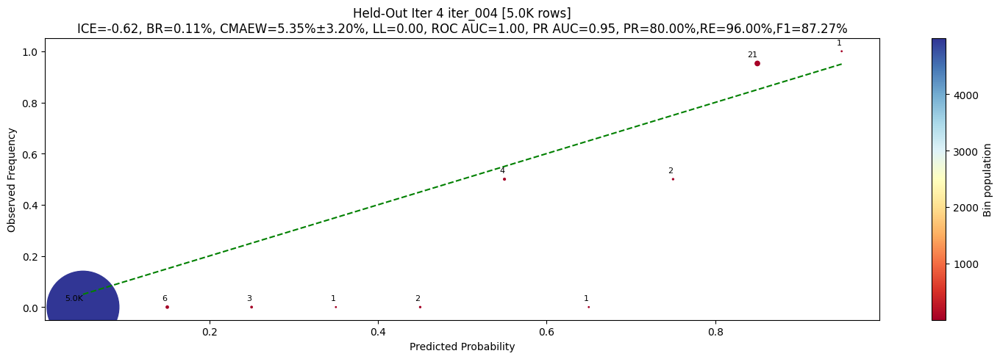

2025-12-22 12:20:12,271 - INFO - _compute_enrichment_factor-line:3046 - Computing enrichment (batched prediction)...
2025-12-22 12:20:12,275 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 12:20:37,916 - INFO - run-line:3165 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 12:29:17,861 - INFO - _predict_unlabeled_pool-line:2461 - Predicting on 94,028,217 samples (batched to avoid OOM)...
2025-12-22 12:29:17,865 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...


Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 12:29:41,729 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 12:30:06,071 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 12:30:29,539 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 12:30:45,362 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 12:31:09,607 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 12:33:28,295 - INFO - _pseudo_label_negatives-line:2602 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 12:33:28,644 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR486215300051610_MJD58643.36275, row=41348058, conf=1.0000


2025-12-22 12:33:28,694 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR486215300051610_MJD58643.36275 (row 41348058) - added
2025-12-22 12:33:28,698 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR777212300027255_MJD58836.1558, row=86636724, conf=1.0000


2025-12-22 12:33:28,737 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR777212300027255_MJD58836.1558 (row 86636724) - added
2025-12-22 12:33:28,740 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR807209100015536_MJD58475.17117, row=93195182, conf=1.0000


2025-12-22 12:33:28,798 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR807209100015536_MJD58475.17117 (row 93195182) - added
2025-12-22 12:33:28,800 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR412212400027889_MJD58457.35357, row=32010402, conf=1.0000


2025-12-22 12:33:28,848 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR412212400027889_MJD58457.35357 (row 32010402) - added
2025-12-22 12:33:28,851 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR411203400031073_MJD58457.3042, row=31642169, conf=0.9999


2025-12-22 12:33:28,906 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR411203400031073_MJD58457.3042 (row 31642169) - added
2025-12-22 12:33:28,909 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR766208400024574_MJD58294.39406, row=83049922, conf=0.9999


2025-12-22 12:33:28,965 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR766208400024574_MJD58294.39406 (row 83049922) - added
2025-12-22 12:33:28,968 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR777211400038934_MJD58836.16364, row=86612476, conf=0.9999


2025-12-22 12:33:29,023 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR777211400038934_MJD58836.16364 (row 86612476) - added
2025-12-22 12:33:29,027 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR588208100043952_MJD58645.34337, row=59553592, conf=0.9999


2025-12-22 12:33:29,101 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR588208100043952_MJD58645.34337 (row 59553592) - added
2025-12-22 12:33:29,105 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR726211100036168_MJD58324.31826, row=77342041, conf=0.9999


2025-12-22 12:33:29,179 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR726211100036168_MJD58324.31826 (row 77342041) - added
2025-12-22 12:33:29,183 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR382208400119305_MJD58639.33981, row=25597099, conf=0.9999


2025-12-22 12:33:29,255 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR382208400119305_MJD58639.33981 (row 25597099) - added
2025-12-22 12:33:29,261 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR562216200020648_MJD58852.19428, row=56424157, conf=0.9999


2025-12-22 12:33:29,336 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR562216200020648_MJD58852.19428 (row 56424157) - added
2025-12-22 12:33:29,339 - INFO - _pseudo_label_positives-line:2757 - Pseudo-positives added: 11, weight=0.40
2025-12-22 12:33:31,769 - INFO - _review_pseudo_labels-line:2903 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 1431 reviewed)
2025-12-22 12:33:31,779 - INFO - _balance_class_weights-line:2991 - Effective train size: pos=60.4, neg=1390.0
2025-12-22 12:33:31,782 - INFO - _balance_class_weights-line:2998 - Class weight adjusted: {0: 1.0, 1: 2.3013245033112684}
2025-12-22 12:33:31,786 - INFO - run-line:3188 - Building training data...
2025-12-22 12:33:31,808 - INFO - run-line:3192 - Retraining main model...
2025-12-22 12:35:21,550 - INFO - _adjust_thresholds-line:3021 - Thresholds relaxed: pos>0.980, neg<0.070
2025-12-22 12:35:21,632 - INFO - run-line:3216 - OOB metrics: recall=0.961, precision=0.986, coverage=90.88%
2025-12-22 12:35:23,

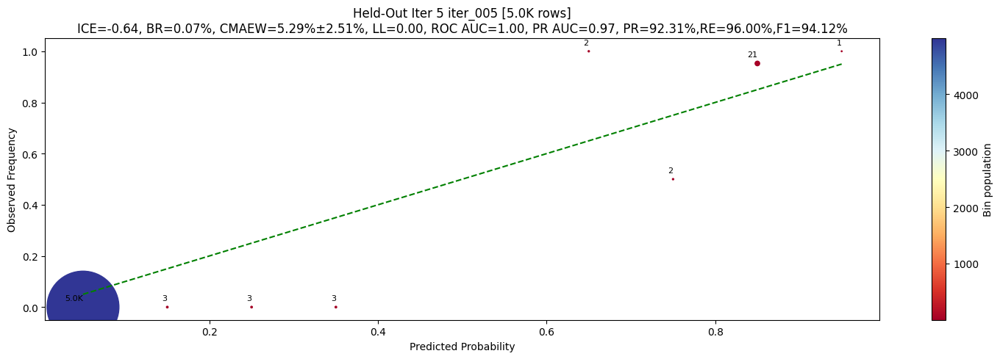

2025-12-22 12:35:25,717 - INFO - _compute_enrichment_factor-line:3046 - Computing enrichment (batched prediction)...
2025-12-22 12:35:25,721 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 12:35:50,302 - INFO - _finalize-line:3382 - ============================================================
2025-12-22 12:35:50,306 - INFO - _finalize-line:3383 - FINALIZATION
2025-12-22 12:35:50,308 - INFO - _finalize-line:3384 - Stop reason: SUCCESS
2025-12-22 12:35:50,311 - INFO - _finalize-line:3385 - ============================================================
2025-12-22 12:35:50,313 - INFO - _load_best_model-line:3305 - Loading best model from iteration 0
2025-12-22 12:35:50,366 - INFO - _finalize-line:3391 - Computing honest held-out metrics (never used for training decisions)...


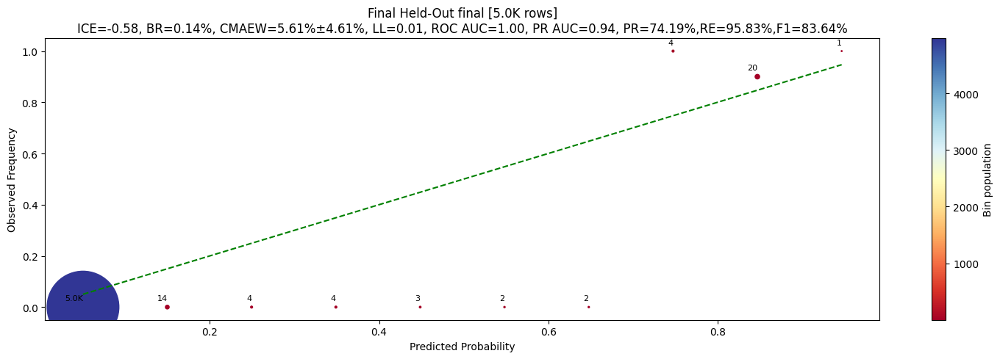

KeyError: 'ice'

time: 1h 1min 19s (started: 2025-12-22 11:34:34 +03:00)


In [15]:
from os.path import join
from active_learning_pipeline import run_active_learning_pipeline

# setup_logging(level=logging.INFO)

# Run pipeline
results = run_active_learning_pipeline(
    unlabeled_samples=big_features,
    known_flares=oos_features,
    output_dir=join(r"R:\Data\Astronomy", "active_learning_output"),
    unlabeled_dataset=dataset["target"],
    known_flares_dataset=dataset["test"],
)

In [26]:
big_features.head().to_pandas().dtypes

id                                         object
class                                     float64
npoints                                    uint32
mag_mean                                  float32
mag_std                                   float32
                                           ...   
mjd_span                                  float32
norm_frac_below_3sigma                    float64
norm_max_consecutive_frac_below_2sigma    float64
norm_frac_local_minima                    float64
norm_frac_zero_crossings                  float64
Length: 78, dtype: object

time: 31 ms (started: 2025-12-23 06:34:24 +03:00)


2025-12-22 13:42:11,717 - INFO - __init__-line:1641 - Output directory: R:\Data\Astronomy\active_learning_output_20251222_134211
2025-12-22 13:42:11,720 - INFO - _validate_inputs-line:1719 - unlabeled_samples: 94,028,217 samples
2025-12-22 13:42:11,723 - INFO - _validate_inputs-line:1720 - known_flares: 99 known flares
2025-12-22 13:42:11,726 - INFO - __init__-line:1651 - Using 75 feature columns
2025-12-22 13:42:11,728 - INFO - __init__-line:1688 - Tracking row index 55554273
2025-12-22 13:42:11,730 - INFO - initialize-line:2139 - ============================================================
2025-12-22 13:42:11,733 - INFO - initialize-line:2140 - PHASE 0: INITIALIZATION
2025-12-22 13:42:11,736 - INFO - initialize-line:2141 - ============================================================
2025-12-22 13:42:11,747 - INFO - stratified_flare_split-line:425 - Stratified split: train=50, val=25, held_out=24
2025-12-22 13:42:11,751 - INFO - initialize-line:2161 - Flares split (stratified): train=

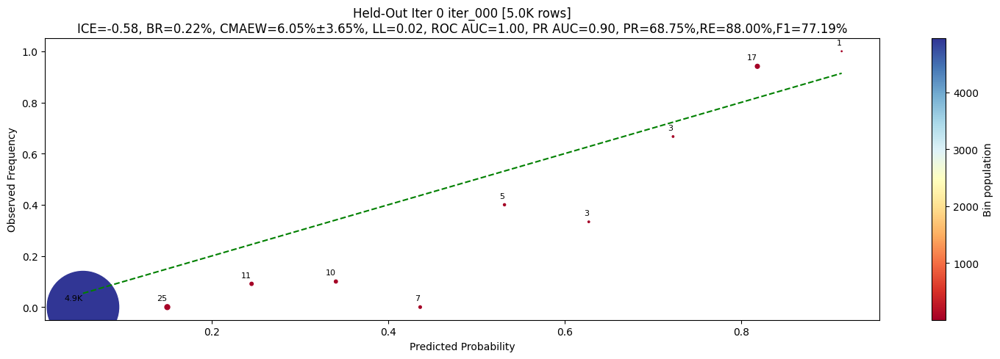

2025-12-22 13:42:41,647 - INFO - _get_tracked_rowid_probability-line:2114 - Tracked row 55554273: P(flare)=0.026805
2025-12-22 13:42:41,650 - INFO - initialize-line:2282 - ============================================================
2025-12-22 13:42:41,652 - INFO - initialize-line:2283 - ITERATION 0 COMPLETE
2025-12-22 13:42:41,655 - INFO - initialize-line:2284 -   Train: 1050 samples
2025-12-22 13:42:41,659 - INFO - initialize-line:2285 -   Validation: R=0.880, P=0.688, AUC=0.998, PR-AUC=0.899, ICE=0.0000, LL=0.0176, Brier=0.0022
2025-12-22 13:42:41,663 - INFO - initialize-line:2291 - ============================================================
2025-12-22 13:42:41,667 - INFO - run-line:3173 - ============================================================
2025-12-22 13:42:41,671 - INFO - run-line:3174 - ITERATION 1 (elapsed: 0.01 hours)
2025-12-22 13:42:41,675 - INFO - run-line:3175 - ============================================================


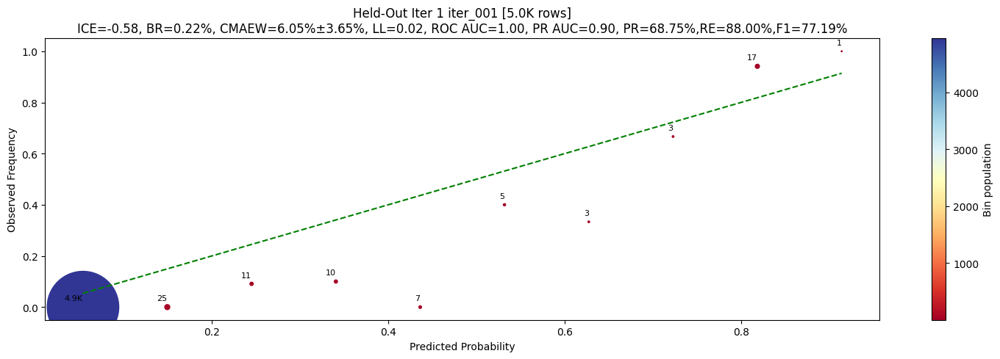

2025-12-22 13:42:42,743 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 13:42:42,747 - INFO - _get_unlabeled_features_for_prediction-line:2019 - Creating zero-copy view of unlabeled_samples for prediction... (RAM: 31.52 GB)
2025-12-22 13:43:07,703 - INFO - _get_unlabeled_features_for_prediction-line:2026 - Zero-copy view created: shape=(94028217, 75), RAM: 31.52 -> 83.34 GB (delta: +51.82 GB)
2025-12-22 13:43:20,676 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 13:55:26,298 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=0.90
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 13:55:29,146 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_001.parquet
2025-12-22 13:55:34,279 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 1100 reviewed)
2025-12-22 13:55:34,285 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=50.0, neg=1090.0
2025-12-22 13:55:34,288 - INFO - _balance_class_weights-line:2976 - Class weight adjusted: {0: 1.0, 1: 2.180000000000012}
2025-12-22 13:55:34,292 - INFO - run-line:3212 - Building training data...
2025-12-22 13:55:34,324 - INFO - run-line:3216 - Retraining main model...
2025-12-22 13:55:56,106 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched p

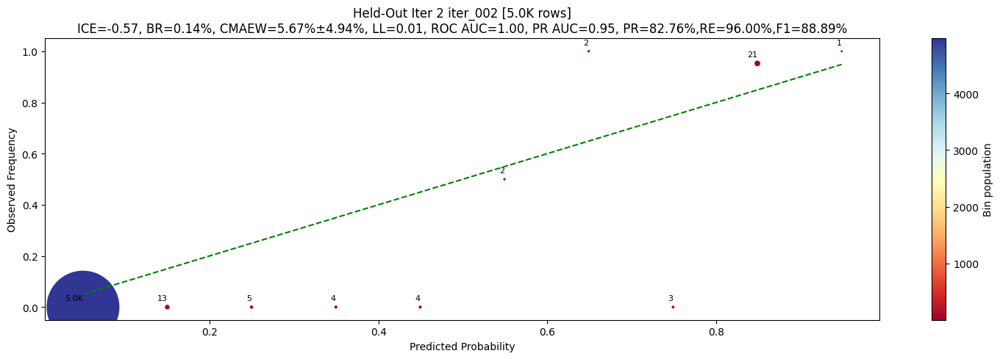

2025-12-22 13:56:26,913 - INFO - _validate_and_check_stopping-line:2358 - New best model saved (validation recall=0.960, ICE not available)
2025-12-22 13:56:26,916 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 13:56:48,631 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 14:05:50,663 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 14:05:52,527 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR777212300027255_MJD58836.1558, row=86636724, conf=0.9977


2025-12-22 14:06:00,428 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR686206100128225_MJD58345.19581, row=74436070, conf=0.9974


2025-12-22 14:06:00,880 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR690210100033851_MJD58660.3602, row=76542690, conf=0.9973


2025-12-22 14:06:01,251 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR485216300006424_MJD58642.32006, row=40301631, conf=0.9973


2025-12-22 14:06:01,571 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR588213400058251_MJD58645.33807, row=59567108, conf=0.9971


2025-12-22 14:06:02,023 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR487211400048382_MJD58644.36131, row=41701472, conf=0.9971


2025-12-22 14:06:02,412 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR767205200085687_MJD58448.0961, row=83251304, conf=0.9964


2025-12-22 14:06:02,700 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR309206300050770_MJD58464.36662, row=12476119, conf=0.9969


2025-12-22 14:06:03,109 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR803209200088578_MJD58468.09334, row=89017048, conf=0.9967


2025-12-22 14:06:03,473 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR487207400017156_MJD58644.36182, row=41509964, conf=0.9967


2025-12-22 14:06:03,801 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 10, weight=0.30
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 14:06:06,347 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_002.parquet
2025-12-22 14:06:09,037 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 1210 reviewed)
2025-12-22 14:06:09,046 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=53.0, neg=1190.0
2025-12-22 14:06:09,051 - INFO - _balance_class_weights-line:2976 - Class weight adjusted: {0: 1.0, 1: 2.2452830188679376}
2025-12-22 14:06:09,055 - INFO - run-line:3212 - Building training data...
2025-12-22 14:06:09,091 - INFO - run-line:3216 - Retraining main model...
2025-12-22 14:07:48,336 - INFO - run-line:3244 - OOB metrics: recall=0.912, precision=0.981, coverage=9

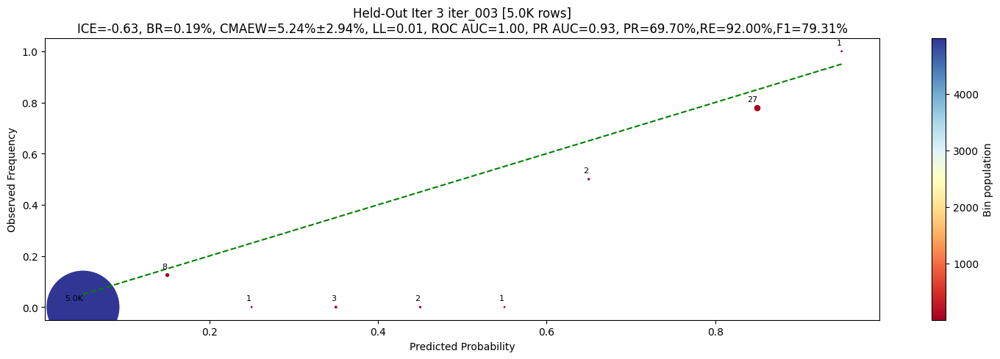

2025-12-22 14:07:52,181 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 14:08:15,012 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 14:18:54,554 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 14:18:54,898 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR591201400123433_MJD58343.19632, row=60897090, conf=0.9999


2025-12-22 14:18:55,283 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR485209200074779_MJD58642.32091, row=40175077, conf=0.9999


2025-12-22 14:18:55,688 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR592205400073734_MJD58343.20432, row=61870944, conf=0.9998


2025-12-22 14:18:56,021 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR689209400047208_MJD58450.11516, row=76319458, conf=0.9998


2025-12-22 14:18:56,322 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR613213200002748_MJD58791.37926, row=64105007, conf=0.9998


2025-12-22 14:18:56,763 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR611215200019569_MJD58846.16629, row=63213765, conf=0.9998


2025-12-22 14:18:57,165 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR769213300085419_MJD59026.40768, row=84724493, conf=0.9998


2025-12-22 14:18:57,547 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR336202400036948_MJD58667.36244, row=24273407, conf=0.9998


2025-12-22 14:18:57,898 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR767212100038888_MJD58448.09582, row=83512259, conf=0.9997


2025-12-22 14:18:58,192 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR565209300016509_MJD58795.34767, row=57940390, conf=0.9998


2025-12-22 14:18:58,540 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 10, weight=0.35
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 14:19:00,847 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_003.parquet
2025-12-22 14:19:03,228 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 1320 reviewed)
2025-12-22 14:19:03,235 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=56.5, neg=1290.0
2025-12-22 14:19:03,238 - INFO - _balance_class_weights-line:2976 - Class weight adjusted: {0: 1.0, 1: 2.283185840707976}
2025-12-22 14:19:03,241 - INFO - run-line:3212 - Building training data...
2025-12-22 14:19:03,262 - INFO - run-line:3216 - Retraining main model...
2025-12-22 14:20:41,083 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.985, neg<0.060

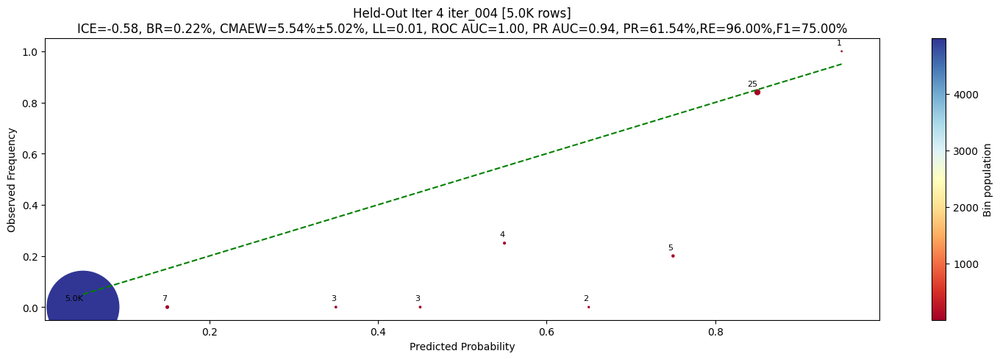

2025-12-22 14:20:45,247 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 14:21:08,748 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 14:33:07,505 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 14:33:07,813 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR729205400022878_MJD58437.07226, row=78884387, conf=1.0000


2025-12-22 14:33:08,074 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR772205100015789_MJD58649.39654, row=85579316, conf=1.0000


2025-12-22 14:33:08,460 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR411207400047364_MJD58456.30351, row=31710590, conf=1.0000


2025-12-22 14:33:08,741 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR832202400057547_MJD58775.21301, row=93826594, conf=1.0000


2025-12-22 14:33:08,984 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR807209100015536_MJD58475.17117, row=93195182, conf=1.0000


2025-12-22 14:33:09,201 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR853213400035322_MJD59034.39789, row=94005397, conf=0.9999


2025-12-22 14:33:09,578 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR562216200020648_MJD58852.19428, row=56424157, conf=1.0000


2025-12-22 14:33:09,876 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR769206400068558_MJD58466.09151, row=84315213, conf=1.0000


2025-12-22 14:33:10,229 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR803206400078410_MJD58468.09312, row=88981355, conf=0.9999


2025-12-22 14:33:10,596 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR638207400094988_MJD58338.21312, row=66555298, conf=0.9999


2025-12-22 14:33:10,890 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR771207400041547_MJD58461.14842, row=85329752, conf=0.9999


2025-12-22 14:33:11,198 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 11, weight=0.40
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 14:33:13,948 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_004.parquet
2025-12-22 14:33:16,685 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 1431 reviewed)
2025-12-22 14:33:16,695 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=60.9, neg=1390.0
2025-12-22 14:33:16,700 - INFO - _balance_class_weights-line:2976 - Class weight adjusted: {0: 1.0, 1: 2.2824302134647074}
2025-12-22 14:33:16,704 - INFO - run-line:3212 - Building training data...
2025-12-22 14:33:16,727 - INFO - run-line:3216 - Retraining main model...
2025-12-22 14:34:50,621 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.980, neg<0.07

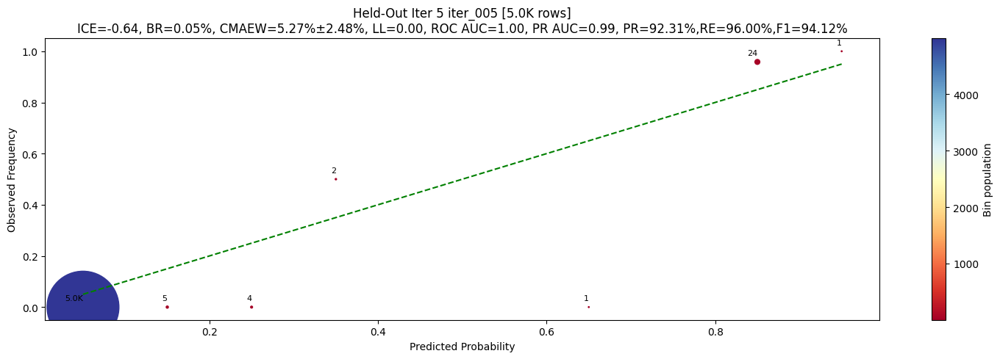

2025-12-22 14:34:54,751 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 14:35:18,249 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 14:46:55,784 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 14:46:56,191 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR706202400007742_MJD58793.38607, row=76648546, conf=0.9999


2025-12-22 14:46:56,399 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR766208400024574_MJD58294.39406, row=83049922, conf=1.0000


2025-12-22 14:46:56,613 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR260202100050853_MJD58481.33112, row=363036, conf=1.0000


2025-12-22 14:46:56,831 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR382208400119305_MJD58639.33981, row=25597099, conf=1.0000


2025-12-22 14:46:57,026 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR412212400027889_MJD58457.35357, row=32010402, conf=0.9999


2025-12-22 14:46:57,217 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768214400071601_MJD58451.07233, row=83915389, conf=0.9999


2025-12-22 14:46:57,406 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR486215300051610_MJD58643.36275, row=41348058, conf=1.0000


2025-12-22 14:46:57,640 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR335207400088082_MJD58674.36788, row=23681707, conf=0.9999


2025-12-22 14:46:57,848 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR641215300040202_MJD59022.401, row=69073186, conf=1.0000


2025-12-22 14:46:58,089 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR806212200035304_MJD59032.39842, row=92679156, conf=1.0000


2025-12-22 14:46:58,324 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR280210200181313_MJD58302.22747, row=3511464, conf=0.9999


2025-12-22 14:46:58,529 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR386216200054647_MJD59010.40628, row=31530231, conf=0.9999


2025-12-22 14:46:58,746 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 12, weight=0.45
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 14:47:01,710 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_005.parquet
2025-12-22 14:47:04,402 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 1543 reviewed)
2025-12-22 14:47:04,407 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=66.3, neg=1490.0
2025-12-22 14:47:04,410 - INFO - _balance_class_weights-line:2976 - Class weight adjusted: {0: 1.0, 1: 2.2473604826546096}
2025-12-22 14:47:04,413 - INFO - run-line:3212 - Building training data...
2025-12-22 14:47:04,431 - INFO - run-line:3216 - Retraining main model...
2025-12-22 14:47:34,853 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.975, neg<0.08

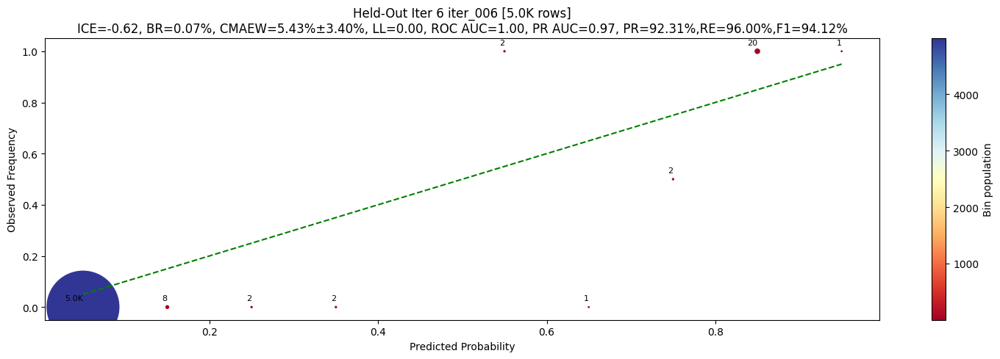

2025-12-22 14:48:06,084 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 14:48:24,665 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 14:56:13,360 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 14:56:13,664 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR257210200005675_MJD58472.31832, row=41723, conf=0.9996


2025-12-22 14:56:13,956 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768214400028804_MJD58451.07232, row=83914745, conf=0.9997


2025-12-22 14:56:14,273 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR330216400048567_MJD58290.27853, row=13532923, conf=0.9996


2025-12-22 14:56:14,629 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR279205200117764_MJD58635.3003, row=1400735, conf=0.9997


2025-12-22 14:56:14,998 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR726211100036168_MJD58324.31826, row=77342041, conf=0.9996


2025-12-22 14:56:15,331 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR742213300019875_MJD58806.40401, row=82413284, conf=0.9996


2025-12-22 14:56:15,647 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR410210100030608_MJD58812.44892, row=31587544, conf=0.9997


2025-12-22 14:56:16,071 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR803205200073850_MJD58468.09649, row=88964466, conf=0.9997


2025-12-22 14:56:16,382 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR587205200026342_MJD59019.42674, row=59521101, conf=0.9996


2025-12-22 14:56:16,676 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR806213300034732_MJD59032.42874, row=92811257, conf=0.9996


2025-12-22 14:56:16,978 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR335210400084533_MJD58674.36832, row=23845773, conf=0.9997


2025-12-22 14:56:17,358 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR771205200039849_MJD58461.14873, row=85295878, conf=0.9996


2025-12-22 14:56:17,629 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR284207300132950_MJD58286.35077, row=10713165, conf=0.9996


2025-12-22 14:56:17,975 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 13, weight=0.50
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 14:56:20,403 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_006.parquet
2025-12-22 14:56:23,151 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 1656 reviewed)
2025-12-22 14:56:23,160 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=72.8, neg=1590.0
2025-12-22 14:56:23,165 - INFO - _balance_class_weights-line:2976 - Class weight adjusted: {0: 1.0, 1: 2.1840659340659423}
2025-12-22 14:56:23,169 - INFO - run-line:3212 - Building training data...
2025-12-22 14:56:23,272 - INFO - run-line:3216 - Retraining main model...
2025-12-22 14:57:57,222 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.970, neg<0.09

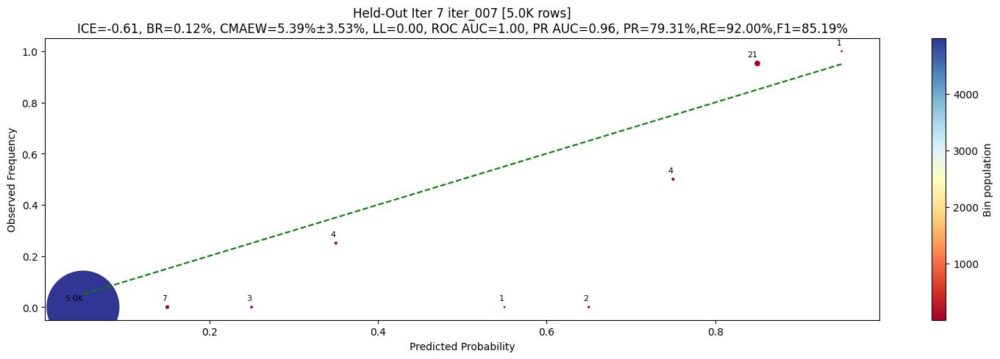

2025-12-22 14:58:01,169 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 14:58:23,579 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 15:09:15,743 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 15:09:16,051 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR258214100018083_MJD58487.27621, row=101527, conf=0.9999


2025-12-22 15:09:16,325 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR638202400092798_MJD58337.2186, row=66283407, conf=0.9999


2025-12-22 15:09:16,584 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR538202300127593_MJD58334.19824, row=49121917, conf=0.9998


2025-12-22 15:09:16,940 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR592208400030991_MJD58343.19487, row=61952056, conf=0.9998


2025-12-22 15:09:17,214 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR284210200088562_MJD58286.3507, row=11123059, conf=0.9999


2025-12-22 15:09:17,402 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR733209300032227_MJD58648.41277, row=82149824, conf=0.9998


2025-12-22 15:09:17,579 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR640215300013929_MJD59004.40338, row=68481756, conf=0.9998


2025-12-22 15:09:17,943 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR541206400003924_MJD58342.20912, row=53540896, conf=0.9998


2025-12-22 15:09:18,208 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR541209200068438_MJD58342.21643, row=53727368, conf=0.9998


2025-12-22 15:09:18,507 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR283210400186980_MJD58312.26883, row=8323633, conf=0.9998


2025-12-22 15:09:18,776 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR541205400077818_MJD58342.20922, row=53473598, conf=0.9997


2025-12-22 15:09:19,020 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768204200065336_MJD58451.0679, row=83711971, conf=0.9998


2025-12-22 15:09:19,303 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR638201300158344_MJD58337.21306, row=66204867, conf=0.9997


2025-12-22 15:09:19,630 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR538210200015275_MJD58334.19621, row=50212410, conf=0.9998


2025-12-22 15:09:19,936 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 14, weight=0.55
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 15:09:21,829 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_007.parquet
2025-12-22 15:09:24,372 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 1770 reviewed)
2025-12-22 15:09:24,378 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=80.5, neg=1690.0
2025-12-22 15:09:24,381 - INFO - _balance_class_weights-line:2976 - Class weight adjusted: {0: 1.0, 1: 2.0993788819875863}
2025-12-22 15:09:24,385 - INFO - run-line:3212 - Building training data...
2025-12-22 15:09:24,405 - INFO - run-line:3216 - Retraining main model...
2025-12-22 15:10:55,770 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.965, neg<0.10

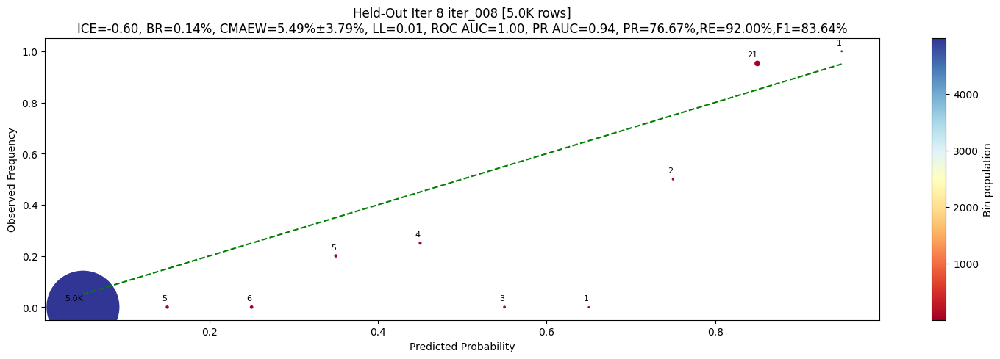

2025-12-22 15:10:59,986 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 15:11:22,244 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 15:20:28,148 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 15:20:28,479 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR331210200157488_MJD58304.23701, row=15395041, conf=0.9992


2025-12-22 15:20:28,788 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR260208100017563_MJD58493.28958, row=473371, conf=0.9992


2025-12-22 15:20:29,103 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR541212300185918_MJD58342.20521, row=54062324, conf=0.9992


2025-12-22 15:20:29,356 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768214400028233_MJD58451.06948, row=83914367, conf=0.9992


2025-12-22 15:20:29,684 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR806213300000569_MJD59032.40954, row=92812974, conf=0.9991


2025-12-22 15:20:29,985 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR541206400101933_MJD58342.20455, row=53535423, conf=0.9990


2025-12-22 15:20:30,351 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR688208200078236_MJD58449.07646, row=75824536, conf=0.9990


2025-12-22 15:20:30,700 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR685205100007414_MJD58345.19415, row=72707496, conf=0.9991


2025-12-22 15:20:30,939 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR660207300043882_MJD58790.37998, row=70343242, conf=0.9989


2025-12-22 15:20:31,211 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR539210200165827_MJD58334.22748, row=51306753, conf=0.9991


2025-12-22 15:20:31,473 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR380212200034960_MJD59046.2361, row=24813928, conf=0.9990


2025-12-22 15:20:31,713 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR411210400046888_MJD58457.34142, row=31764091, conf=0.9988


2025-12-22 15:20:31,999 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR331210200152241_MJD58306.23738, row=15405156, conf=0.9991


2025-12-22 15:20:32,262 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR541210400098879_MJD58342.20907, row=53819910, conf=0.9990


2025-12-22 15:20:32,460 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR591205400132465_MJD58343.19623, row=61165680, conf=0.9990


2025-12-22 15:20:32,681 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 15, weight=0.60
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 15:20:34,487 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_008.parquet
2025-12-22 15:20:37,036 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 1885 reviewed)
2025-12-22 15:20:37,044 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=89.5, neg=1790.0
2025-12-22 15:20:37,049 - INFO - _balance_class_weights-line:2976 - Class weight adjusted: {0: 1.0, 1: 2.0000000000000098}
2025-12-22 15:20:37,054 - INFO - run-line:3212 - Building training data...
2025-12-22 15:20:37,077 - INFO - run-line:3216 - Retraining main model...
2025-12-22 15:22:06,934 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.960, neg<0.10

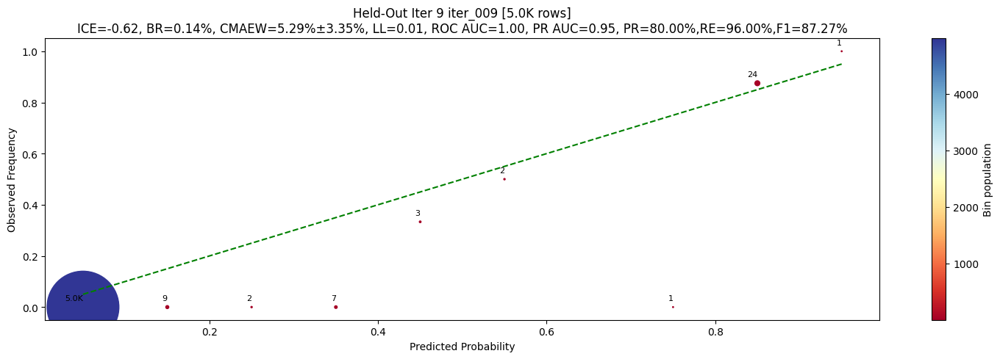

2025-12-22 15:22:11,597 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 15:22:33,616 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 15:32:57,424 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 15:32:57,770 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR488202400091403_MJD58340.19342, row=42144925, conf=0.9998


2025-12-22 15:32:58,089 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR386209400023272_MJD59010.40318, row=31392323, conf=0.9998


2025-12-22 15:32:58,408 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR311209200027397_MJD58494.31507, row=12684217, conf=0.9997


2025-12-22 15:32:58,734 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR591206400110461_MJD58343.19521, row=61290457, conf=0.9998


2025-12-22 15:32:59,033 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR538210400058082_MJD58334.19444, row=50244690, conf=0.9998


2025-12-22 15:32:59,326 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR538206400078914_MJD58334.19729, row=49845796, conf=0.9998


2025-12-22 15:32:59,690 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR261208400022343_MJD58486.34514, row=736105, conf=0.9998


2025-12-22 15:32:59,970 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR485210200059525_MJD58642.3196, row=40198079, conf=0.9998


2025-12-22 15:33:00,344 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR767206100019391_MJD58448.0979, row=83276787, conf=0.9998


2025-12-22 15:33:00,619 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR615205200000289_MJD58797.34784, row=65054282, conf=0.9998


2025-12-22 15:33:00,946 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR538206400133713_MJD58334.19544, row=49860465, conf=0.9998


2025-12-22 15:33:01,210 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR803202400045683_MJD58468.0926, row=88935101, conf=0.9998


2025-12-22 15:33:01,516 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR541206100062408_MJD58342.20635, row=53486851, conf=0.9997


2025-12-22 15:33:01,845 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR591201400078246_MJD58343.19629, row=60892719, conf=0.9998


2025-12-22 15:33:02,172 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR803202400045660_MJD58468.0926, row=88933579, conf=0.9998


2025-12-22 15:33:02,511 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR591213400149403_MJD58343.19603, row=61721259, conf=0.9997


2025-12-22 15:33:02,827 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 16, weight=0.65
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 15:33:05,085 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_009.parquet
2025-12-22 15:33:07,738 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 2001 reviewed)
2025-12-22 15:33:07,746 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=99.9, neg=1890.0
2025-12-22 15:33:07,750 - INFO - run-line:3212 - Building training data...
2025-12-22 15:33:07,774 - INFO - run-line:3216 - Retraining main model...
2025-12-22 15:34:39,302 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.955, neg<0.100
2025-12-22 15:34:39,396 - INFO - run-line:3244 - OOB metrics: recall=0.965, precision=0.993, coverage=91.08%
2025-12-22 1

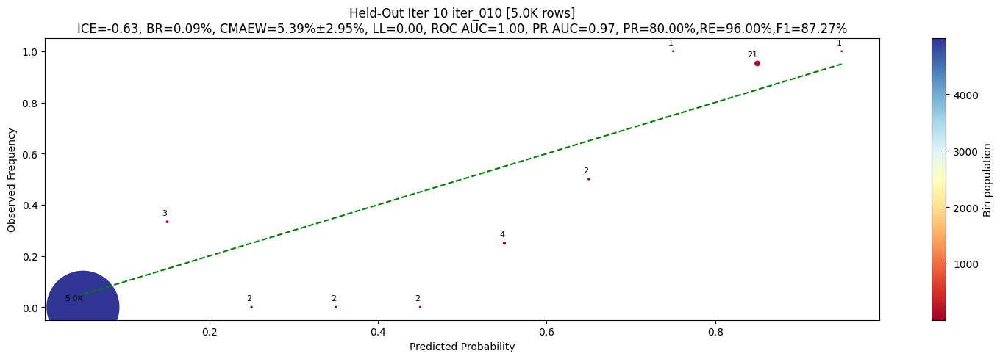

2025-12-22 15:34:43,816 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 15:35:06,016 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 15:43:05,644 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 15:43:05,950 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR832202400043027_MJD58775.21301, row=93825628, conf=0.9998


2025-12-22 15:43:06,149 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR283205200168445_MJD58310.28408, row=6954821, conf=0.9996


2025-12-22 15:43:06,410 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR765206400013258_MJD58327.21512, row=82934331, conf=0.9998


2025-12-22 15:43:06,691 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR565211200039869_MJD58795.33718, row=57999125, conf=0.9998


2025-12-22 15:43:06,978 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768214400040803_MJD58448.09811, row=83914619, conf=0.9998


2025-12-22 15:43:07,242 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR283205400130939_MJD58311.27172, row=7010460, conf=0.9998


2025-12-22 15:43:07,534 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR539212400149392_MJD58334.19505, row=51613140, conf=0.9998


2025-12-22 15:43:07,761 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR333204200063719_MJD58314.25843, row=17853870, conf=0.9998


2025-12-22 15:43:08,087 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR686208200055661_MJD58345.20677, row=74736114, conf=0.9998


2025-12-22 15:43:08,345 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR588202400031254_MJD58645.3385, row=59539611, conf=0.9998


2025-12-22 15:43:08,624 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR589208400069150_MJD58646.33947, row=59644290, conf=0.9997


2025-12-22 15:43:08,901 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR308213400055537_MJD58464.35106, row=12412529, conf=0.9997


2025-12-22 15:43:09,178 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR733206200034504_MJD58648.37762, row=82141120, conf=0.9998


2025-12-22 15:43:09,459 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR436213300090627_MJD59015.40307, row=35770660, conf=0.9998


2025-12-22 15:43:09,767 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR279210200131272_MJD58635.30032, row=1759143, conf=0.9997


2025-12-22 15:43:10,031 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR284206400059477_MJD58286.3557, row=10579677, conf=0.9993


2025-12-22 15:43:10,284 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR637210200060641_MJD58657.28097, row=66058482, conf=0.9997


2025-12-22 15:43:10,571 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 17, weight=0.70
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 15:43:12,664 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_010.parquet
2025-12-22 15:43:15,537 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 2118 reviewed)
2025-12-22 15:43:15,545 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=111.8, neg=1990.0
2025-12-22 15:43:15,549 - INFO - run-line:3212 - Building training data...
2025-12-22 15:43:15,574 - INFO - run-line:3216 - Retraining main model...
2025-12-22 15:44:47,340 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.950, neg<0.100
2025-12-22 15:44:47,345 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
202

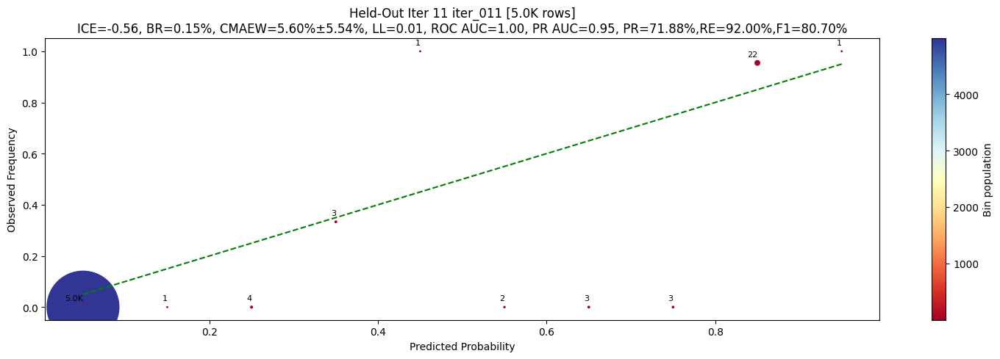

2025-12-22 15:45:19,260 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 15:45:42,061 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 15:58:21,501 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 15:58:22,137 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR686212300069746_MJD58346.19235, row=75188431, conf=0.9999


2025-12-22 15:58:22,459 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768214400042723_MJD58451.07706, row=83913816, conf=0.9999


2025-12-22 15:58:22,758 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR686204200152909_MJD58345.19478, row=74259670, conf=0.9999


2025-12-22 15:58:23,089 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR766210200039235_MJD58296.39101, row=83065890, conf=0.9999


2025-12-22 15:58:23,484 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR636214400043200_MJD59047.36452, row=65820841, conf=0.9999


2025-12-22 15:58:23,765 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR437210200131757_MJD58348.22627, row=36638955, conf=0.9999


2025-12-22 15:58:24,048 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR687204200021319_MJD58658.32456, row=75551581, conf=0.9999


2025-12-22 15:58:24,318 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR591205400102586_MJD58344.19404, row=61162245, conf=0.9999


2025-12-22 15:58:24,651 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR439206400041938_MJD58662.36111, row=37821827, conf=0.9999


2025-12-22 15:58:25,000 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR701203400024638_MJD58792.26306, row=76575056, conf=0.9999


2025-12-22 15:58:25,349 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR684206100003480_MJD58299.23613, row=72038480, conf=0.9999


2025-12-22 15:58:25,635 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR382213400132083_MJD58639.3396, row=25726890, conf=0.9999


2025-12-22 15:58:26,000 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR260205400062161_MJD58493.28813, row=437357, conf=0.9999


2025-12-22 15:58:26,375 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR539204200171808_MJD58334.197, row=50619653, conf=0.9999


2025-12-22 15:58:26,665 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR639206300028309_MJD58338.20786, row=67234796, conf=0.9999


2025-12-22 15:58:27,021 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR540206300175580_MJD58342.20558, row=52565519, conf=0.9999


2025-12-22 15:58:27,352 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR439209400031564_MJD58662.36096, row=37825428, conf=0.9999


2025-12-22 15:58:27,767 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR685205100128648_MJD58345.19511, row=72716659, conf=0.9999


2025-12-22 15:58:28,058 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 18, weight=0.75
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 15:58:31,502 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_011.parquet
2025-12-22 15:58:34,750 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 2236 reviewed)
2025-12-22 15:58:34,760 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=125.3, neg=2090.0
2025-12-22 15:58:34,765 - INFO - run-line:3212 - Building training data...
2025-12-22 15:58:34,794 - INFO - run-line:3216 - Retraining main model...
2025-12-22 15:59:01,139 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.950, neg<0.100
2025-12-22 15:59:01,223 - INFO - run-line:3244 - OOB metrics: recall=0.971, precision=0.988, coverage=90.51%
2025-12-22 

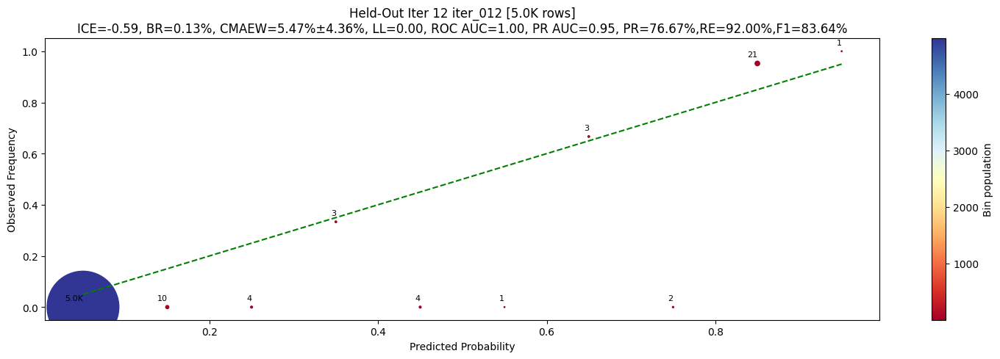

2025-12-22 15:59:06,519 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 15:59:32,142 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 16:12:47,088 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 16:12:47,624 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR766206200043184_MJD58295.39215, row=83025300, conf=0.9998


2025-12-22 16:12:47,924 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR772213400041905_MJD58776.33886, row=85613498, conf=0.9998


2025-12-22 16:12:48,254 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR591216400046619_MJD58344.19261, row=61782142, conf=0.9998


2025-12-22 16:12:48,526 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR257208300005695_MJD58468.30895, row=32203, conf=0.9998


2025-12-22 16:12:48,832 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR284212200131884_MJD58286.35129, row=11538718, conf=0.9998


2025-12-22 16:12:49,132 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR613212400023118_MJD58791.37965, row=64071401, conf=0.9998


2025-12-22 16:12:49,519 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768201400095153_MJD58448.09901, row=83679421, conf=0.9998


2025-12-22 16:12:49,786 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR613204400038656_MJD58836.23776, row=63513058, conf=0.9998


2025-12-22 16:12:50,053 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768204100079115_MJD58451.0699, row=83708300, conf=0.9998


2025-12-22 16:12:50,350 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768212100084137_MJD58448.09586, row=83885356, conf=0.9998


2025-12-22 16:12:50,633 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR591212400117995_MJD58343.19402, row=61684930, conf=0.9998


2025-12-22 16:12:50,910 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR381216400017742_MJD59012.40417, row=25003867, conf=0.9998


2025-12-22 16:12:51,274 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR284207300092369_MJD58286.35077, row=10704025, conf=0.9998


2025-12-22 16:12:51,583 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR280206400117265_MJD58303.22784, row=2881280, conf=0.9998


2025-12-22 16:12:51,952 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR279210200133722_MJD58635.30032, row=1759777, conf=0.9998


2025-12-22 16:12:52,259 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR592207400109587_MJD58344.19744, row=61908544, conf=0.9998


2025-12-22 16:12:52,498 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR588201300038850_MJD58645.33888, row=59535966, conf=0.9997


2025-12-22 16:12:52,750 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR437210400093835_MJD58348.21713, row=36686648, conf=0.9998


2025-12-22 16:12:53,075 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR685207400060513_MJD58346.19175, row=73045107, conf=0.9997


2025-12-22 16:12:53,350 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 19, weight=0.80
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 16:12:56,784 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_012.parquet
2025-12-22 16:12:59,703 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 2355 reviewed)
2025-12-22 16:12:59,712 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=140.5, neg=2190.0
2025-12-22 16:12:59,717 - INFO - run-line:3212 - Building training data...
2025-12-22 16:12:59,743 - INFO - run-line:3216 - Retraining main model...
2025-12-22 16:13:18,718 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.950, neg<0.100
2025-12-22 16:13:18,813 - INFO - run-line:3244 - OOB metrics: recall=0.984, precision=0.995, coverage=89.90%
2025-12-22 

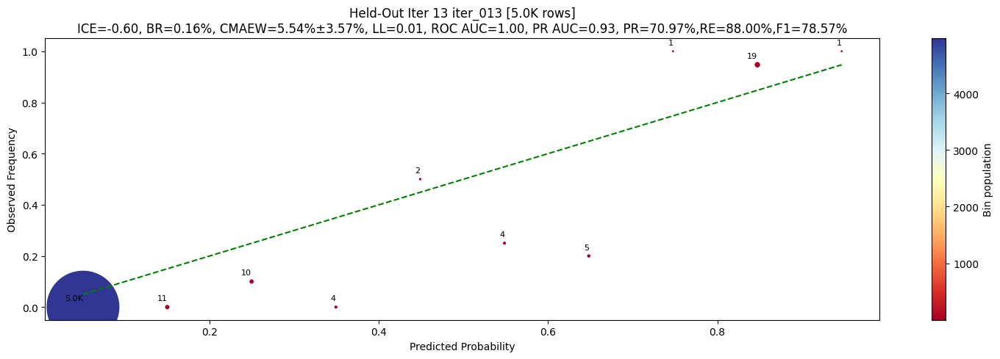

2025-12-22 16:13:24,437 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 16:13:47,257 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 16:25:57,638 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 16:25:57,968 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR636208400039468_MJD59031.3799, row=65801302, conf=0.9974


2025-12-22 16:25:58,115 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR384212200158760_MJD58317.28672, row=28425630, conf=0.9972


2025-12-22 16:25:58,306 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR758211400022438_MJD58231.22051, row=82889233, conf=0.9971


2025-12-22 16:25:58,579 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR539212400151759_MJD58334.19504, row=51615006, conf=0.9972


2025-12-22 16:25:58,827 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR489208400100243_MJD58340.20228, row=43859398, conf=0.9975


2025-12-22 16:25:59,061 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR592205200067084_MJD58344.1937, row=61866274, conf=0.9976


2025-12-22 16:25:59,379 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR385206100124154_MJD58293.3631, row=29409742, conf=0.9974


2025-12-22 16:25:59,816 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR769208200073318_MJD58466.09076, row=84416979, conf=0.9975


2025-12-22 16:26:00,056 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR540209200114018_MJD58342.21111, row=52785209, conf=0.9974


2025-12-22 16:26:00,344 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR686202400186322_MJD58346.1928, row=73939387, conf=0.9974


2025-12-22 16:26:00,612 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768208200088363_MJD58451.06895, row=83828620, conf=0.9973


2025-12-22 16:26:00,921 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768214400041753_MJD58451.07139, row=83913458, conf=0.9974


2025-12-22 16:26:01,214 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR831208400072230_MJD58776.2038, row=93800008, conf=0.9976


2025-12-22 16:26:01,489 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR541207400076823_MJD58342.20536, row=53611682, conf=0.9974


2025-12-22 16:26:01,770 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR336205400016164_MJD58667.36419, row=24277627, conf=0.9973


2025-12-22 16:26:02,050 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR685207400085214_MJD58345.19682, row=73060106, conf=0.9977


2025-12-22 16:26:02,380 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768206300077983_MJD58448.09697, row=83792057, conf=0.9977


2025-12-22 16:26:02,700 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR686205400089137_MJD58345.20059, row=74421442, conf=0.9974


2025-12-22 16:26:02,943 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR541206200079177_MJD58342.2063, row=53511684, conf=0.9973


2025-12-22 16:26:03,231 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR639210400128550_MJD58338.21389, row=67637282, conf=0.9976


2025-12-22 16:26:03,600 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 20, weight=0.80
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 16:26:06,121 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_013.parquet
2025-12-22 16:26:10,003 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 2475 reviewed)
2025-12-22 16:26:10,011 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=156.5, neg=2290.0
2025-12-22 16:26:10,015 - INFO - run-line:3212 - Building training data...
2025-12-22 16:26:10,042 - INFO - run-line:3216 - Retraining main model...
2025-12-22 16:27:54,119 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.950, neg<0.100
2025-12-22 16:27:54,210 - INFO - run-line:3244 - OOB metrics: recall=0.980, precision=0.995, coverage=90.93%
2025-12-22 

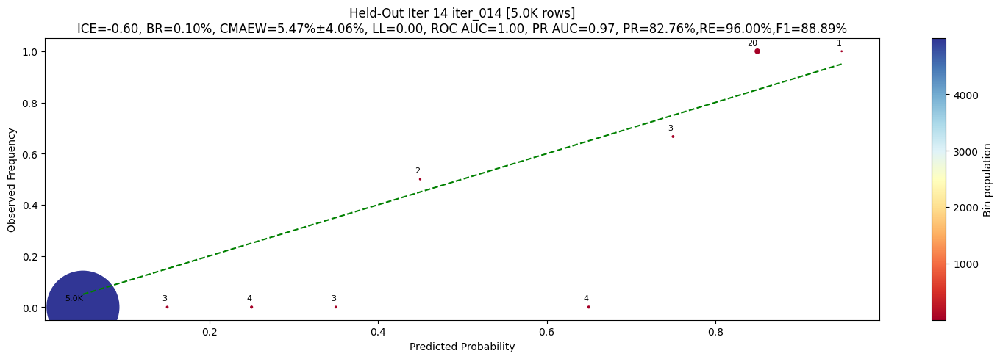

2025-12-22 16:27:59,264 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 16:28:26,165 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 16:39:33,534 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 16:39:33,860 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR487209100025366_MJD58644.36245, row=41549583, conf=0.9997


2025-12-22 16:39:34,192 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR806212200076503_MJD59032.39702, row=92665749, conf=0.9997


2025-12-22 16:39:34,559 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR439202400020757_MJD58662.36115, row=37815518, conf=0.9995


2025-12-22 16:39:34,919 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR382204200124282_MJD58639.33985, row=25397368, conf=0.9997


2025-12-22 16:39:35,320 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR686209200110397_MJD58345.19573, row=74860535, conf=0.9995


2025-12-22 16:39:35,689 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR489209200089521_MJD58340.19408, row=43917068, conf=0.9996


2025-12-22 16:39:36,007 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR662212200007194_MJD58794.33946, row=71473653, conf=0.9997


2025-12-22 16:39:36,285 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR334205100084431_MJD58319.28954, row=20755184, conf=0.9996


2025-12-22 16:39:36,583 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR333204200063719_MJD58313.25823, row=17855870, conf=0.9996


2025-12-22 16:39:36,921 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR592206200111744_MJD58344.19461, row=61877430, conf=0.9995


2025-12-22 16:39:37,242 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR639210200147568_MJD58337.2144, row=67534187, conf=0.9996


2025-12-22 16:39:37,544 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR737211300038866_MJD59043.39999, row=82214227, conf=0.9995


2025-12-22 16:39:37,827 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR591213400151124_MJD58343.19602, row=61720163, conf=0.9995


2025-12-22 16:39:38,170 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768206300085932_MJD58451.07208, row=83790961, conf=0.9995


2025-12-22 16:39:38,514 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR279206300136910_MJD58635.29941, row=1547267, conf=0.9996


2025-12-22 16:39:38,841 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR591206200163002_MJD58344.19293, row=61212155, conf=0.9995


2025-12-22 16:39:39,187 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR704203100027996_MJD58812.34031, row=76595367, conf=0.9996


2025-12-22 16:39:39,563 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR541208400054666_MJD58342.20624, row=53695282, conf=0.9996


2025-12-22 16:39:39,876 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR639212300075660_MJD58337.21339, row=67754178, conf=0.9995


2025-12-22 16:39:40,233 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR589213400119230_MJD58646.33946, row=59676465, conf=0.9995


2025-12-22 16:39:40,586 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 20, weight=0.80
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 16:39:42,906 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_014.parquet
2025-12-22 16:39:45,641 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 2595 reviewed)
2025-12-22 16:39:45,650 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=172.5, neg=2390.0
2025-12-22 16:39:45,655 - INFO - run-line:3212 - Building training data...
2025-12-22 16:39:45,683 - INFO - run-line:3216 - Retraining main model...
2025-12-22 16:41:20,523 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.950, neg<0.100
2025-12-22 16:41:20,614 - INFO - run-line:3244 - OOB metrics: recall=0.986, precision=0.991, coverage=89.41%
2025-12-22 

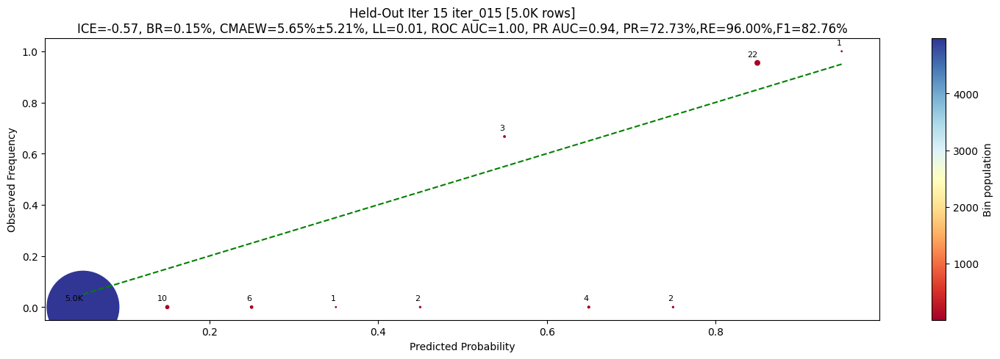

2025-12-22 16:41:24,881 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 16:41:45,937 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 16:53:27,106 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 16:53:27,419 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR487207400145468_MJD58644.36136, row=41507533, conf=0.9996


2025-12-22 16:53:27,612 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR260212400068194_MJD58493.29148, row=555952, conf=0.9996


2025-12-22 16:53:27,830 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR283205200130123_MJD58312.26884, row=6936505, conf=0.9996


2025-12-22 16:53:28,069 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR687204200044763_MJD58658.32547, row=75550317, conf=0.9994


2025-12-22 16:53:28,366 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR335202400070994_MJD58674.36835, row=23465672, conf=0.9997


2025-12-22 16:53:28,694 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR279206400164003_MJD58635.30076, row=1566135, conf=0.9995


2025-12-22 16:53:29,132 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR283205200177251_MJD58312.2693, row=6923268, conf=0.9996


2025-12-22 16:53:29,475 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR686206300183330_MJD58346.19265, row=74489797, conf=0.9996


2025-12-22 16:53:29,755 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR280206200102131_MJD58303.22825, row=2791074, conf=0.9997


2025-12-22 16:53:30,053 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR262213400041174_MJD58493.36218, row=877716, conf=0.9995


2025-12-22 16:53:30,488 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR806204200057230_MJD59032.39756, row=91773768, conf=0.9996


2025-12-22 16:53:30,801 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR832205200059877_MJD58775.21285, row=93837663, conf=0.9996


2025-12-22 16:53:31,142 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR309202400058676_MJD58464.34184, row=12445752, conf=0.9995


2025-12-22 16:53:31,433 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR434209400094141_MJD58641.3409, row=33210487, conf=0.9995


2025-12-22 16:53:31,750 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR637212200050234_MJD58657.27876, row=66100613, conf=0.9995


2025-12-22 16:53:32,100 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR803216200059841_MJD58468.09247, row=89077614, conf=0.9995


2025-12-22 16:53:32,397 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR807209100056857_MJD58475.19584, row=93194008, conf=0.9995


2025-12-22 16:53:32,677 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR439212400011265_MJD58662.36209, row=37830194, conf=0.9995


2025-12-22 16:53:32,951 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR434209400103999_MJD58641.33955, row=33211659, conf=0.9996


2025-12-22 16:53:33,308 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR284207300092616_MJD58286.35077, row=10693726, conf=0.9996


2025-12-22 16:53:33,579 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 20, weight=0.80
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 16:53:35,477 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_015.parquet
2025-12-22 16:53:38,325 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 2715 reviewed)
2025-12-22 16:53:38,332 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=188.5, neg=2490.0
2025-12-22 16:53:38,335 - INFO - run-line:3212 - Building training data...
2025-12-22 16:53:38,370 - INFO - run-line:3216 - Retraining main model...
2025-12-22 16:55:14,421 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.950, neg<0.100
2025-12-22 16:55:14,426 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
202

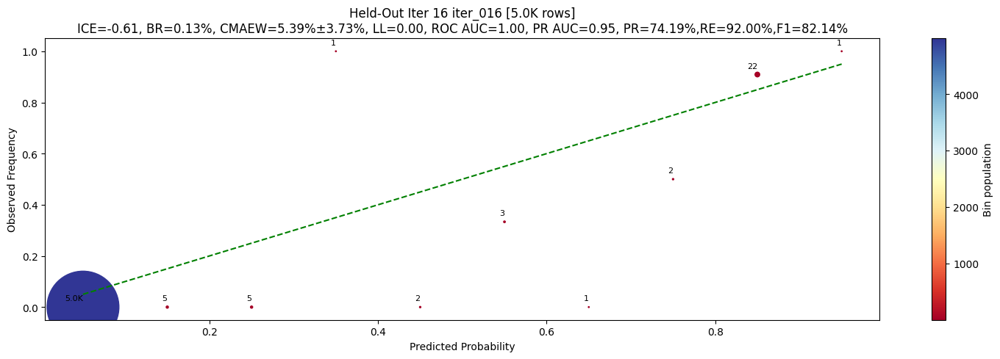

2025-12-22 16:55:47,128 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 16:56:09,446 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 17:06:48,961 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 17:06:49,279 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768214400067690_MJD58448.09622, row=83913033, conf=0.9993


2025-12-22 17:06:49,449 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR538206200090929_MJD58334.1954, row=49770919, conf=0.9993


2025-12-22 17:06:49,635 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR589201300104577_MJD58646.33942, row=59580753, conf=0.9994


2025-12-22 17:06:49,932 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR331210100133672_MJD58306.23789, row=15317483, conf=0.9994


2025-12-22 17:06:50,199 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR831212400011617_MJD58776.21229, row=93811983, conf=0.9994


2025-12-22 17:06:50,484 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR335206400066764_MJD58674.36742, row=23623980, conf=0.9994


2025-12-22 17:06:50,798 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR333204300128563_MJD58313.25823, row=17866743, conf=0.9994


2025-12-22 17:06:51,056 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR279209400170935_MJD58635.30165, row=1722531, conf=0.9994


2025-12-22 17:06:51,301 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR487212200140212_MJD58644.36134, row=41750502, conf=0.9994


2025-12-22 17:06:51,561 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR852204400035951_MJD59036.39659, row=93965349, conf=0.9994


2025-12-22 17:06:51,868 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR380209400004733_MJD59046.23606, row=24810597, conf=0.9994


2025-12-22 17:06:52,176 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR487212400157400_MJD58644.36179, row=41759719, conf=0.9995


2025-12-22 17:06:52,399 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR284212200159263_MJD58287.35461, row=11538546, conf=0.9994


2025-12-22 17:06:52,628 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR568214300017217_MJD58796.44096, row=59344277, conf=0.9993


2025-12-22 17:06:52,858 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR486206400067112_MJD58643.36152, row=40654567, conf=0.9994


2025-12-22 17:06:53,150 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR690202300023691_MJD58660.35786, row=76529998, conf=0.9994


2025-12-22 17:06:53,500 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR439201300033264_MJD58662.3611, row=37813853, conf=0.9994


2025-12-22 17:06:53,847 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR684204200030325_MJD58300.23558, row=72024467, conf=0.9994


2025-12-22 17:06:54,116 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR686205400078361_MJD58346.19462, row=74423505, conf=0.9993


2025-12-22 17:06:54,421 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR686212400144864_MJD58346.1924, row=75229907, conf=0.9994


2025-12-22 17:06:54,677 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 20, weight=0.80
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 17:06:56,664 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_016.parquet
2025-12-22 17:06:59,672 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 2835 reviewed)
2025-12-22 17:06:59,679 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=204.5, neg=2590.0
2025-12-22 17:06:59,682 - INFO - run-line:3212 - Building training data...
2025-12-22 17:06:59,706 - INFO - run-line:3216 - Retraining main model...
2025-12-22 17:08:13,618 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.950, neg<0.100
2025-12-22 17:08:13,695 - INFO - run-line:3244 - OOB metrics: recall=0.981, precision=0.992, coverage=91.13%
2025-12-22 

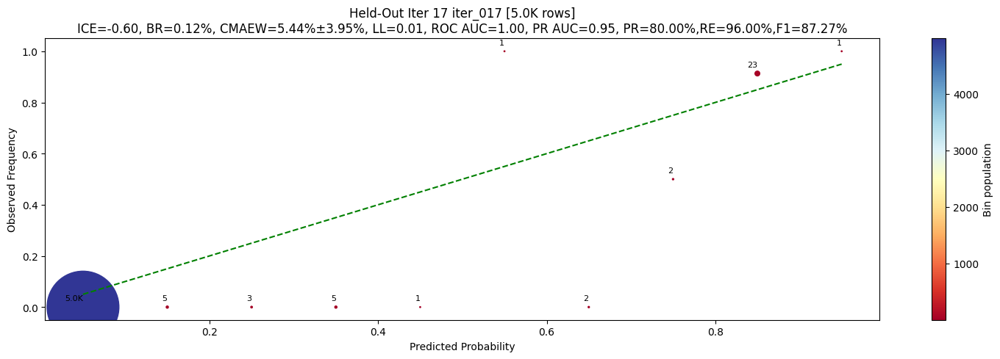

2025-12-22 17:08:17,970 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 17:08:38,721 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 17:18:54,051 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 17:18:54,428 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR685213400089275_MJD58345.194, row=73592791, conf=0.9997


2025-12-22 17:18:54,826 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR805213400010678_MJD58476.11386, row=91306652, conf=0.9998


2025-12-22 17:18:55,138 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR803204200097819_MJD58468.09447, row=88953732, conf=0.9997


2025-12-22 17:18:55,473 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR284209100038227_MJD58287.35441, row=11025482, conf=0.9997


2025-12-22 17:18:55,740 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR541209100065808_MJD58342.20445, row=53711378, conf=0.9997


2025-12-22 17:18:56,052 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR284204200108915_MJD58286.35127, row=10260441, conf=0.9997


2025-12-22 17:18:56,323 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR331208400188968_MJD58305.23706, row=15039786, conf=0.9998


2025-12-22 17:18:56,615 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR334212200013770_MJD58319.28845, row=22516724, conf=0.9997


2025-12-22 17:18:56,957 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR541206200104277_MJD58342.20448, row=53507378, conf=0.9997


2025-12-22 17:18:57,247 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR330216400048591_MJD58289.27628, row=13534127, conf=0.9997


2025-12-22 17:18:57,556 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR541210400094820_MJD58342.20539, row=53826248, conf=0.9997


2025-12-22 17:18:57,841 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR772210200023252_MJD58649.39672, row=85599085, conf=0.9997


2025-12-22 17:18:58,144 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR283213400190360_MJD58311.26944, row=8914114, conf=0.9997


2025-12-22 17:18:58,447 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR331212100178701_MJD58305.23746, row=15771328, conf=0.9997


2025-12-22 17:18:58,735 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR382208400112950_MJD58639.33982, row=25587472, conf=0.9997


2025-12-22 17:18:59,022 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR283206400160185_MJD58312.27201, row=7303455, conf=0.9997


2025-12-22 17:18:59,287 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR385202400133527_MJD58291.36229, row=28991535, conf=0.9997


2025-12-22 17:18:59,606 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR411213400046227_MJD58456.29797, row=31822272, conf=0.9997


2025-12-22 17:18:59,905 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR309209200055037_MJD58464.3393, row=12497861, conf=0.9997


2025-12-22 17:19:00,211 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768214400055438_MJD58448.09622, row=83914739, conf=0.9997


2025-12-22 17:19:00,496 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 20, weight=0.80
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 17:19:02,735 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_017.parquet
2025-12-22 17:19:05,673 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 2955 reviewed)
2025-12-22 17:19:05,683 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=220.5, neg=2690.0
2025-12-22 17:19:05,687 - INFO - run-line:3212 - Building training data...
2025-12-22 17:19:05,727 - INFO - run-line:3216 - Retraining main model...
2025-12-22 17:20:13,394 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.950, neg<0.100
2025-12-22 17:20:13,475 - INFO - run-line:3244 - OOB metrics: recall=0.985, precision=1.000, coverage=89.05%
2025-12-22 

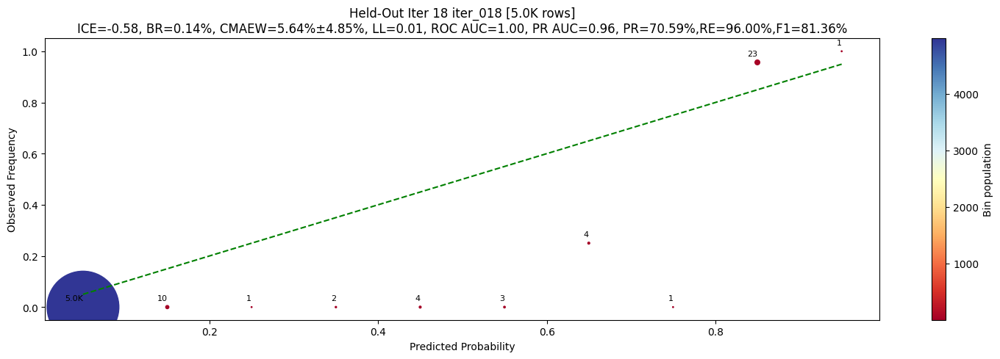

2025-12-22 17:20:18,362 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 17:20:39,142 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 17:29:38,653 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 17:29:38,990 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR485208400058907_MJD58642.32068, row=40155498, conf=0.9989


2025-12-22 17:29:39,241 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR382212300081202_MJD58639.3416, row=25694262, conf=0.9990


2025-12-22 17:29:39,527 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768214400053485_MJD58451.06854, row=83913572, conf=0.9983


2025-12-22 17:29:39,843 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR260212200073103_MJD58493.29059, row=543857, conf=0.9988


2025-12-22 17:29:40,164 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR309207100051216_MJD58464.3859, row=12479435, conf=0.9990


2025-12-22 17:29:40,447 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR285210400038891_MJD58666.36131, row=12332900, conf=0.9988


2025-12-22 17:29:40,757 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR589202400143069_MJD58646.33945, row=59599006, conf=0.9989


2025-12-22 17:29:41,027 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR536206200018533_MJD59018.40579, row=48280204, conf=0.9988


2025-12-22 17:29:41,318 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR766205100052523_MJD58294.39884, row=83010286, conf=0.9989


2025-12-22 17:29:41,606 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR686210400115107_MJD58346.19348, row=74952490, conf=0.9991


2025-12-22 17:29:41,951 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR538208200069710_MJD58334.19425, row=50009299, conf=0.9990


2025-12-22 17:29:42,236 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR685206400015403_MJD58346.19187, row=72966914, conf=0.9989


2025-12-22 17:29:42,537 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR806206400012541_MJD58473.09603, row=92005117, conf=0.9986


2025-12-22 17:29:42,856 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR638209200104482_MJD58338.21311, row=66622733, conf=0.9990


2025-12-22 17:29:43,198 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR279209200161676_MJD58635.30121, row=1695927, conf=0.9991


2025-12-22 17:29:43,490 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR283205200177251_MJD58311.27399, row=6957665, conf=0.9990


2025-12-22 17:29:43,831 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR639211400163303_MJD58337.21351, row=67702641, conf=0.9988


2025-12-22 17:29:44,109 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR432214100036196_MJD59014.40461, row=32779935, conf=0.9989


2025-12-22 17:29:44,435 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR536204100034180_MJD59018.40448, row=48272238, conf=0.9989


2025-12-22 17:29:44,851 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR279213400112782_MJD58635.30346, row=1876330, conf=0.9988


2025-12-22 17:29:45,154 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 20, weight=0.80
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 17:29:47,819 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_018.parquet
2025-12-22 17:29:50,422 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 3075 reviewed)
2025-12-22 17:29:50,431 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=236.5, neg=2790.0
2025-12-22 17:29:50,435 - INFO - run-line:3212 - Building training data...
2025-12-22 17:29:50,463 - INFO - run-line:3216 - Retraining main model...
2025-12-22 17:30:08,987 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.950, neg<0.100
2025-12-22 17:30:09,066 - INFO - run-line:3244 - OOB metrics: recall=0.997, precision=0.993, coverage=90.30%
2025-12-22 

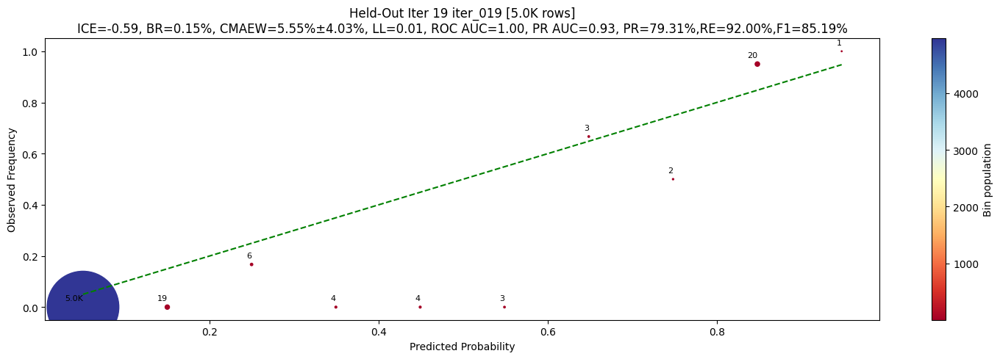

2025-12-22 17:30:13,811 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 17:30:32,693 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 17:39:19,232 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 17:39:19,540 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR565214300013907_MJD58795.33931, row=58101982, conf=0.9986


2025-12-22 17:39:19,836 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768209200103259_MJD58451.06956, row=83846379, conf=0.9987


2025-12-22 17:39:20,187 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR767206300106405_MJD58451.06915, row=83295388, conf=0.9987


2025-12-22 17:39:20,534 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768208400054113_MJD58451.07179, row=83835855, conf=0.9988


2025-12-22 17:39:20,846 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR767209200092586_MJD58451.07041, row=83398828, conf=0.9986


2025-12-22 17:39:21,199 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR591206400137820_MJD58344.19303, row=61282007, conf=0.9987


2025-12-22 17:39:21,569 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR591212400148926_MJD58343.19402, row=61681840, conf=0.9986


2025-12-22 17:39:21,888 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR284202300113356_MJD58286.35209, row=10059032, conf=0.9987


2025-12-22 17:39:22,214 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR334213400083222_MJD58319.28859, row=22751028, conf=0.9986


2025-12-22 17:39:22,535 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR589202400139969_MJD58646.33993, row=59596699, conf=0.9986


2025-12-22 17:39:22,813 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR769206100084392_MJD58466.09112, row=84281390, conf=0.9986


2025-12-22 17:39:23,145 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR279206400129681_MJD58635.29986, row=1568704, conf=0.9986


2025-12-22 17:39:23,557 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR689212400054396_MJD58449.0693, row=76413418, conf=0.9987


2025-12-22 17:39:23,835 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768206300047381_MJD58451.07023, row=83792872, conf=0.9986


2025-12-22 17:39:24,140 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR771212300035053_MJD58461.14826, row=85445224, conf=0.9986


2025-12-22 17:39:24,418 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR803204100050069_MJD58468.09233, row=88949855, conf=0.9986


2025-12-22 17:39:24,751 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR383205200117459_MJD58638.38273, row=25926095, conf=0.9986


2025-12-22 17:39:25,020 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR685206200091711_MJD58345.19588, row=72918107, conf=0.9987


2025-12-22 17:39:25,296 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR541205400087100_MJD58342.2046, row=53478013, conf=0.9986


2025-12-22 17:39:25,626 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR540209400160863_MJD58342.20378, row=52856056, conf=0.9986


2025-12-22 17:39:25,881 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 20, weight=0.80
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 17:39:28,349 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_019.parquet
2025-12-22 17:39:31,032 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 3195 reviewed)
2025-12-22 17:39:31,040 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=252.5, neg=2890.0
2025-12-22 17:39:31,043 - INFO - run-line:3212 - Building training data...
2025-12-22 17:39:31,072 - INFO - run-line:3216 - Retraining main model...
2025-12-22 17:41:10,471 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.950, neg<0.100
2025-12-22 17:41:10,550 - INFO - run-line:3244 - OOB metrics: recall=0.978, precision=0.997, coverage=90.88%
2025-12-22 

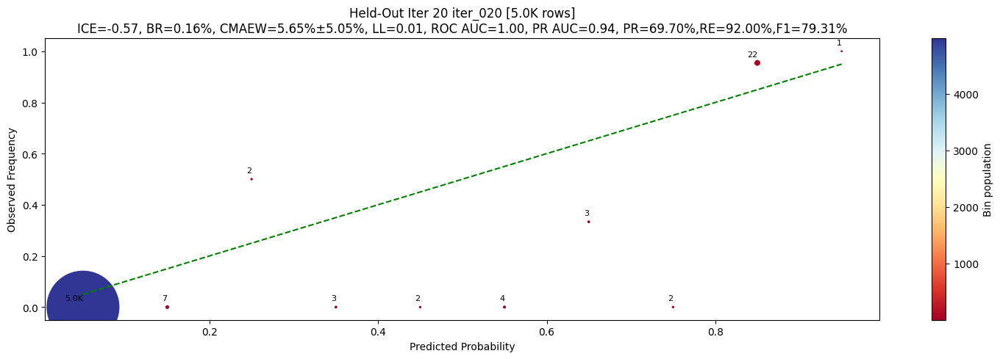

2025-12-22 17:41:14,775 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 17:41:36,351 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 17:50:05,162 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 17:50:05,485 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR541213400064188_MJD58342.20443, row=54172224, conf=0.9995


2025-12-22 17:50:05,773 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR284205400085764_MJD58286.35061, row=10478861, conf=0.9995


2025-12-22 17:50:06,070 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR336204200050097_MJD58667.36254, row=24275784, conf=0.9996


2025-12-22 17:50:06,434 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR485210200049153_MJD58642.32187, row=40199728, conf=0.9995


2025-12-22 17:50:06,789 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR683202400041018_MJD58322.29464, row=71926493, conf=0.9996


2025-12-22 17:50:07,109 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR489210100070352_MJD58340.19494, row=44002020, conf=0.9995


2025-12-22 17:50:07,422 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR769209200066369_MJD58466.09133, row=84498970, conf=0.9995


2025-12-22 17:50:07,721 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR539210200159688_MJD58334.1961, row=51302057, conf=0.9995


2025-12-22 17:50:07,991 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR767212300052810_MJD58448.09569, row=83527470, conf=0.9995


2025-12-22 17:50:08,320 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR335206400055591_MJD58674.36742, row=23624688, conf=0.9996


2025-12-22 17:50:08,590 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR830206100069868_MJD58777.21209, row=93626695, conf=0.9995


2025-12-22 17:50:08,937 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR279210400101254_MJD58635.30031, row=1776050, conf=0.9995


2025-12-22 17:50:09,246 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768204200087788_MJD58451.07169, row=83711607, conf=0.9995


2025-12-22 17:50:09,532 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR803216400108762_MJD58468.09297, row=89081396, conf=0.9995


2025-12-22 17:50:09,852 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR767209200071052_MJD58451.06852, row=83398044, conf=0.9995


2025-12-22 17:50:10,152 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR360210300043032_MJD58491.26767, row=24660499, conf=0.9995


2025-12-22 17:50:10,453 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR683206100045514_MJD58322.29445, row=71939853, conf=0.9995


2025-12-22 17:50:10,760 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR589213200066953_MJD58646.3394, row=59673952, conf=0.9995


2025-12-22 17:50:11,076 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR685207400090528_MJD58345.19682, row=73049755, conf=0.9995


2025-12-22 17:50:11,425 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR438212300088048_MJD58669.33977, row=37730150, conf=0.9995


2025-12-22 17:50:11,743 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 20, weight=0.80
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 17:50:13,732 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_020.parquet
2025-12-22 17:50:16,287 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 3315 reviewed)
2025-12-22 17:50:16,294 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=268.5, neg=2990.0
2025-12-22 17:50:16,297 - INFO - run-line:3212 - Building training data...
2025-12-22 17:50:16,325 - INFO - run-line:3216 - Retraining main model...
2025-12-22 17:51:53,096 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.950, neg<0.100
2025-12-22 17:51:53,101 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
202

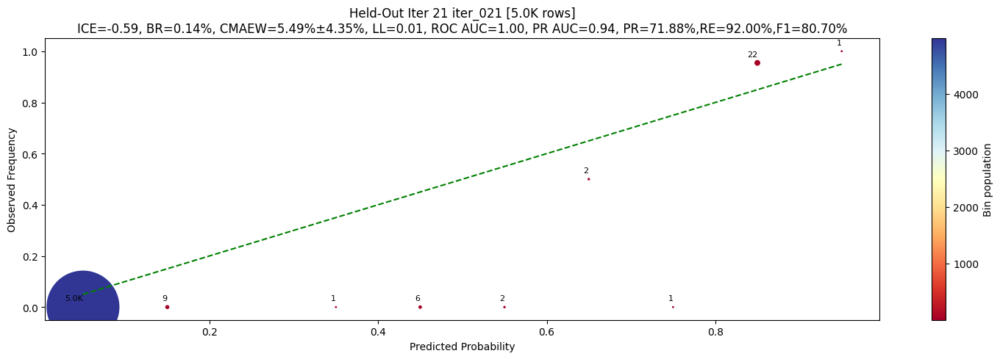

2025-12-22 17:52:24,261 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 17:52:45,431 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 18:01:07,677 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 18:01:08,004 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR260205400075314_MJD58493.28948, row=434098, conf=0.9990


2025-12-22 18:01:08,404 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR311204400045006_MJD58494.31482, row=12666747, conf=0.9990


2025-12-22 18:01:08,764 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR767213400080931_MJD58451.06956, row=83562296, conf=0.9986


2025-12-22 18:01:09,069 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR772209200038455_MJD58776.3393, row=85594973, conf=0.9991


2025-12-22 18:01:09,330 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR280210400059489_MJD58303.22737, row=3585100, conf=0.9990


2025-12-22 18:01:09,579 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR772201400027942_MJD58776.33913, row=85570170, conf=0.9988


2025-12-22 18:01:09,771 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR541213400080675_MJD58341.26192, row=54164511, conf=0.9989


2025-12-22 18:01:09,938 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR260210200050794_MJD58476.33832, row=514981, conf=0.9990


2025-12-22 18:01:10,191 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR284209100038227_MJD58286.35061, row=11015014, conf=0.9989


2025-12-22 18:01:10,427 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR733210100003923_MJD58648.37928, row=82150683, conf=0.9989


2025-12-22 18:01:10,671 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR489210200109196_MJD58340.19402, row=44004339, conf=0.9989


2025-12-22 18:01:10,916 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR637212200033463_MJD58657.2765, row=66100692, conf=0.9989


2025-12-22 18:01:11,202 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR280210200176221_MJD58303.23236, row=3497597, conf=0.9989


2025-12-22 18:01:11,428 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR279201400121679_MJD58635.29937, row=1088764, conf=0.9989


2025-12-22 18:01:11,660 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR438210200035523_MJD58669.33964, row=37668431, conf=0.9990


2025-12-22 18:01:11,945 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR284202300102647_MJD58286.35071, row=10051792, conf=0.9990


2025-12-22 18:01:12,228 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR385206400135494_MJD58292.36259, row=29497373, conf=0.9990


2025-12-22 18:01:12,505 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR537204200062489_MJD58665.36118, row=48411900, conf=0.9990


2025-12-22 18:01:12,796 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768208200009334_MJD58451.06805, row=83830581, conf=0.9989


2025-12-22 18:01:13,131 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR284205200100355_MJD58286.35064, row=10434475, conf=0.9989


2025-12-22 18:01:13,426 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 20, weight=0.80
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 18:01:15,574 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_021.parquet
2025-12-22 18:01:19,053 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 3435 reviewed)
2025-12-22 18:01:19,060 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=284.5, neg=3090.0
2025-12-22 18:01:19,064 - INFO - run-line:3212 - Building training data...
2025-12-22 18:01:19,090 - INFO - run-line:3216 - Retraining main model...
2025-12-22 18:02:59,558 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.950, neg<0.100
2025-12-22 18:02:59,641 - INFO - run-line:3244 - OOB metrics: recall=0.991, precision=0.994, coverage=90.39%
2025-12-22 

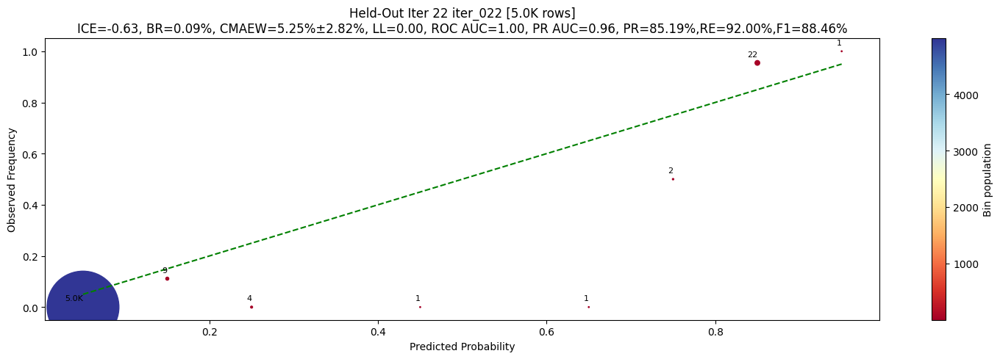

2025-12-22 18:03:04,395 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 18:03:26,297 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 18:14:41,254 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 18:14:41,729 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR733207400019437_MJD58648.37691, row=82145649, conf=0.9998


2025-12-22 18:14:42,097 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR438213400049776_MJD58669.34091, row=37753997, conf=0.9998


2025-12-22 18:14:42,428 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768206300080927_MJD58451.07115, row=83790908, conf=0.9998


2025-12-22 18:14:42,762 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR852210100022194_MJD59036.39592, row=93974710, conf=0.9997


2025-12-22 18:14:43,118 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR638202400092825_MJD58337.21395, row=66281658, conf=0.9998


2025-12-22 18:14:43,469 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR615205200000282_MJD58797.34925, row=65050561, conf=0.9997


2025-12-22 18:14:43,776 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR282210200151412_MJD58308.2584, row=5564055, conf=0.9997


2025-12-22 18:14:44,086 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR769201400063813_MJD58466.09108, row=83983136, conf=0.9998


2025-12-22 18:14:44,423 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR686205400047199_MJD58345.195, row=74422464, conf=0.9998


2025-12-22 18:14:44,774 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR591212400096303_MJD58344.19648, row=61680921, conf=0.9998


2025-12-22 18:14:45,103 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR257213100010905_MJD58471.32084, row=53311, conf=0.9996


2025-12-22 18:14:45,447 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR806213300000987_MJD59032.39831, row=92814218, conf=0.9997


2025-12-22 18:14:45,713 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR638202400092828_MJD58337.21302, row=66282750, conf=0.9997


2025-12-22 18:14:46,038 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768214400055193_MJD58451.07422, row=83915350, conf=0.9998


2025-12-22 18:14:46,323 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR686205400075729_MJD58345.19964, row=74420677, conf=0.9997


2025-12-22 18:14:46,644 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768214400071774_MJD58451.06854, row=83913412, conf=0.9997


2025-12-22 18:14:47,019 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR541204200088853_MJD58342.2099, row=53389118, conf=0.9997


2025-12-22 18:14:47,338 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR639205200084353_MJD58338.21486, row=67152714, conf=0.9997


2025-12-22 18:14:47,654 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR591201300118224_MJD58343.19718, row=60879678, conf=0.9997


2025-12-22 18:14:47,959 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR638202300133481_MJD58338.21421, row=66273468, conf=0.9997


2025-12-22 18:14:48,256 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 20, weight=0.80
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 18:14:50,996 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_022.parquet
2025-12-22 18:14:53,907 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 3555 reviewed)
2025-12-22 18:14:53,914 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=300.5, neg=3190.0
2025-12-22 18:14:53,917 - INFO - run-line:3212 - Building training data...
2025-12-22 18:14:53,946 - INFO - run-line:3216 - Retraining main model...
2025-12-22 18:15:11,929 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.950, neg<0.100
2025-12-22 18:15:12,008 - INFO - run-line:3244 - OOB metrics: recall=0.989, precision=0.997, coverage=90.74%
2025-12-22 

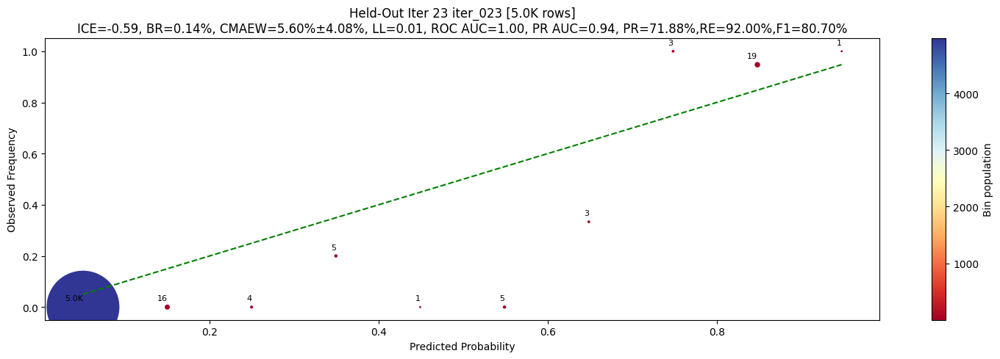

2025-12-22 18:15:16,045 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 18:15:35,695 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 18:24:36,688 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 18:24:37,022 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR688205400062497_MJD58449.06867, row=75744099, conf=0.9986


2025-12-22 18:24:37,324 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR485211400048199_MJD58642.31968, row=40230544, conf=0.9986


2025-12-22 18:24:37,673 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR689201300006087_MJD58449.07147, row=76144447, conf=0.9986


2025-12-22 18:24:37,961 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR639216200076119_MJD58338.20738, row=68079666, conf=0.9986


2025-12-22 18:24:38,181 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR801206100060849_MJD58652.35528, row=88631236, conf=0.9986


2025-12-22 18:24:38,435 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR683205200048143_MJD58323.29711, row=71936407, conf=0.9986


2025-12-22 18:24:38,624 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR769213400099598_MJD58466.09232, row=84733365, conf=0.9987


2025-12-22 18:24:38,823 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR335201300040002_MJD58674.36743, row=23431414, conf=0.9986


2025-12-22 18:24:39,159 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR683205200004801_MJD58322.29446, row=71935689, conf=0.9986


2025-12-22 18:24:39,441 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR642210200047901_MJD58661.35784, row=69189036, conf=0.9986


2025-12-22 18:24:39,800 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR803206300067143_MJD58468.09262, row=88978485, conf=0.9986


2025-12-22 18:24:40,148 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR831209200025841_MJD58776.21264, row=93800953, conf=0.9986


2025-12-22 18:24:40,447 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR334210200182714_MJD58319.28854, row=22008536, conf=0.9986


2025-12-22 18:24:40,691 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR637201300066402_MJD58657.27632, row=65846062, conf=0.9986


2025-12-22 18:24:41,072 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR336209200049419_MJD58667.36283, row=24283988, conf=0.9986


2025-12-22 18:24:41,457 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR333204100089236_MJD58313.25827, row=17831849, conf=0.9985


2025-12-22 18:24:41,807 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR832210400050852_MJD58775.2132, row=93871492, conf=0.9986


2025-12-22 18:24:42,053 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR591206400106526_MJD58343.19428, row=61271748, conf=0.9986


2025-12-22 18:24:42,390 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR685206400097779_MJD58345.19411, row=72956397, conf=0.9986


2025-12-22 18:24:42,691 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR279206200137497_MJD58635.29941, row=1530613, conf=0.9986


2025-12-22 18:24:42,930 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 20, weight=0.80
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 18:24:44,553 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_023.parquet
2025-12-22 18:24:47,427 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 3675 reviewed)
2025-12-22 18:24:47,434 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=316.5, neg=3290.0
2025-12-22 18:24:47,438 - INFO - run-line:3212 - Building training data...
2025-12-22 18:24:47,465 - INFO - run-line:3216 - Retraining main model...
2025-12-22 18:25:04,767 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.950, neg<0.100
2025-12-22 18:25:04,856 - INFO - run-line:3244 - OOB metrics: recall=0.992, precision=0.995, coverage=90.23%
2025-12-22 

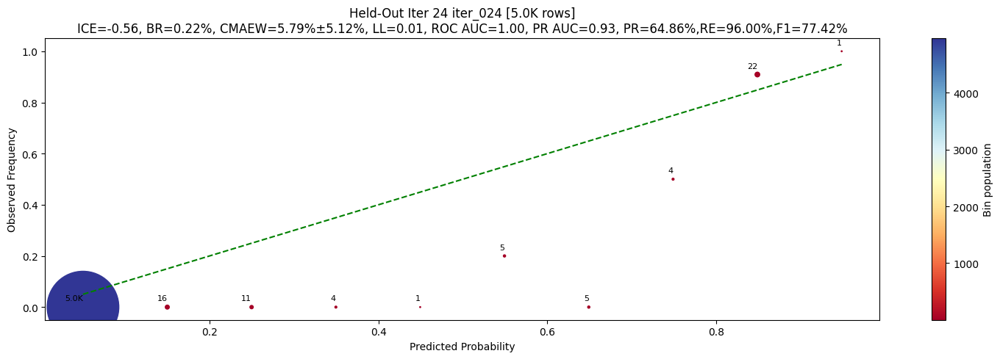

2025-12-22 18:25:09,337 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 18:25:27,656 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 18:34:07,214 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 18:34:07,547 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR280210200068399_MJD58303.23236, row=3497544, conf=0.9982


2025-12-22 18:34:07,795 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR588216400032276_MJD58645.33821, row=59572098, conf=0.9983


2025-12-22 18:34:08,076 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR772208100022573_MJD58649.39704, row=85590982, conf=0.9987


2025-12-22 18:34:08,396 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR281212200171255_MJD58636.3427, row=4711069, conf=0.9986


2025-12-22 18:34:08,732 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR311204400062562_MJD58494.31482, row=12666547, conf=0.9987


2025-12-22 18:34:09,074 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR689208400031925_MJD58449.06832, row=76304525, conf=0.9987


2025-12-22 18:34:09,375 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR591212400142749_MJD58343.19402, row=61680203, conf=0.9986


2025-12-22 18:34:09,703 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR689206300041601_MJD58449.07136, row=76235912, conf=0.9987


2025-12-22 18:34:10,020 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR592210400101369_MJD58344.20205, row=61983534, conf=0.9986


2025-12-22 18:34:10,285 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768216200002744_MJD58451.0692, row=83930794, conf=0.9987


2025-12-22 18:34:10,565 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR588212200032521_MJD58645.34508, row=59563310, conf=0.9987


2025-12-22 18:34:10,841 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR331210200152241_MJD58304.23699, row=15399401, conf=0.9987


2025-12-22 18:34:11,143 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR766206200047343_MJD58295.39352, row=83024325, conf=0.9986


2025-12-22 18:34:11,437 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR831206300036257_MJD58776.21262, row=93791869, conf=0.9987


2025-12-22 18:34:11,724 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR591201400074467_MJD58344.19503, row=60896629, conf=0.9986


2025-12-22 18:34:12,000 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR434209400098134_MJD58641.33954, row=33212245, conf=0.9985


2025-12-22 18:34:12,320 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR489206300119002_MJD58340.19412, row=43466011, conf=0.9987


2025-12-22 18:34:12,676 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR489206400117106_MJD58340.19413, row=43490411, conf=0.9987


2025-12-22 18:34:13,041 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR767209400118160_MJD58451.08271, row=83424134, conf=0.9987


2025-12-22 18:34:13,385 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR488208400167676_MJD58340.19318, row=42560951, conf=0.9986


2025-12-22 18:34:13,651 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 20, weight=0.80
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 18:34:16,483 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_024.parquet
2025-12-22 18:34:19,625 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 3795 reviewed)
2025-12-22 18:34:19,632 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=332.5, neg=3390.0
2025-12-22 18:34:19,636 - INFO - run-line:3212 - Building training data...
2025-12-22 18:34:19,667 - INFO - run-line:3216 - Retraining main model...
2025-12-22 18:34:37,321 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.950, neg<0.100
2025-12-22 18:34:37,395 - INFO - run-line:3244 - OOB metrics: recall=0.988, precision=0.995, coverage=89.96%
2025-12-22 

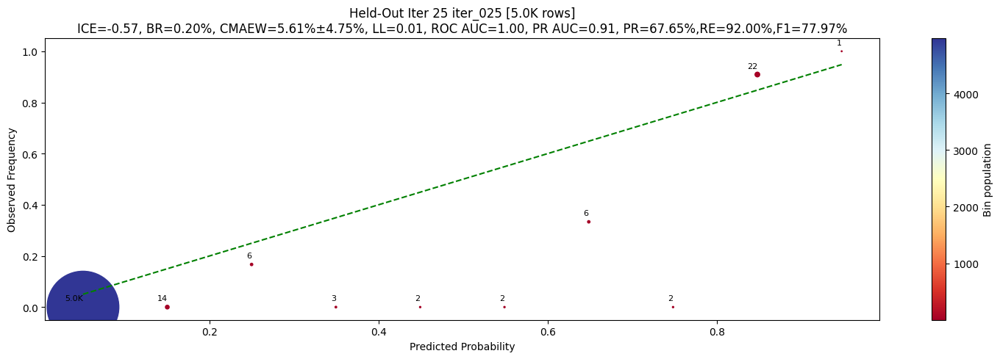

2025-12-22 18:34:41,702 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 18:34:58,398 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

In [ ]:
from os.path import join
from active_learning_pipeline import run_active_learning_pipeline

# setup_logging(level=logging.INFO)

# Run pipeline
results = run_active_learning_pipeline(
    unlabeled_samples=big_features,
    known_flares=oos_features,
    output_dir=join(r"R:\Data\Astronomy", "active_learning_output"),
    unlabeled_dataset=dataset["target"],
    known_flares_dataset=dataset["test"],
)

In [ ]:
from os.path import join
from active_learning_pipeline import run_active_learning_pipeline

# setup_logging(level=logging.INFO)

# Run pipeline
results = run_active_learning_pipeline(
    unlabeled_samples=big_features,
    known_flares=oos_features,
    output_dir=join(r"R:\Data\Astronomy", "active_learning_output"),
    unlabeled_dataset=dataset["target"],
    known_flares_dataset=dataset["test"],
    freaky_held_out_indices=freaky_held_out_indices,
)

2025-12-23 11:06:36,923 - INFO - __init__-line:1786 - Output directory: R:\Data\Astronomy\active_learning_output_20251223_110636
2025-12-23 11:06:36,926 - INFO - _validate_inputs-line:1901 - unlabeled_samples: 94,028,217 samples
2025-12-23 11:06:36,931 - INFO - _validate_inputs-line:1902 - known_flares: 99 known flares
2025-12-23 11:06:36,933 - INFO - __init__-line:1796 - Using 75 feature columns
2025-12-23 11:06:36,938 - INFO - __init__-line:1840 - Tracking positive row index 55554273
2025-12-23 11:06:36,941 - INFO - __init__-line:1847 - Tracking negative row index 83251304
2025-12-23 11:06:36,945 - INFO - __init__-line:1875 - Freaky held-out indices: 20 samples will be excluded from split and reported separately
2025-12-23 11:06:36,949 - INFO - initialize-line:2599 - ============================================================
2025-12-23 11:06:36,952 - INFO - initialize-line:2600 - PHASE 0: INITIALIZATION
2025-12-23 11:06:36,956 - INFO - initialize-line:2601 - =======================

Bootstrap models:   0%|          | 0/3 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/3 [00:00<?, ?it/s]

2025-12-23 11:34:19,029 - INFO - _pseudo_label_negatives-line:3205 - Pseudo-negatives added: 10000, weight=0.90
2025-12-23 11:34:20,277 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR767206100019391_MJD58448.0979, row=83276787, conf=1.0000


2025-12-23 11:34:25,027 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR768206400094342_MJD58448.09607, row=83797929, conf=1.0000


2025-12-23 11:34:25,347 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR432214100034225_MJD59014.40416, row=32780119, conf=0.9999


2025-12-23 11:34:25,656 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR538205100128026_MJD58334.19922, row=49473827, conf=0.9999


2025-12-23 11:34:25,959 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR564207100010081_MJD58792.38169, row=56932758, conf=0.9999


2025-12-23 11:34:26,286 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR591201400078246_MJD58343.19629, row=60892719, conf=1.0000


2025-12-23 11:34:26,514 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR541205200078816_MJD58342.20823, row=53449966, conf=0.9999


2025-12-23 11:34:26,702 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR701203400024638_MJD58792.26306, row=76575056, conf=0.9999


2025-12-23 11:34:26,923 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR832210400050852_MJD58775.2132, row=93871492, conf=0.9997


2025-12-23 11:34:27,091 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR800206300051472_MJD58441.07789, row=88567179, conf=0.9999


2025-12-23 11:34:27,255 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR803216400108762_MJD58468.09297, row=89081396, conf=0.9999


2025-12-23 11:34:27,432 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR464202200034116_MJD58852.30919, row=39160606, conf=0.9998


2025-12-23 11:34:27,589 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR688206400089513_MJD58449.06851, row=75762508, conf=0.9999


2025-12-23 11:34:27,756 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR767207200066397_MJD58451.06905, row=83325614, conf=0.9999


2025-12-23 11:34:27,938 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR260208100017563_MJD58493.28958, row=473371, conf=0.9999


2025-12-23 11:34:28,113 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR591201400124334_MJD58344.19317, row=60898362, conf=0.9999


2025-12-23 11:34:28,260 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR592208400030991_MJD58343.19487, row=61952056, conf=0.9999


2025-12-23 11:34:28,442 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR485209200074779_MJD58642.32091, row=40175077, conf=1.0000


2025-12-23 11:34:28,619 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR666202400007070_MJD58524.26094, row=71872002, conf=1.0000


2025-12-23 11:34:28,770 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR686209200101088_MJD58345.1948, row=74863542, conf=0.9999


2025-12-23 11:34:28,939 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR489209200089521_MJD58340.19408, row=43917068, conf=0.9999


2025-12-23 11:34:29,188 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR772205100015789_MJD58649.39654, row=85579316, conf=0.9999


2025-12-23 11:34:29,527 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR538210100032869_MJD58334.19439, row=50180911, conf=0.9999


2025-12-23 11:34:29,933 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR686206100128225_MJD58345.19581, row=74436070, conf=0.9999


2025-12-23 11:34:30,218 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR687212400112174_MJD58658.32432, row=75602947, conf=0.9997


2025-12-23 11:34:30,453 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR591212400096303_MJD58344.19648, row=61680921, conf=0.9999


2025-12-23 11:34:30,641 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR729205400022878_MJD58437.07226, row=78884387, conf=1.0000


2025-12-23 11:34:30,824 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR541206400003924_MJD58342.20912, row=53540896, conf=1.0000


2025-12-23 11:34:30,963 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR768214400055193_MJD58451.07422, row=83915350, conf=0.9999


2025-12-23 11:34:31,101 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR487207400017156_MJD58644.36182, row=41509964, conf=0.9999


2025-12-23 11:34:31,239 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR412212400027889_MJD58457.35357, row=32010402, conf=0.9999


2025-12-23 11:34:31,420 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR806210400049537_MJD58473.09651, row=92465526, conf=0.9999


2025-12-23 11:34:31,839 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR486215300051610_MJD58643.36275, row=41348058, conf=0.9999


2025-12-23 11:34:32,218 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR258214100018083_MJD58487.27621, row=101527, conf=0.9999


2025-12-23 11:34:32,519 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR382208400119305_MJD58639.33981, row=25597099, conf=0.9999


2025-12-23 11:34:32,722 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR768214400042723_MJD58451.07706, row=83913816, conf=0.9999


2025-12-23 11:34:32,913 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR686205200140485_MJD58345.1958, row=74397015, conf=0.9999


2025-12-23 11:34:33,086 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR541210400098879_MJD58342.20907, row=53819910, conf=0.9999


2025-12-23 11:34:33,213 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR807209100015536_MJD58475.17117, row=93195182, conf=0.9999


2025-12-23 11:34:33,367 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR659213400011908_MJD58849.19409, row=70007556, conf=0.9999


2025-12-23 11:34:33,649 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR592209300059781_MJD58344.19366, row=61965414, conf=0.9999


2025-12-23 11:34:33,967 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR367203200004790_MJD58522.24026, row=24748857, conf=0.9999


2025-12-23 11:34:34,192 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR704203100027996_MJD58812.34031, row=76595367, conf=0.9999


2025-12-23 11:34:34,562 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR767205200085687_MJD58448.0961, row=83251304, conf=0.9999


2025-12-23 11:34:34,791 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR439206300047526_MJD58662.36115, row=37820991, conf=0.9998


2025-12-23 11:34:35,100 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR410210100030608_MJD58812.44892, row=31587544, conf=0.9999


2025-12-23 11:34:35,407 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR662212200032061_MJD58794.33766, row=71473925, conf=0.9998


2025-12-23 11:34:35,594 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR685206300068080_MJD58345.19503, row=72943322, conf=0.9998


2025-12-23 11:34:35,832 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR771205200039849_MJD58461.14873, row=85295878, conf=0.9999


2025-12-23 11:34:36,085 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR360201300022332_MJD58491.30853, row=24537055, conf=0.9998


2025-12-23 11:34:36,273 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR638206100071499_MJD58338.21314, row=66463640, conf=0.9998


2025-12-23 11:34:36,463 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR565209300016509_MJD58795.34767, row=57940390, conf=0.9999


2025-12-23 11:34:36,641 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR613213200002748_MJD58791.37926, row=64105007, conf=0.9998


2025-12-23 11:34:36,917 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR382204200124282_MJD58639.33985, row=25397368, conf=0.9999


2025-12-23 11:34:37,252 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR591212400117995_MJD58343.19402, row=61684930, conf=0.9998


2025-12-23 11:34:37,448 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR766208400024574_MJD58294.39406, row=83049922, conf=0.9999


2025-12-23 11:34:37,679 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR567215200001478_MJD58795.44337, row=59182525, conf=0.9999


2025-12-23 11:34:37,875 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR488205400085429_MJD58340.19528, row=42319122, conf=0.9994


2025-12-23 11:34:38,073 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR562216200020648_MJD58852.19428, row=56424157, conf=0.9999


2025-12-23 11:34:38,275 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR686208200055661_MJD58345.20677, row=74736114, conf=0.9999


2025-12-23 11:34:38,474 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR742213300019875_MJD58806.40401, row=82413284, conf=0.9999


2025-12-23 11:34:38,675 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR807209100056857_MJD58475.19584, row=93194008, conf=0.9994


2025-12-23 11:34:38,868 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR591210200103489_MJD58344.19469, row=61526065, conf=0.9998


2025-12-23 11:34:39,149 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR487211400048382_MJD58644.36131, row=41701472, conf=0.9998


2025-12-23 11:34:39,429 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR309206300050770_MJD58464.36662, row=12476119, conf=0.9999


2025-12-23 11:34:39,727 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR591205400132465_MJD58343.19623, row=61165680, conf=0.9999


2025-12-23 11:34:39,969 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR852210100022194_MJD59036.39592, row=93974710, conf=0.9998


2025-12-23 11:34:40,220 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR831212400011617_MJD58776.21229, row=93811983, conf=0.9998


2025-12-23 11:34:40,418 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR308207100035920_MJD58465.39709, row=12382326, conf=0.9999


2025-12-23 11:34:40,622 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR260201400081818_MJD58476.33786, row=356311, conf=0.9997


2025-12-23 11:34:40,858 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR639213400098449_MJD58337.21533, row=67856521, conf=0.9998


2025-12-23 11:34:41,140 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR541206100062408_MJD58342.20635, row=53486851, conf=0.9997


2025-12-23 11:34:41,440 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR565211200039869_MJD58795.33718, row=57999125, conf=0.9998


2025-12-23 11:34:41,699 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR689201300006087_MJD58449.07147, row=76144447, conf=0.9998


2025-12-23 11:34:41,974 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR706202400007742_MJD58793.38607, row=76648546, conf=0.9998


2025-12-23 11:34:42,216 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR686206200085998_MJD58345.19481, row=74477929, conf=0.9997


2025-12-23 11:34:42,518 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR638206300097914_MJD58338.21316, row=66489239, conf=0.9995


2025-12-23 11:34:42,871 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR768214400071601_MJD58451.07233, row=83915389, conf=0.9998


2025-12-23 11:34:43,130 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR485211400040149_MJD58642.31968, row=40232642, conf=0.9998


2025-12-23 11:34:43,492 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR539213200051220_MJD58334.19607, row=51672631, conf=0.9998


2025-12-23 11:34:43,763 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR434209400103999_MJD58641.33955, row=33211659, conf=0.9999


2025-12-23 11:34:43,986 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR487209100025366_MJD58644.36245, row=41549583, conf=0.9999


2025-12-23 11:34:44,257 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR661209200031359_MJD58800.44386, row=71102528, conf=0.9999


2025-12-23 11:34:44,482 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR768206300080927_MJD58451.07115, row=83790908, conf=0.9998


2025-12-23 11:34:44,682 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR439205200039869_MJD58662.36102, row=37818429, conf=0.9999


2025-12-23 11:34:44,886 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR686206300179303_MJD58346.19357, row=74493172, conf=0.9998


2025-12-23 11:34:45,021 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR686208200057829_MJD58345.19744, row=74744128, conf=0.9997


2025-12-23 11:34:45,195 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR639206300028309_MJD58338.20786, row=67234796, conf=0.9998


2025-12-23 11:34:45,479 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR308207100034257_MJD58465.39985, row=12379982, conf=0.9998


2025-12-23 11:34:45,761 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR591206400170423_MJD58343.19707, row=61273993, conf=0.9997


2025-12-23 11:34:46,002 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR639210200147568_MJD58337.2144, row=67534187, conf=0.9998


2025-12-23 11:34:46,256 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR687207100049742_MJD58658.32424, row=75569410, conf=0.9998


2025-12-23 11:34:46,529 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR685204100070543_MJD58345.19867, row=72631895, conf=0.9997


2025-12-23 11:34:46,792 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR690210100033851_MJD58660.3602, row=76542690, conf=0.9999


2025-12-23 11:34:47,069 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR639208200010435_MJD58337.21436, row=67396406, conf=0.9999


2025-12-23 11:34:47,323 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR769216400075754_MJD58466.09099, row=84858439, conf=0.9998


2025-12-23 11:34:47,581 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR486206400067112_MJD58643.36152, row=40654567, conf=0.9999


2025-12-23 11:34:47,797 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR437209200087526_MJD58348.22589, row=36554973, conf=0.9997


2025-12-23 11:34:48,028 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR335201300040002_MJD58674.36743, row=23431414, conf=0.9998


2025-12-23 11:34:48,242 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR686209200110397_MJD58345.19573, row=74860535, conf=0.9998


2025-12-23 11:34:48,445 - INFO - _pseudo_label_positives-line:3349 - Pseudo-positives added: 100, weight=0.25
_init_credential_provider_builder(): credential_provider_init = None
2025-12-23 11:34:52,236 - INFO - _save_top_candidates-line:3861 - Top-5000 candidates saved to R:\Data\Astronomy\active_learning_output_20251223_110636\top_candidates\top_5000_iter_001.parquet
2025-12-23 11:35:07,301 - INFO - _review_pseudo_labels-line:3564 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 13600 reviewed)
2025-12-23 11:35:07,407 - INFO - _log_top_removal_candidates-line:3619 - Top removal candidate (pseudo_pos): idx=37820991, P(flare)=0.9998, original_conf=0.9998
2025-12-23 11:35:07,410 - INFO - _log_top_removal_candidates-line:3623 - Top removal candidate (pseudo_neg): idx=38005175, P(flare)=0.0000, original_conf=1.0000


2025-12-23 11:35:07,798 - INFO - _balance_class_weights-line:3742 - Effective train size: pos=74.0, neg=12500.0
2025-12-23 11:35:07,802 - INFO - _balance_class_weights-line:3749 - Class weight adjusted: {0: 1.0, 1: 16.891891891887383}
2025-12-23 11:35:07,805 - INFO - run-line:4010 - Building training data...
2025-12-23 11:35:07,868 - INFO - run-line:4014 - Retraining main model...
2025-12-23 11:41:02,007 - INFO - run-line:4048 - OOB metrics: recall=0.956, precision=0.992, coverage=93.49%
2025-12-23 11:41:06,625 - INFO - _get_tracked_probabilities-line:2573 - Tracked: negative [row 83251304] P(flare)=100.00%, positive [row 55554273] P(flare)=0.01%
2025-12-23 11:41:06,681 - INFO - run-line:4106 - ============================================================
2025-12-23 11:41:06,685 - INFO - run-line:4107 - ITERATION 1 COMPLETE
2025-12-23 11:41:06,689 - INFO - run-line:4108 -   Train: 13649 (seed:3549, pseudo_pos:100, pseudo_neg:10000)
2025-12-23 11:41:06,692 - INFO - run-line:4111 -   Vali

Bootstrap models:   0%|          | 0/3 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/3 [00:00<?, ?it/s]

2025-12-23 11:49:05,496 - INFO - _pseudo_label_negatives-line:3205 - Pseudo-negatives added: 10000, weight=1.00
2025-12-23 11:49:05,648 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR831206400064057_MJD58776.20402, row=93792457, conf=0.9974


2025-12-23 11:49:05,946 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR768214400061645_MJD58451.06949, row=83913235, conf=0.9986


2025-12-23 11:49:06,163 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR535203200026685_MJD58632.36121, row=48248898, conf=0.9968


2025-12-23 11:49:06,382 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR591205400102586_MJD58344.19404, row=61162245, conf=0.9998


2025-12-23 11:49:06,694 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR639208300096370_MJD58338.20771, row=67405101, conf=0.9991


2025-12-23 11:49:06,975 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR832204300025900_MJD58775.21277, row=93832173, conf=0.9991


2025-12-23 11:49:07,378 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR706204100015739_MJD58849.26836, row=76665611, conf=0.9980


2025-12-23 11:49:07,621 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR741202200050226_MJD58804.40319, row=82229487, conf=0.9972


2025-12-23 11:49:07,973 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR592208400134622_MJD58343.19487, row=61946575, conf=0.9994


2025-12-23 11:49:08,226 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR588208400046872_MJD58645.33847, row=59554703, conf=0.9992


2025-12-23 11:49:08,540 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR489204200161734_MJD58340.19399, row=43224205, conf=0.9981


2025-12-23 11:49:08,830 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR688213400023982_MJD58449.06886, row=76015216, conf=0.9995


2025-12-23 11:49:09,161 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR588213400058251_MJD58645.33807, row=59567108, conf=0.9995


2025-12-23 11:49:09,478 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR539206400187471_MJD58334.19532, row=50786504, conf=0.9986


2025-12-23 11:49:09,739 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR803209100086984_MJD58468.09435, row=89014144, conf=0.9991


2025-12-23 11:49:10,070 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR726211100036168_MJD58324.31826, row=77342041, conf=0.9996


2025-12-23 11:49:10,366 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR803204100050069_MJD58468.09233, row=88949855, conf=0.9993


2025-12-23 11:49:10,668 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR768216200039917_MJD58448.09591, row=83933602, conf=0.9971


2025-12-23 11:49:10,944 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR486206400097845_MJD58643.36153, row=40662911, conf=0.9994


2025-12-23 11:49:11,249 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR828205400001788_MJD59035.37748, row=93297039, conf=0.9996


2025-12-23 11:49:11,646 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR769209200093193_MJD58466.09131, row=84493410, conf=0.9993


2025-12-23 11:49:11,928 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR638202400092825_MJD58337.21395, row=66281658, conf=0.9996


2025-12-23 11:49:12,272 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR438204200083499_MJD58669.33987, row=37588917, conf=0.9981


2025-12-23 11:49:12,533 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR279210400101254_MJD58635.30031, row=1776050, conf=0.9994


2025-12-23 11:49:12,812 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR284207300092616_MJD58286.35077, row=10693726, conf=0.9993


2025-12-23 11:49:13,051 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR683211400036080_MJD58322.29432, row=71961936, conf=0.9993


2025-12-23 11:49:13,377 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR830206100069868_MJD58777.21209, row=93626695, conf=0.9985


2025-12-23 11:49:13,698 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR541214100065828_MJD58342.20526, row=54182752, conf=0.9994


2025-12-23 11:49:13,955 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR438213400049776_MJD58669.34091, row=37753997, conf=0.9994


2025-12-23 11:49:14,226 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR637201300066402_MJD58657.27632, row=65846062, conf=0.9996


2025-12-23 11:49:14,543 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR767206300016489_MJD58451.0682, row=83300266, conf=0.9973


2025-12-23 11:49:14,887 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR330216400048567_MJD58290.27853, row=13532923, conf=0.9995


2025-12-23 11:49:15,201 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR686205400047199_MJD58345.195, row=74422464, conf=0.9983


2025-12-23 11:49:15,510 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR733207400019437_MJD58648.37691, row=82145649, conf=0.9993


2025-12-23 11:49:15,902 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR279206300136910_MJD58635.29941, row=1547267, conf=0.9993


2025-12-23 11:49:16,171 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR642208400045388_MJD58661.35867, row=69175788, conf=0.9990


2025-12-23 11:49:16,546 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR803202400045683_MJD58468.0926, row=88935101, conf=0.9996


2025-12-23 11:49:16,810 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR592204200138360_MJD58343.19492, row=61843227, conf=0.9994


2025-12-23 11:49:17,082 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR728202300084775_MJD58437.07175, row=78082775, conf=0.9992


2025-12-23 11:49:17,342 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR541212200135993_MJD58342.20697, row=54043177, conf=0.9994


2025-12-23 11:49:17,624 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR283205200130123_MJD58312.26884, row=6936505, conf=0.9993


2025-12-23 11:49:17,910 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR539210200159688_MJD58334.1961, row=51302057, conf=0.9990


2025-12-23 11:49:18,229 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR768214400061904_MJD58451.06854, row=83915363, conf=0.9990


2025-12-23 11:49:18,507 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR588201300054211_MJD58645.33847, row=59536067, conf=0.9989


2025-12-23 11:49:18,852 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR283205200189296_MJD58312.26884, row=6936903, conf=0.9984


2025-12-23 11:49:19,139 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR731208400071428_MJD59025.3865, row=81100234, conf=0.9959


2025-12-23 11:49:19,470 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR803201400069192_MJD58468.09276, row=88922241, conf=0.9992


2025-12-23 11:49:19,805 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR803209200069951_MJD58468.09288, row=89018172, conf=0.9992


2025-12-23 11:49:20,166 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR830205100018828_MJD58777.21226, row=93607620, conf=0.9992


2025-12-23 11:49:20,432 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR769208300002166_MJD58465.09313, row=84446040, conf=0.9989


2025-12-23 11:49:20,719 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR768205400115227_MJD58451.07133, row=83772050, conf=0.9993


2025-12-23 11:49:21,008 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR541214100065639_MJD58342.20803, row=54183770, conf=0.9990


2025-12-23 11:49:21,219 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR436202100100396_MJD58348.23006, row=33939182, conf=0.9974


2025-12-23 11:49:21,461 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR564216200037878_MJD58792.38061, row=57569438, conf=0.9993


2025-12-23 11:49:21,775 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR279213400163690_MJD58635.2994, row=1861954, conf=0.9980


2025-12-23 11:49:22,063 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR485211400048199_MJD58642.31968, row=40230544, conf=0.9993


2025-12-23 11:49:22,373 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR591201300118224_MJD58343.19718, row=60879678, conf=0.9988


2025-12-23 11:49:22,616 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR685207400090528_MJD58345.19682, row=73049755, conf=0.9979


2025-12-23 11:49:22,918 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR309206100043341_MJD58464.34289, row=12472211, conf=0.9995


2025-12-23 11:49:23,161 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR538210200015275_MJD58334.19621, row=50212410, conf=0.9993


2025-12-23 11:49:23,379 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR832202400040331_MJD58775.20642, row=93825741, conf=0.9992


2025-12-23 11:49:23,692 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR638202400092798_MJD58337.2186, row=66283407, conf=0.9995


2025-12-23 11:49:23,915 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR690211400009687_MJD58660.35763, row=76545472, conf=0.9993


2025-12-23 11:49:24,146 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR685202300087177_MJD58345.19702, row=72438223, conf=0.9994


2025-12-23 11:49:24,427 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR832205200059877_MJD58775.21285, row=93837663, conf=0.9992


2025-12-23 11:49:24,706 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR541212300185918_MJD58342.20521, row=54062324, conf=0.9994


2025-12-23 11:49:24,955 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR592204400113329_MJD58344.19745, row=61860257, conf=0.9977


2025-12-23 11:49:25,185 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR686212400144864_MJD58346.1924, row=75229907, conf=0.9994


2025-12-23 11:49:25,404 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR537209200055716_MJD58665.3597, row=48550966, conf=0.9990


2025-12-23 11:49:25,657 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR335210400084533_MJD58674.36832, row=23845773, conf=0.9994


2025-12-23 11:49:25,925 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR284210200123108_MJD58286.35209, row=11135484, conf=0.9991


2025-12-23 11:49:26,185 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR685207400080971_MJD58345.1987, row=73058841, conf=0.9994


2025-12-23 11:49:26,426 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR638206400085581_MJD58338.21321, row=66510986, conf=0.9987


2025-12-23 11:49:26,721 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR591201300118224_MJD58344.19313, row=60889516, conf=0.9982


2025-12-23 11:49:27,013 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR638212100053147_MJD58338.21283, row=66782291, conf=0.9992


2025-12-23 11:49:27,256 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR336209200049419_MJD58667.36283, row=24283988, conf=0.9992


2025-12-23 11:49:27,570 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR686206300189853_MJD58345.19678, row=74499880, conf=0.9984


2025-12-23 11:49:27,824 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR538206200091429_MJD58334.19443, row=49770473, conf=0.9986


2025-12-23 11:49:28,086 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR332202300168922_MJD58637.36148, row=16236509, conf=0.9985


2025-12-23 11:49:28,385 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR685208400063930_MJD58345.19768, row=73119144, conf=0.9990


2025-12-23 11:49:28,636 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR683205200004801_MJD58322.29446, row=71935689, conf=0.9992


2025-12-23 11:49:28,877 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR439202300025552_MJD58662.36121, row=37815263, conf=0.9991


2025-12-23 11:49:29,305 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR639212300075660_MJD58337.21339, row=67754178, conf=0.9992


2025-12-23 11:49:29,555 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR803214100082620_MJD58468.09295, row=89064504, conf=0.9990


2025-12-23 11:49:29,854 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR638210400081594_MJD58338.21493, row=66730174, conf=0.9990


2025-12-23 11:49:30,085 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR589201300104577_MJD58646.33942, row=59580753, conf=0.9992


2025-12-23 11:49:30,358 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR768214400071774_MJD58451.06854, row=83913412, conf=0.9992


2025-12-23 11:49:30,619 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR541206400101933_MJD58342.20455, row=53535423, conf=0.9991


2025-12-23 11:49:30,926 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR685207400085214_MJD58345.19682, row=73060106, conf=0.9993


2025-12-23 11:49:31,225 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR806212200076503_MJD59032.39702, row=92665749, conf=0.9993


2025-12-23 11:49:31,538 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR768206300085932_MJD58448.096, row=83789184, conf=0.9985


2025-12-23 11:49:31,840 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR767202400073161_MJD58451.07664, row=83165255, conf=0.9986


2025-12-23 11:49:32,071 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR485206400025588_MJD58642.32017, row=40128090, conf=0.9992


2025-12-23 11:49:32,494 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR639205200084353_MJD58338.21486, row=67152714, conf=0.9990


2025-12-23 11:49:32,767 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR768204200087788_MJD58451.07169, row=83711607, conf=0.9991


2025-12-23 11:49:33,023 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR279206400129681_MJD58635.29986, row=1568704, conf=0.9990


2025-12-23 11:49:33,328 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR831204200075766_MJD58776.20379, row=93786389, conf=0.9993


2025-12-23 11:49:33,659 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR591213400150343_MJD58344.19475, row=61730516, conf=0.9992


2025-12-23 11:49:33,993 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR768206300047381_MJD58451.07023, row=83792872, conf=0.9991


2025-12-23 11:49:34,278 - INFO - _pseudo_label_positives-line:3332 -   Added pseudo_pos: id=ZTFDR284210100058368_MJD58286.35114, row=11096992, conf=0.9979


2025-12-23 11:49:34,566 - INFO - _pseudo_label_positives-line:3349 - Pseudo-positives added: 100, weight=0.30
_init_credential_provider_builder(): credential_provider_init = None
2025-12-23 11:49:36,841 - INFO - _save_top_candidates-line:3861 - Top-5000 candidates saved to R:\Data\Astronomy\active_learning_output_20251223_110636\top_candidates\top_5000_iter_002.parquet
2025-12-23 11:49:46,546 - INFO - _review_pseudo_labels-line:3564 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 23700 reviewed)
2025-12-23 11:49:46,695 - INFO - _log_top_removal_candidates-line:3619 - Top removal candidate (pseudo_pos): idx=60879678, P(flare)=0.9998, original_conf=0.9988
2025-12-23 11:49:46,698 - INFO - _log_top_removal_candidates-line:3623 - Top removal candidate (pseudo_neg): idx=64087914, P(flare)=0.0000, original_conf=1.0000


2025-12-23 11:49:47,297 - INFO - _balance_class_weights-line:3742 - Effective train size: pos=104.0, neg=22500.0
2025-12-23 11:49:47,301 - INFO - _balance_class_weights-line:3749 - Class weight adjusted: {0: 1.0, 1: 21.634615384612236}
2025-12-23 11:49:47,304 - INFO - run-line:4010 - Building training data...
2025-12-23 11:49:47,427 - INFO - run-line:4014 - Retraining main model...
2025-12-23 11:50:26,620 - INFO - run-line:4048 - OOB metrics: recall=0.986, precision=1.000, coverage=85.39%
2025-12-23 11:50:31,642 - INFO - _get_tracked_probabilities-line:2573 - Tracked: negative [row 83251304] P(flare)=99.95%, positive [row 55554273] P(flare)=2.27%
2025-12-23 11:50:31,666 - INFO - run-line:4106 - ============================================================
2025-12-23 11:50:31,668 - INFO - run-line:4107 - ITERATION 2 COMPLETE
2025-12-23 11:50:31,672 - INFO - run-line:4108 -   Train: 23749 (seed:3549, pseudo_pos:200, pseudo_neg:20000)
2025-12-23 11:50:31,675 - INFO - run-line:4111 -   Vali

Bootstrap models:   0%|          | 0/3 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/3 [00:00<?, ?it/s]

2025-12-23 11:58:55,087 - INFO - _pseudo_label_negatives-line:3205 - Pseudo-negatives added: 10000, weight=1.00
_init_credential_provider_builder(): credential_provider_init = None
2025-12-23 11:59:00,322 - INFO - _save_top_candidates-line:3861 - Top-5000 candidates saved to R:\Data\Astronomy\active_learning_output_20251223_110636\top_candidates\top_5000_iter_003.parquet
2025-12-23 12:00:05,753 - WARNING - _review_sample_batch-line:3480 - Removing SampleSource.SEED from unlabeled: prob rose: was 0.000, now 0.693
2025-12-23 12:00:05,759 - WARNING - _review_sample_batch-line:3480 - Removing SampleSource.SEED from unlabeled: prob rose: was 0.000, now 0.119
2025-12-23 12:00:05,870 - INFO - _apply_removals-line:3516 -   Removed SampleSource.SEED: id=ZTFDR730206200063779_MJD59024.40013, row=79666628, original_conf=1.0000


2025-12-23 12:00:06,264 - INFO - _apply_removals-line:3516 -   Removed SampleSource.SEED: id=ZTFDR639209200162061_MJD58337.21448, row=67452904, original_conf=1.0000


2025-12-23 12:00:06,482 - INFO - _review_pseudo_labels-line:3564 - Review: removed 2 pseudo-labels (known_flares: 0, unlabeled: 33700 reviewed)
2025-12-23 12:00:06,648 - INFO - _log_top_removal_candidates-line:3619 - Top removal candidate (pseudo_pos): idx=74436070, P(flare)=0.9928, original_conf=0.9999
2025-12-23 12:00:06,651 - INFO - _log_top_removal_candidates-line:3623 - Top removal candidate (pseudo_neg): idx=39675860, P(flare)=0.0012, original_conf=1.0000


2025-12-23 12:00:07,123 - INFO - _balance_class_weights-line:3742 - Effective train size: pos=104.0, neg=32498.0
2025-12-23 12:00:07,126 - INFO - _balance_class_weights-line:3749 - Class weight adjusted: {0: 1.0, 1: 31.248076923073803}
2025-12-23 12:00:07,129 - INFO - run-line:4010 - Building training data...
2025-12-23 12:00:07,267 - INFO - run-line:4014 - Retraining main model...
2025-12-23 12:15:38,330 - INFO - run-line:4048 - OOB metrics: recall=0.978, precision=1.000, coverage=82.33%
2025-12-23 12:15:44,671 - INFO - _get_tracked_probabilities-line:2573 - Tracked: negative [row 83251304] P(flare)=100.00%, positive [row 55554273] P(flare)=0.03%
2025-12-23 12:15:44,752 - INFO - run-line:4106 - ============================================================
2025-12-23 12:15:44,755 - INFO - run-line:4107 - ITERATION 3 COMPLETE
2025-12-23 12:15:44,757 - INFO - run-line:4108 -   Train: 33747 (seed:3547, pseudo_pos:200, pseudo_neg:30000)
2025-12-23 12:15:44,759 - INFO - run-line:4111 -   Val

Bootstrap models:   0%|          | 0/3 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/3 [00:00<?, ?it/s]